In [1]:
import os
os.environ["CUDA_VISIBLE_DEVICES"]="1"
os.environ["TF_FORCE_GPU_ALLOW_GROWTH"]="true"

import numpy as np
from matplotlib import pyplot as plt
from tqdm.notebook import tqdm

import tensorflow as tf

import pixiedust
from functools import partial
import gin
import itertools
import multiprocessing
import pickle

from synthetic_data import xs_e, ys_e, Q1, xs, ys, A

# Import dependencies
import plotly
import plotly.graph_objs as go

# Configure Plotly to be rendered inline in the notebook.
plotly.offline.init_notebook_mode()

import seaborn as sns

Pixiedust database opened successfully


In [55]:
# hyperparameters setup
common = {
    'build_decoder_model.init_fp_dist': None,
    'build_feature_model.init_fp_dist': None,
    'build_reconstructor_model.init_fp_dist': None,
    'step.l_rec_coeff': 5,
    'get_results.epochs': 1000,
    'get_results.batch_size': 64,
    'step.optimizer': tf.keras.optimizers.Adam(lr=0.001),
    'step_rmd.optimizer': tf.keras.optimizers.Adam(lr=0.001),
    'get_results.step': 'step',
    'mask_step.mask': None,
    'step.l1_coeff': 0.0,
    'projection_step.l1_ball_size': None
}

sweep_00 = {
    'step.l_rec_coeff': [1, 10],
    'get_results.batch_size': [128],
    'repetitions': range(2),
    'name': ['sweep-00'],
    '_meta': [{'param_1': 'step.l_rec_coeff',
              'param_2': 'get_results.batch_size'}],
}

sweep_01 = {
    'step.l_rec_coeff': np.logspace(-2, 2, 10),
    'get_results.batch_size': [64, 128, 256, 512],
    'repetitions': range(5),
    'name': ['sweep-01'],
    '_meta': [{'param_1': 'step.l_rec_coeff',
              'param_2': 'get_results.batch_size'}],
}

sweep_02 = {
    'step.l1_coeff': np.logspace(-5, 2, 10),
    'step.l_rec_coeff': np.logspace(0, 1, 3),
    'get_results.batch_size': [128],
    'repetitions': range(5),
    'name': ['sweep-02'],
    '_meta': [{'param_1': 'step.l_rec_coeff',
              'param_2': 'step.l1_coeff'}],
}

sweep_03 = {
    'compute_mask.components_to_keep': [4],
    'projection_step.l1_ball_size': [4.0],
    'mask_step.mask': [None],
    'step.l_rec_coeff': np.logspace(0, 1, 3),
    'get_results.batch_size': [128],
    'repetitions': range(5),
    'name': ['sweep-03'],
    '_meta': [{'param_1': 'step.l_rec_coeff',
              'param_2': 'projection_step.l1_ball_size'}],
}

sweep_04 = {
    'compute_mask.components_to_keep': [4],
    'projection_step.l1_ball_size': [0.5, 1, 2, 3, 4.0, 5, 6, 7],
    'mask_step.mask': [None],
    'step.l_rec_coeff': np.logspace(0, 1, 3),
    'get_results.batch_size': [64, 128, 512],
    'repetitions': range(5),
    'name': ['sweep-04'],
    '_meta': [{'param_1': 'step.l_rec_coeff',
              'param_2': 'projection_step.l1_ball_size'}],
}

sweep_05 = {
    'compute_mask.components_to_keep': [4],
    'projection_step.l1_ball_size': [None],
    'mask_step.mask': [np.array(x).reshape(4, 2)
                       for x in itertools.product([0, 1], repeat=8)
                       if np.sum(x) == 4],
    'step.l_rec_coeff': [1],
    'get_results.batch_size': [256],
    'repetitions': range(2),
    'name': ['sweep-05'],
    '_meta': [{'param_1': 'step.l_rec_coeff',
              'param_2': 'projection_step.l1_ball_size'}],
}

mask_perfect = np.array([[1, 0], [0, 1], [1, 0], [0, 1]])

sweep_06 = {
    'compute_mask.components_to_keep': [4],
    'projection_step.l1_ball_size': [None],
    'mask_step.mask': [mask_perfect],
    'step.l_rec_coeff': [1],
    'get_results.batch_size': [128, 256, 512],
    'repetitions': range(5),
    'name': ['sweep-06'],
    '_meta': [{'param_1': 'step.l_rec_coeff',
              'param_2': 'projection_step.l1_ball_size'}],
    'get_results.epochs': [2000],
}

sweep_07 = {
    'compute_mask.components_to_keep': [4],
    'projection_step.l1_ball_size': [None],
    'mask_step.mask': [mask_perfect],
    'step.l_rec_coeff': [1],
    'get_results.batch_size': [128, 256, 512],
    'repetitions': range(5),
    'name': ['sweep-07'],
    '_meta': [{'param_1': 'step.l_rec_coeff',
              'param_2': 'projection_step.l1_ball_size'}],
    'get_results.epochs': [2000],
    'get_results.step': ['step_rmd']
}

sweep_08 = {
    'compute_mask.components_to_keep': [4],
    'projection_step.l1_ball_size': [None],
    'mask_step.mask': [None],#[mask_perfect],
    'step.l_rec_coeff': [1],
    'get_results.batch_size': [128, 256, 512],
    'repetitions': range(5),
    'name': ['sweep-08'],
    '_meta': [{'param_1': 'step.l_rec_coeff',
              'param_2': 'projection_step.l1_ball_size'}],
    'get_results.epochs': [2000],
    'get_results.step': ['step_rmd'],
    'step_rmd.optimizer': [tf.keras.optimizers.Adadelta()], # nadam, adadelta fail
}

sweep_09 = {
    'compute_mask.components_to_keep': [4],
    'projection_step.l1_ball_size': [None],
    'mask_step.mask': [None],#[mask_perfect],
    'step.l_rec_coeff': [1],
    'get_results.batch_size': [128, 256, 512],
    'repetitions': range(5),
    'name': ['sweep-09'],
    '_meta': [{'param_1': 'step.l_rec_coeff',
              'param_2': 'projection_step.l1_ball_size'}],
    'get_results.epochs': [2000],
    'get_results.step': ['step_rmd_2opt'],
    'step_rmd_2opt.optimizer_rmd': [tf.keras.optimizers.Adam(lr=1e-2)],
    'step_rmd_2opt.optimizer_rd': [tf.keras.optimizers.Adam(lr=5e-2)],
} # does not work

sweep_10 = {
    'compute_mask.components_to_keep': [4],
    'projection_step.l1_ball_size': [None],
    'mask_step.mask': [None],#[mask_perfect],
    'step.l_rec_coeff': [1],
    'get_results.batch_size': [128, 256, 512],
    'repetitions': range(5),
    'name': ['sweep-10'],
    '_meta': [{'param_1': 'step.l_rec_coeff',
              'param_2': 'projection_step.l1_ball_size'}],
    'get_results.epochs': [2000],
    'get_results.step': ['step_2opt'],
    'step_2opt.optimizer_md': [tf.keras.optimizers.Adam(lr=1e-3)],
    'step_2opt.optimizer_rd': [tf.keras.optimizers.Adam(lr=2e-3)],
}

sweep_11 = {
    'compute_mask.components_to_keep': [4],
    'projection_step.l1_ball_size': [None],
    'mask_step.mask': [mask_perfect],
    'step.l_rec_coeff': [1],
    'get_results.batch_size': [128, 256, 512],
    'repetitions': range(5),
    'name': ['sweep-11'],
    '_meta': [{'param_1': 'step.l_rec_coeff',
              'param_2': 'projection_step.l1_ball_size'}],
    'get_results.epochs': [2000],
    'get_results.step': ['step_2opt'],
    'step_2opt.optimizer_md': [tf.keras.optimizers.Adam(lr=1e-3)],
    'step_2opt.optimizer_rd': [tf.keras.optimizers.Adam(lr=1e-3)],
}

sweep_12 = {
    'compute_mask.components_to_keep': [10],
    'projection_step.l1_ball_size': [None],
    'mask_step.mask': [None],
    'step_inv_reg.l_Dinv_coeff': np.logspace(-5, 1, 10),
    'get_results.batch_size': [128],
    'step_inv_reg.l1_coeff': np.logspace(-5, 1, 10),
    'repetitions': range(5),
    'name': ['sweep-12'],
    '_meta': [{'param_1': 'step_inv_reg.l_Dinv_coeff',
              'param_2': 'step_inv_reg.l1_coeff'}],
    'get_results.epochs': [500],
    'get_results.step': ['step_inv_reg'],
    'step_inv_reg.optimizer': [tf.keras.optimizers.Adam(lr=1e-3)],
}

sweep_13 = {
    'compute_mask.components_to_keep': [4],
    'projection_step.l1_ball_size': [4],
    'mask_step.mask': [None],
    'step.l_rec_coeff': [1],
    'get_results.batch_size': [128],
    'repetitions': range(5),
    'name': ['sweep-13'],
    '_meta': [{'param_1': 'step.l_rec_coeff',
               'param_2': 'projection_step.l1_ball_size'}],
    'get_results.epochs': [2000],
    'get_results.step': ['step_2opt'],
    'step_2opt.optimizer_md': [tf.keras.optimizers.Adam(lr=1e-3)],
    'step_2opt.optimizer_rd': [tf.keras.optimizers.Adam(lr=1e-3)],
}

# number of processes
n_cpus = 5

sweep = sweep_12
assert 'name' in sweep
assert 'repetitions' in sweep
assert '_meta' in sweep
assert len(sweep['name']) == 1

In [56]:
# all parameters as a list
all_params = list(itertools.product(*[[(x, z) for z in y] for x, y in sweep.items()]))
all_params = [dict(t) for t in all_params]
print("Total runs: %d on %d CPUs" % (len(all_params), n_cpus))

Total runs: 500 on 5 CPUs


In [57]:
def set_params(param, synthetic_experiment_module):
    """Set params via gin."""
    # binding common params
    for k, v in common.items():
        if k == 'get_results.step':
            v = getattr(synthetic_experiment_module, v)
        gin.bind_parameter(k, v)
    
    for k, v in param.items():
        if k in ['repetitions', 'name', '_meta']: continue
        if k == 'get_results.step':
            v = getattr(synthetic_experiment_module, v)
        gin.bind_parameter(k, v)

def process_i(i):
    """Process i'th parameter."""
    param = all_params[i]
    print(i, param)
    import synthetic_experiment
    
    set_params(param, synthetic_experiment)
    
    return synthetic_experiment.get_results(xs_e, ys_e, Q1)

In [ ]:
# RUNNING the experiment
pool = multiprocessing.Pool(n_cpus)
results = pool.map(process_i, range(len(all_params)))

50 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}
0 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}





51 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}

1 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e

26 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}





52 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}

2 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3

77 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


27 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



53 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}




103 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}
3 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0


78 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


28 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



54 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}




104 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}
4 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d

79 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



29 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}




55 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}
105 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.ke


5 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



80 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



30 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}




106 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}
56 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.ke


6 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



81 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



31 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}




57 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}
107 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.ke



82 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}
7 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 


32 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



58 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



108 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}




8 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}
83 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 


33 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



59 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



109 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}




9 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}
84 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 


34 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



60 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



110 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



10 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



85 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



35 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



61 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



111 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



11 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



86 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



36 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



62 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



112 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



12 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



87 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



37 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



63 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



113 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}




13 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}
88 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.ad


38 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



64 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



114 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



14 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



89 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



39 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



65 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



115 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



15 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



90 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



40 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



66 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



116 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



16 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



91 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



41 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



67 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



117 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



17 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



92 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



42 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



68 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



118 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



18 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



93 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



43 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



69 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



119 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



19 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



94 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



44 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



70 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



120 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



20 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



95 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



45 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



71 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



121 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



21 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



96 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



46 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



72 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



122 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



22 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



97 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



47 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



73 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



123 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



23 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



98 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



48 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



74 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



124 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



24 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



99 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



49 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}




125 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


150 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}




175 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


200 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



225 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



126 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



151 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



176 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



201 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



226 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



127 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



152 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



177 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



202 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



227 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



128 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



153 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



178 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



203 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



228 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



129 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



154 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



179 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



204 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



229 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



130 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



155 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



180 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



205 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



230 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



131 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



156 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



181 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



206 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



231 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



132 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



157 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



182 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



207 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



232 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



133 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



158 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



183 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



208 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



233 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



134 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



159 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



184 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



209 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



234 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



135 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



160 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



185 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



210 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



235 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



136 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



161 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



186 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



211 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



236 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



137 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



162 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



187 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



212 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



237 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



138 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



163 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



188 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



213 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



238 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



139 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



164 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



189 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



214 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



239 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



140 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



165 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}

190 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>


215 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



240 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



141 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



166 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



191 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



216 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



241 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



142 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



167 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



192 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



217 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



242 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



143 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



168 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



193 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



218 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



243 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



144 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



169 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



194 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



219 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



244 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



145 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



170 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



195 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



220 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



245 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



146 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



171 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



196 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



221 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



246 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



147 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



172 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



197 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



222 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



247 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



148 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



173 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



198 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



223 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



248 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



149 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



174 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



199 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



224 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



249 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



250 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



275 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



300 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



325 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



350 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



251 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



276 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



301 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



326 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



351 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



252 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



277 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



302 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



327 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



352 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



253 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



278 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



303 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



328 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



353 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



254 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



279 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



304 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



329 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



354 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



255 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



280 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



305 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



330 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



355 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



256 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}

281 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.ada


306 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



331 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



356 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}




282 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}
257 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.ada


307 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



332 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



357 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}




283 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}
258 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.ada

308 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



333 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



358 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



284 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



259 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}

309 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.ad


334 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



359 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}





285 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


260 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}
310 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.ad


335 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



360 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



286 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}




261 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}
311 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.


336 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



361 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



287 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



312 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



262 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



337 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



362 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



288 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



313 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}

263 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.


338 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



363 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



289 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}




314 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}
264 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.


339 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



364 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



290 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



315 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



265 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



340 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



365 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



291 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



316 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



266 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



341 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



366 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



292 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



317 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



267 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



342 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



367 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



293 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



318 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



268 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



343 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



368 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



294 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



319 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



269 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



344 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



369 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



295 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



320 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



270 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



345 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



370 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



296 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



321 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



271 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



346 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



371 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



297 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}




272 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}
322 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam


347 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



372 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



298 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



323 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



273 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



348 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



373 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



299 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



324 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



274 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



349 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



374 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



375 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



400 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



425 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



450 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



475 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



376 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



401 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



426 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



451 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



476 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



377 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



402 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



427 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



452 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



477 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



378 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



403 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



428 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



453 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



478 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



379 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



404 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



429 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



454 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



479 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



380 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



405 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



430 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



455 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



480 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



381 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



406 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



431 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



456 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



481 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



382 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



407 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



432 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



457 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



482 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



383 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



408 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



433 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



458 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



483 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



384 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



409 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



434 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



459 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



484 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



385 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



410 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



435 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



460 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



485 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



386 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



411 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



436 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



461 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



486 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



387 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



412 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



437 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



462 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



487 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



388 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



413 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



438 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



463 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



488 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



389 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



414 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



439 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



464 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



489 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



390 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



415 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



440 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



465 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



490 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



391 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



416 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



441 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



466 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



491 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



392 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



417 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



442 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



467 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



492 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



393 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



418 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



443 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



468 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



493 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



394 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



419 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



444 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



469 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



494 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



395 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



420 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



445 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



470 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



495 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}




421 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}
396 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Ad


446 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



471 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



496 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



422 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



397 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



447 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



472 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



497 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



423 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}

398 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Ad


448 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



473 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



498 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



424 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



399 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



449 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



474 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}



499 {'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


In [59]:
def process_results(res, name):
    """Process experimental results."""
    print(name)
    losses, distances, weights = res
    # Plotting everything
    fig = plt.figure(figsize=(12, 5))
    fig.patch.set_facecolor('lightgreen')

    N_plots = len(losses) + 2

    plt.subplot(1, N_plots, 1)
    plt.title("d(M, A)")
    plt.plot(distances, color='red')
    plt.axhline(0, ls='--', c='black')

    colormap = ['green', 'blue', 'green', 'blue', 'green']

    # model losses
    for i, key in enumerate(losses.keys()):
        plt.subplot(1, N_plots, 2 + i)
        plt.title(key)
        plt.plot(losses[key], c=colormap[i])
        plt.axhline(0, ls='--', c='black')
    
    plt.subplot(1, N_plots, N_plots)
    plt.title("Weights heatmap")
    cm = sns.diverging_palette(255, 133, l=60, n=20, center="dark")
    sns.heatmap(res[2]['model'][1], vmin=-1, vmax=1, cmap=cm)

    #plt.legend()
    plt.show()

In [60]:
param_1 = sweep['_meta'][0]['param_1']
param_2 = sweep['_meta'][0]['param_2']
assert param_1 in sweep and param_2 in sweep
lst_of_params = list(sweep.keys())
lst_of_params.remove(param_1)
lst_of_params.remove(param_2)
lst_of_params.remove('name')
print("Params 1: %s" % param_1)
print("Params 2: %s" % param_2)
print("Averaging over %s" % str(lst_of_params))

Params 1: step_inv_reg.l_Dinv_coeff
Params 2: step_inv_reg.l1_coeff
Averaging over ['compute_mask.components_to_keep', 'projection_step.l1_ball_size', 'mask_step.mask', 'get_results.batch_size', 'repetitions', '_meta', 'get_results.epochs', 'get_results.step', 'step_inv_reg.optimizer']


In [61]:
def filter_results(**kwargs):
    """Get results corresponding to constraints."""
    result = []
    for p, r in zip(all_params, results):
        include = True
        for k, v in kwargs.items():
            if p[k] != v: include = False
        if include:
            result.append((p, r))
    return result

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


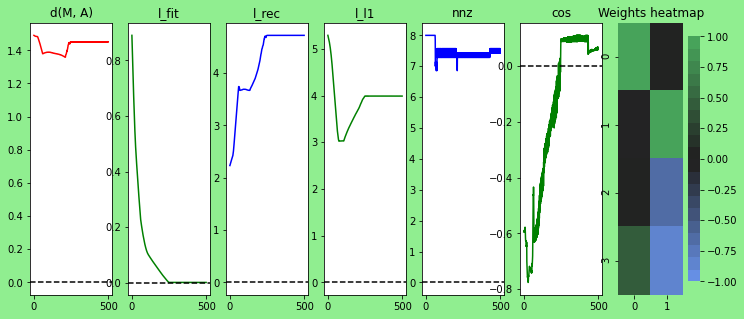

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


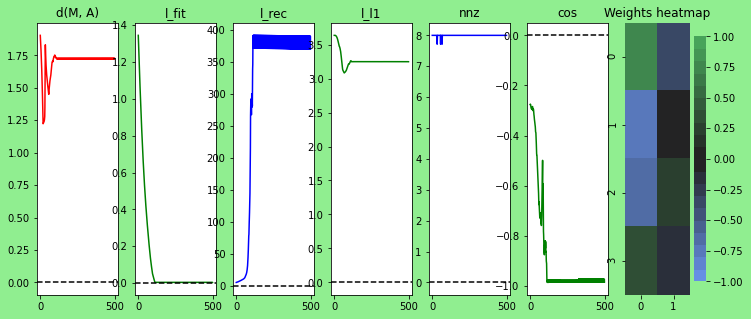

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


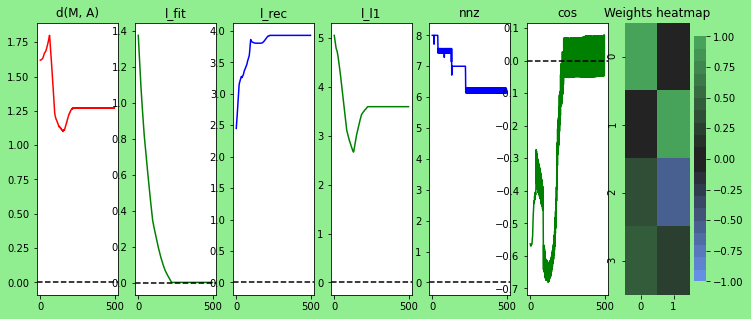

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


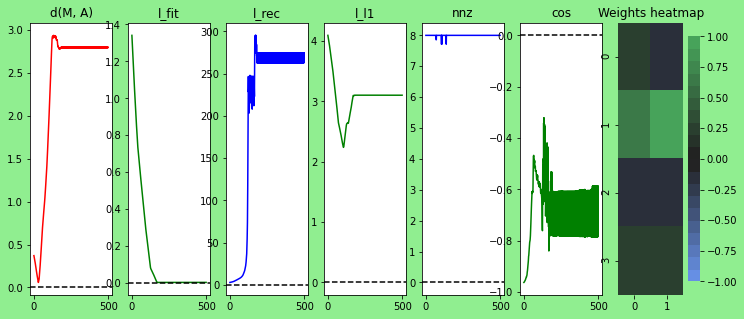

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


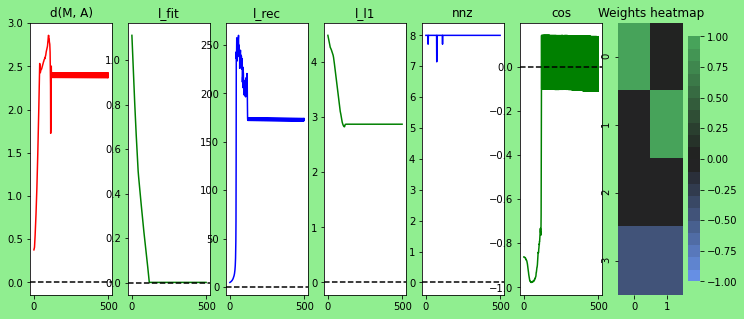

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


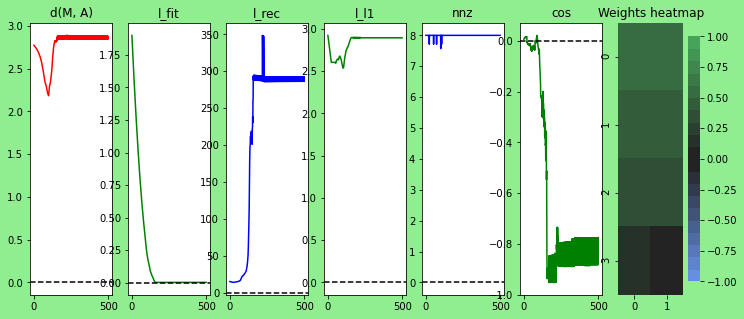

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


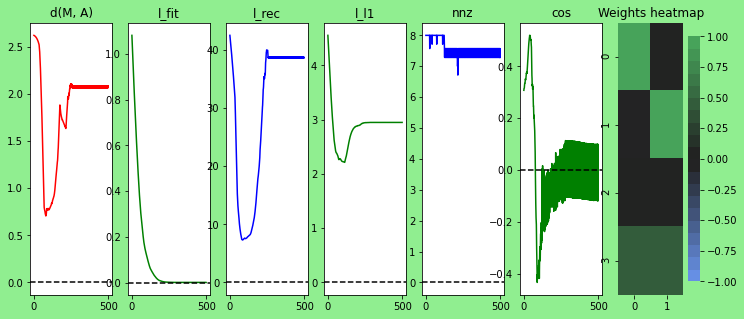

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


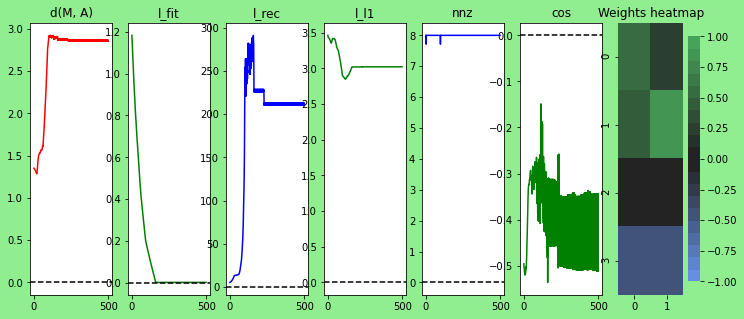

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


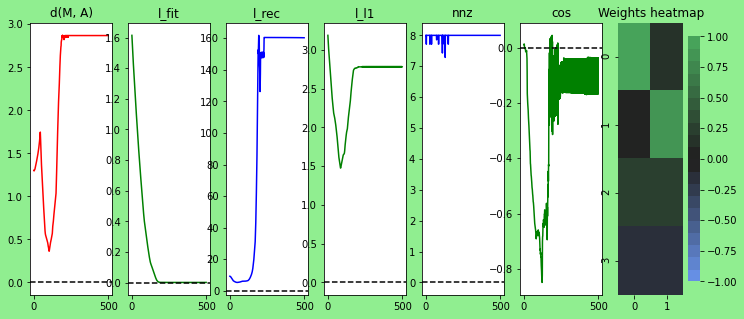

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


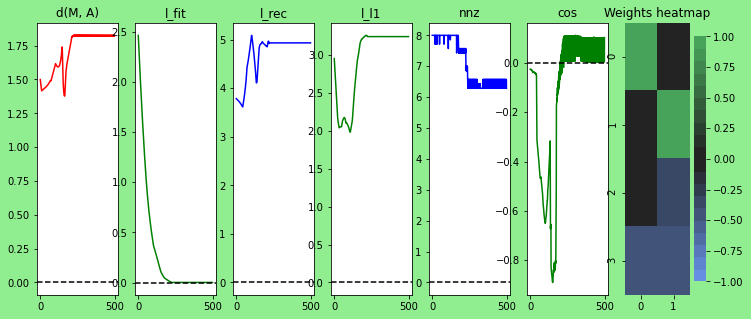

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


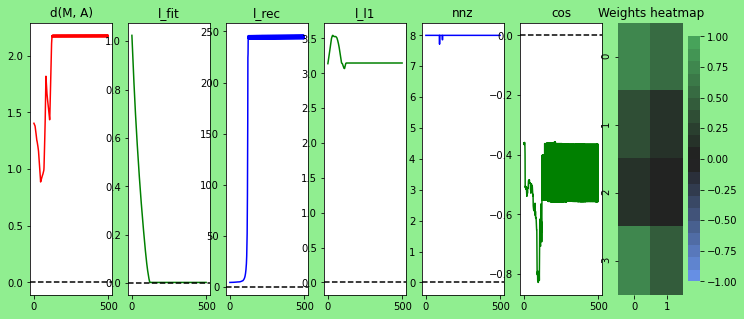

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


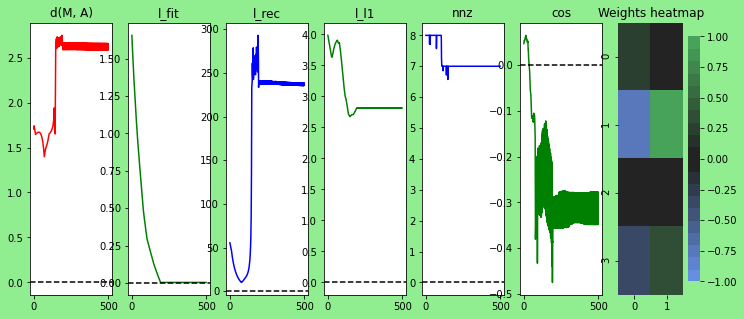

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


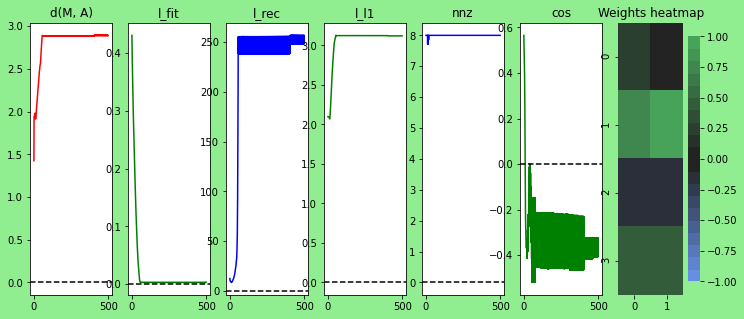

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


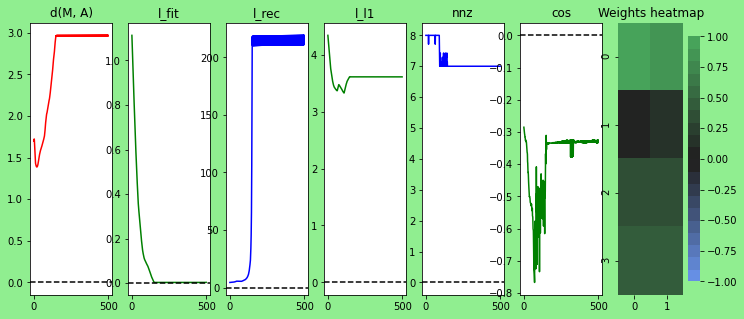

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


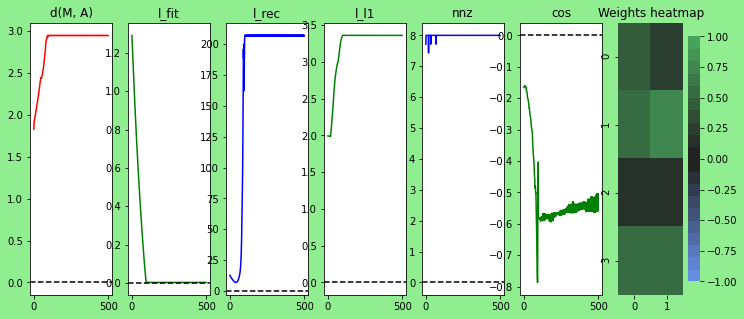

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


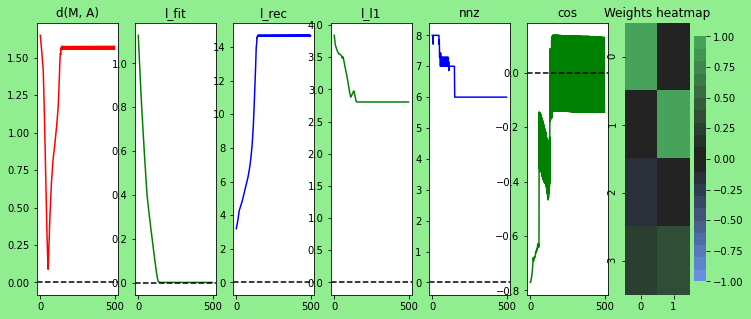

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


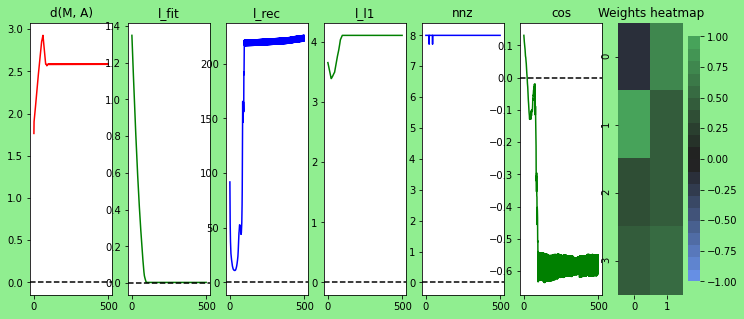

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


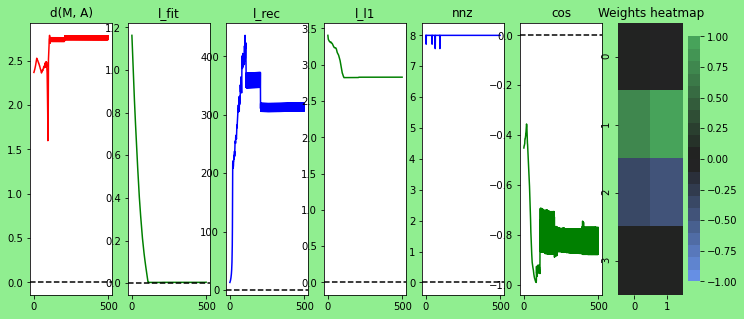

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


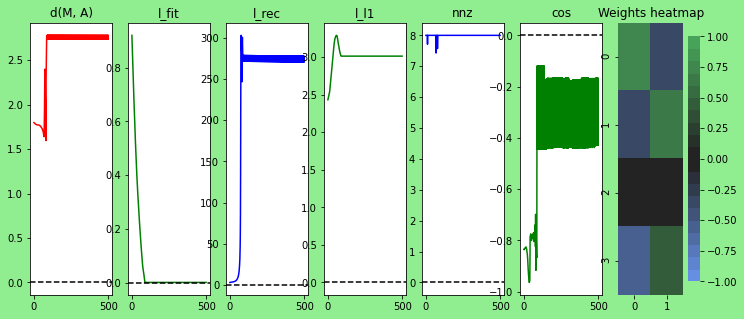

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


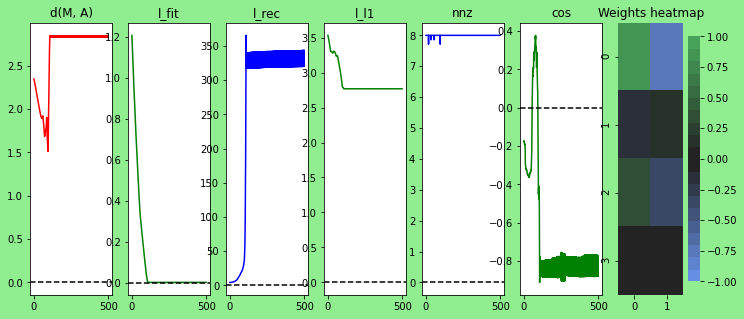

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


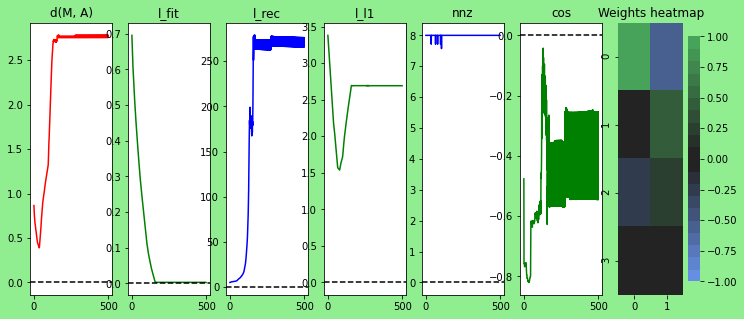

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


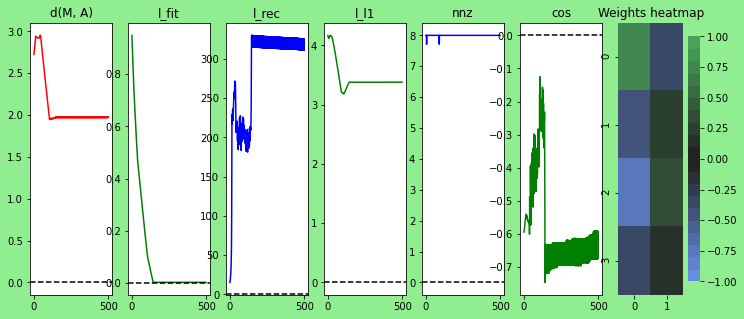

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


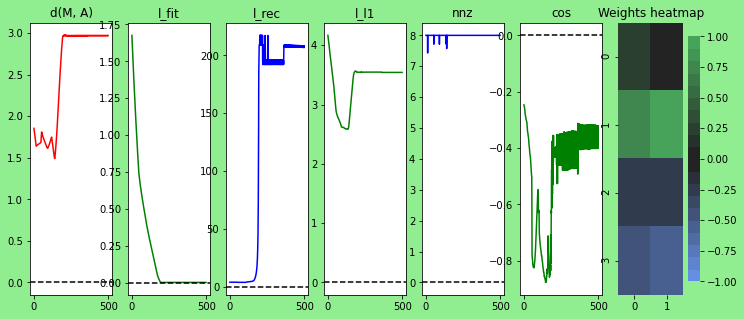

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


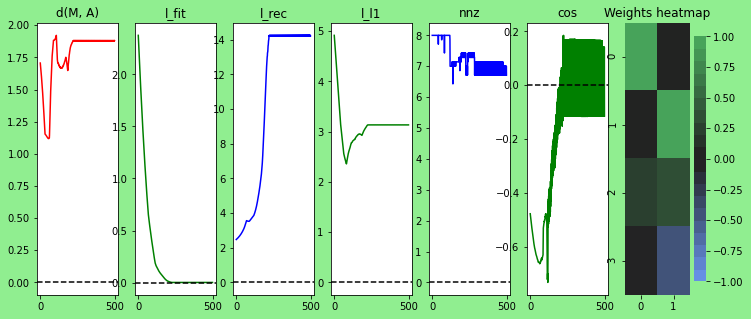

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


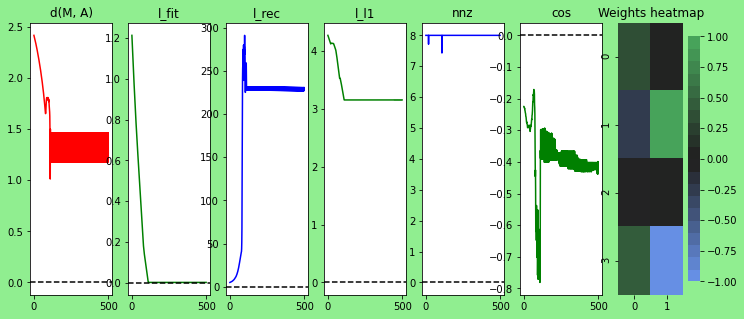

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


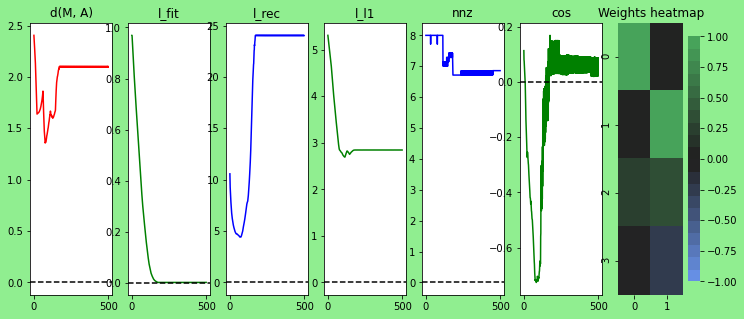

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


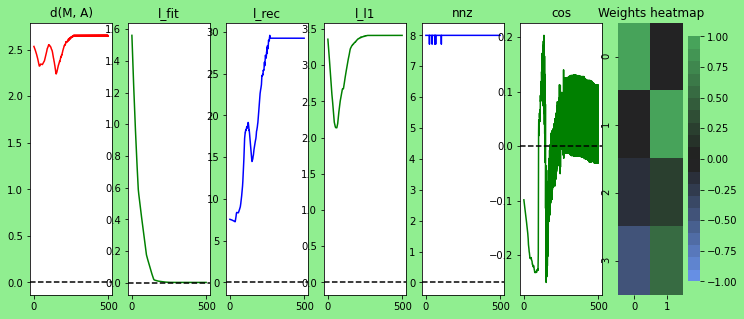

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


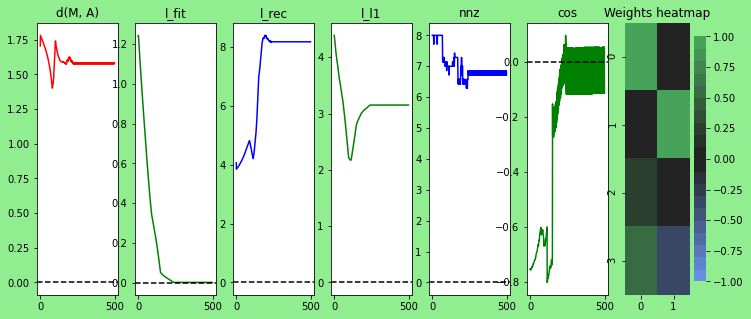

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


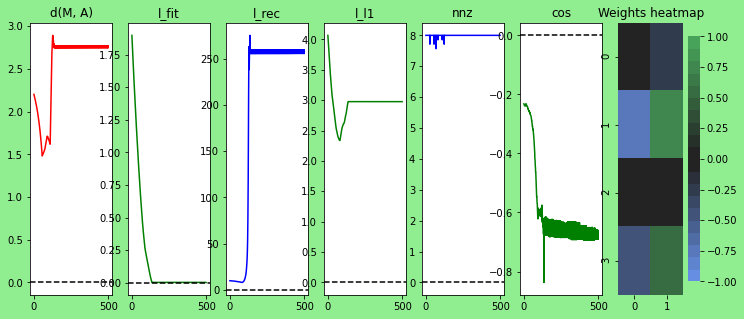

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


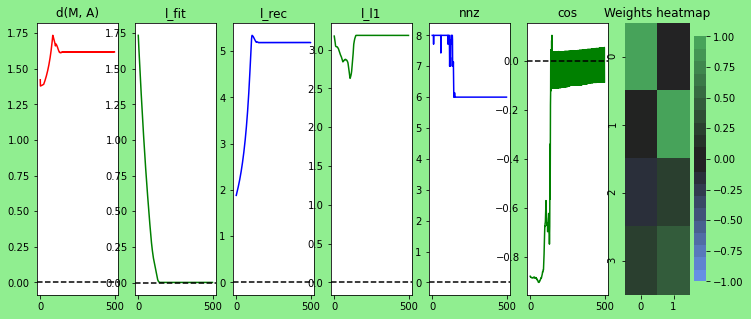

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


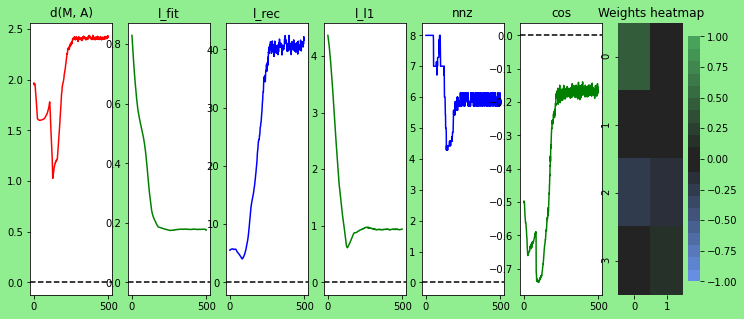

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


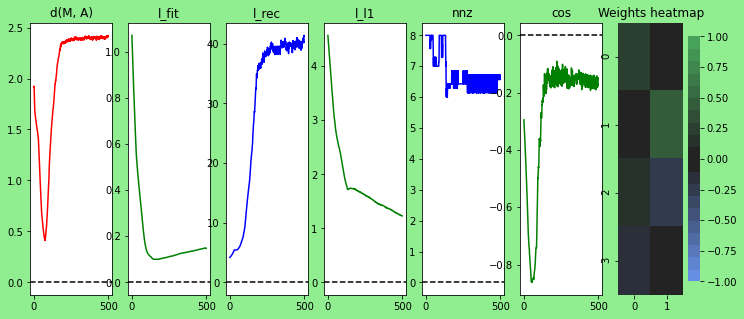

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


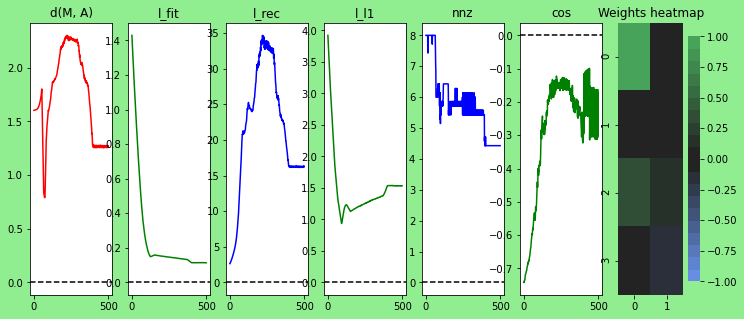

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


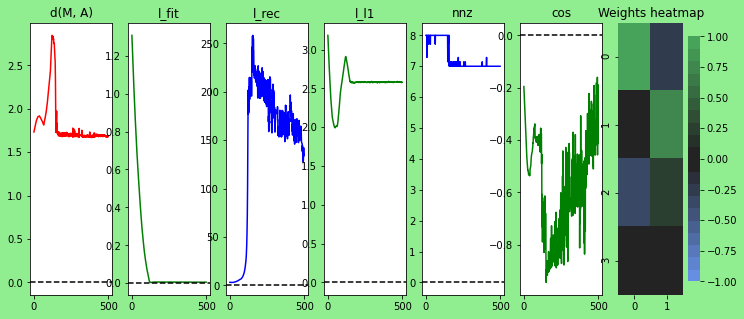

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


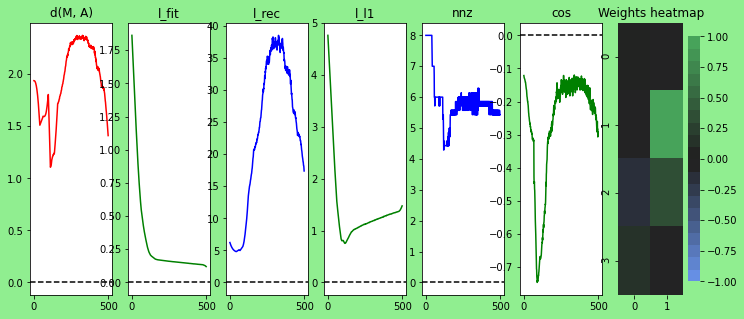

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


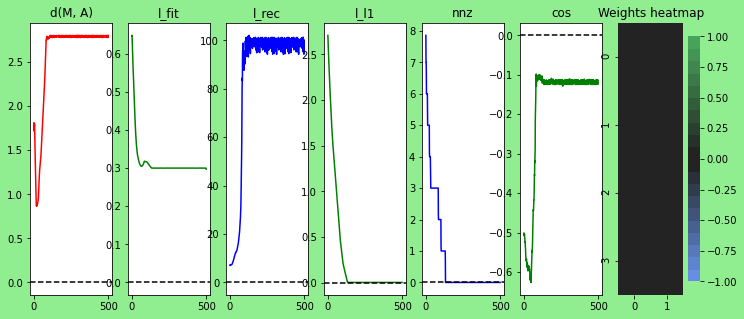

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


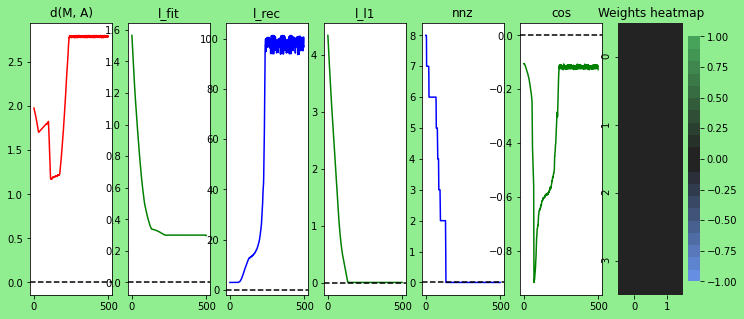

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


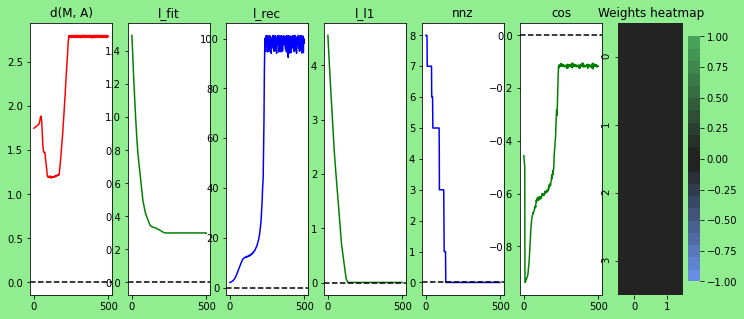

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


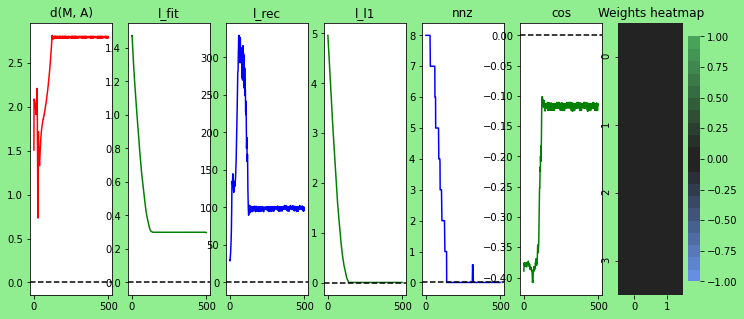

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


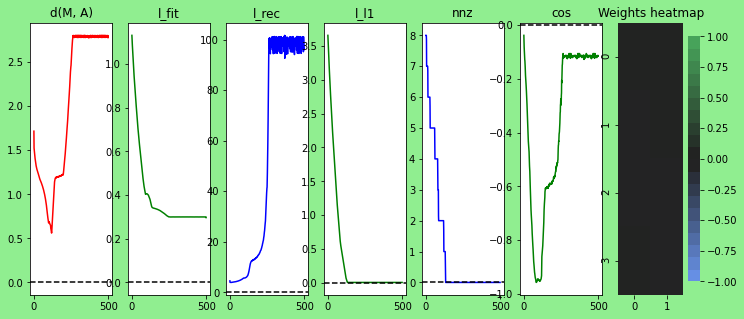

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


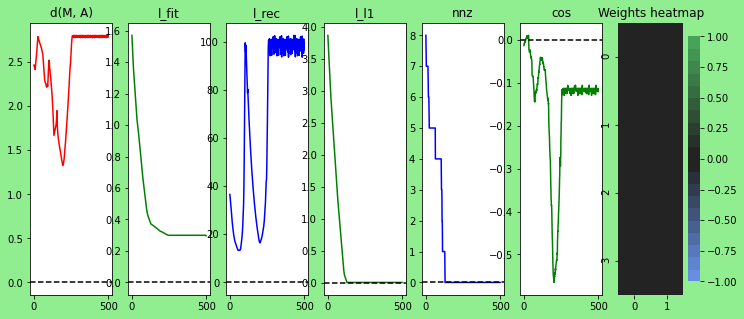

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


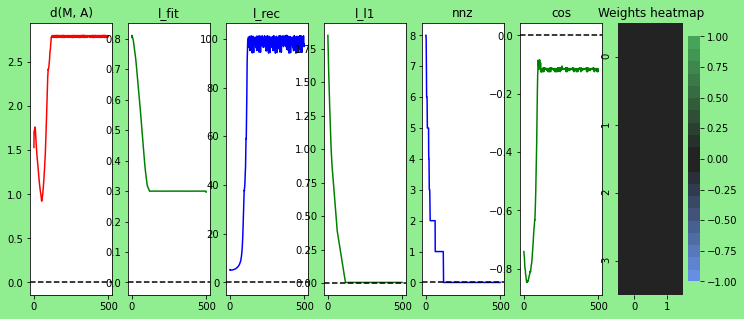

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


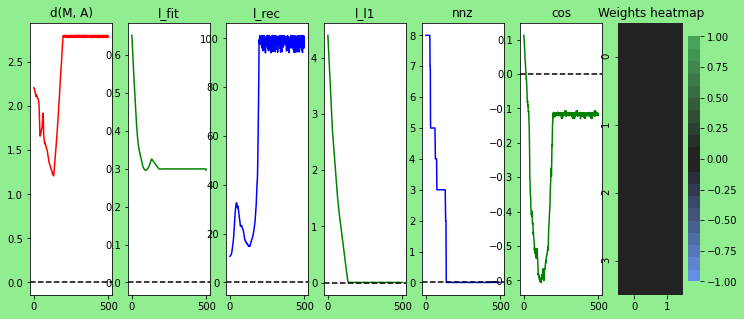

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


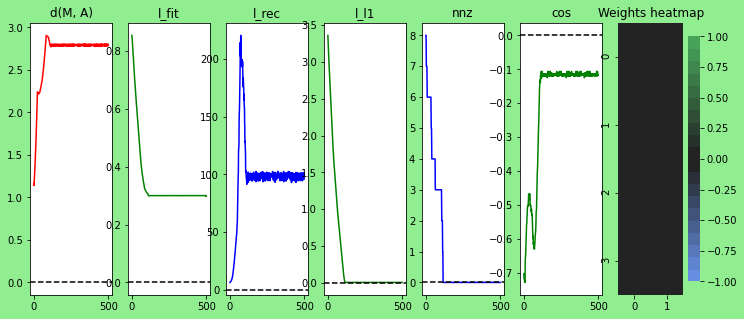

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


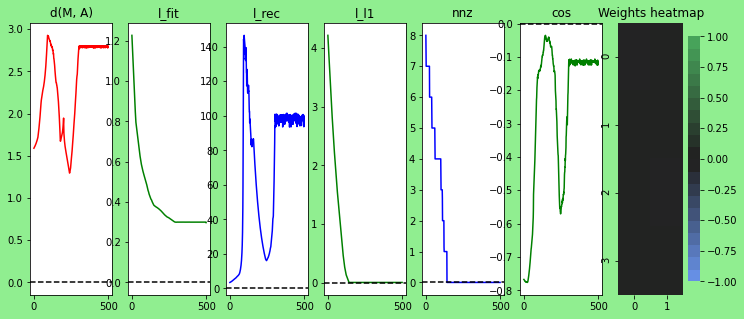

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


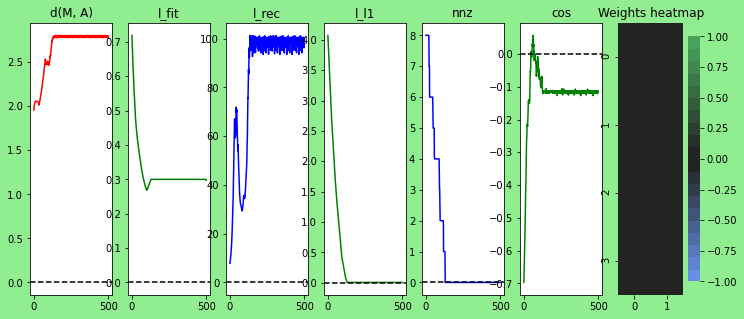

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


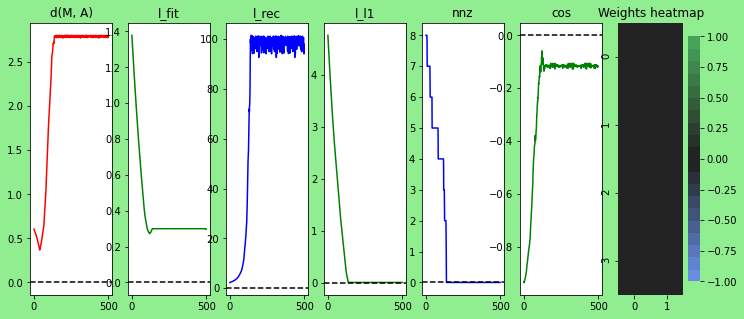

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


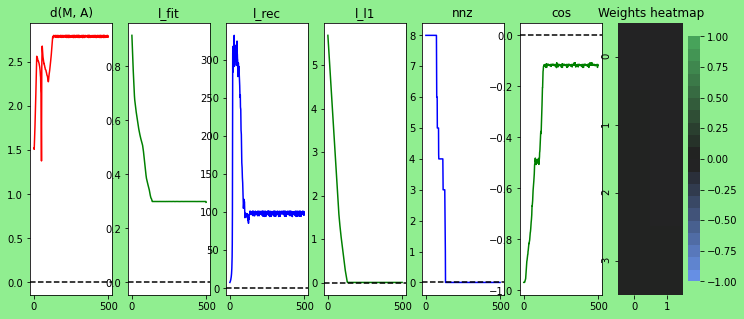

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


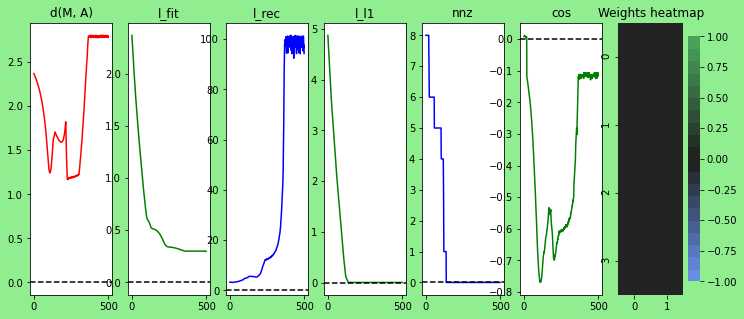

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


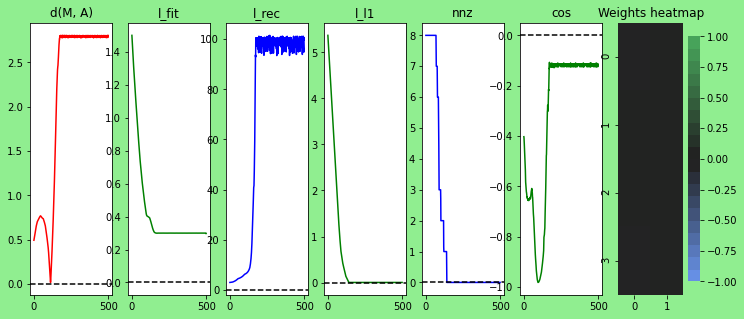

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


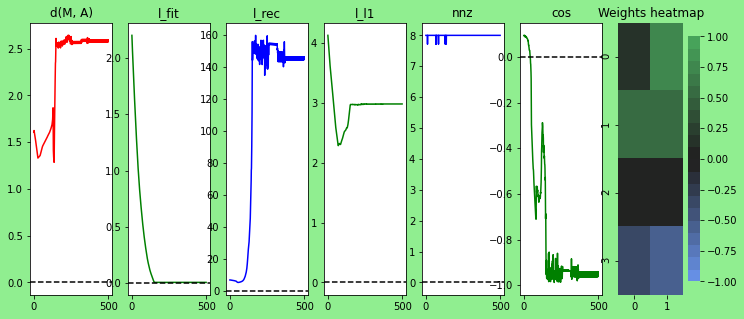

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


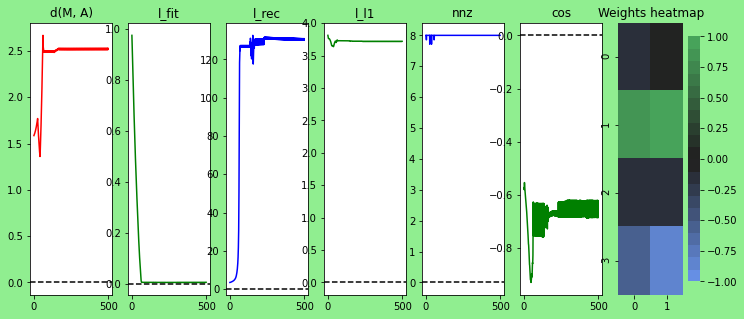

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


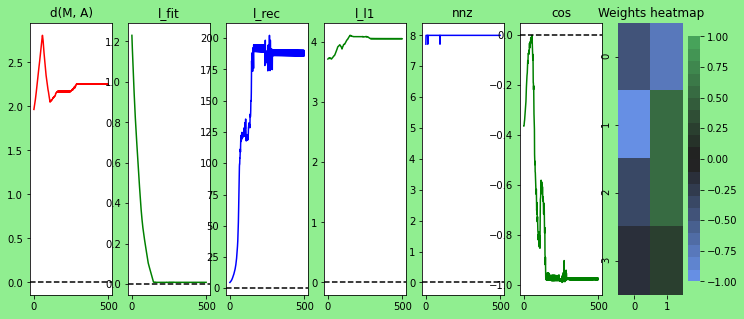

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


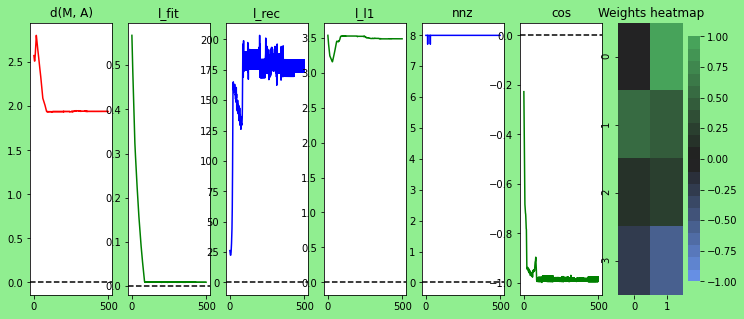

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


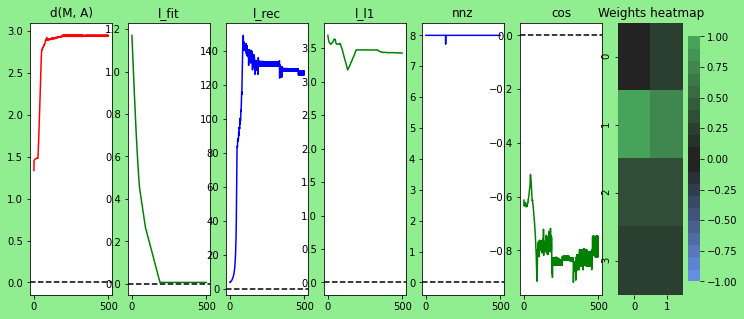

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


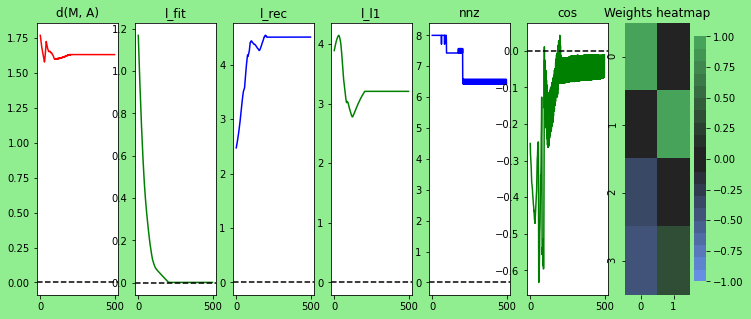

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


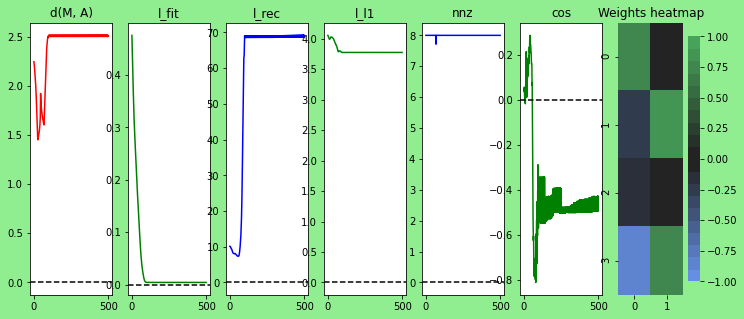

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


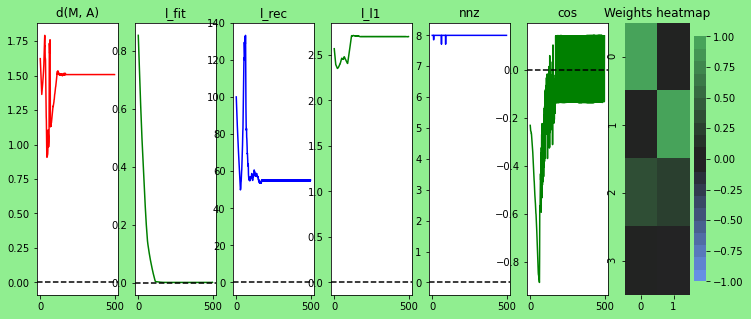

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


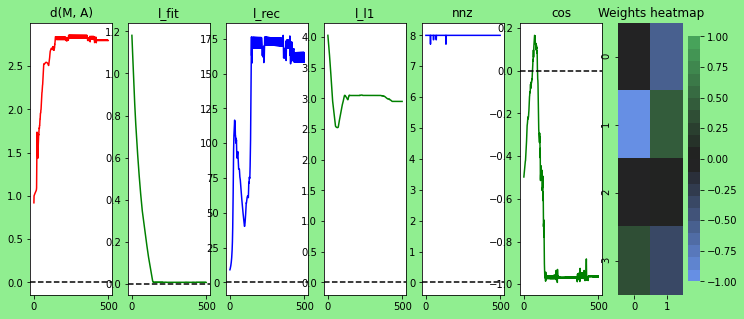

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


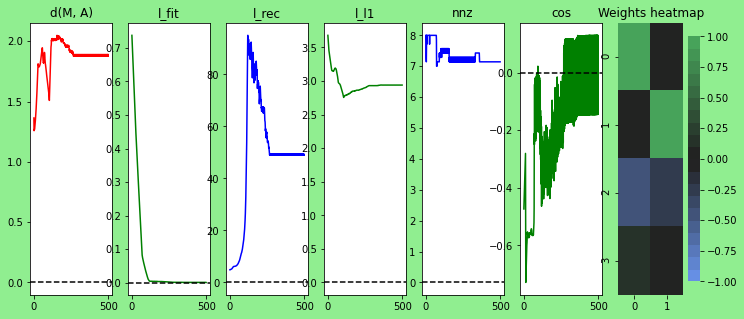

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


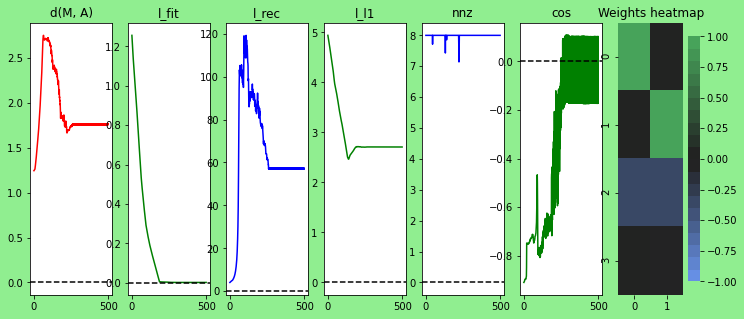

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


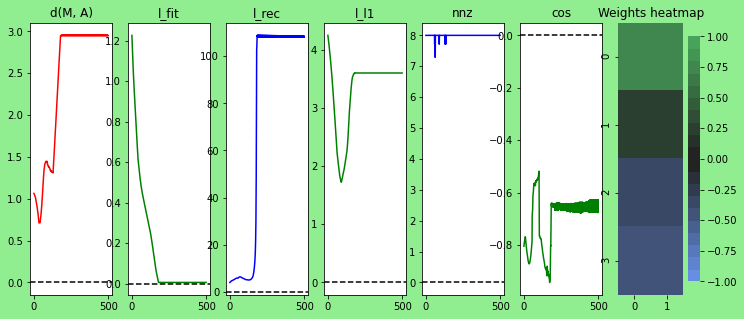

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


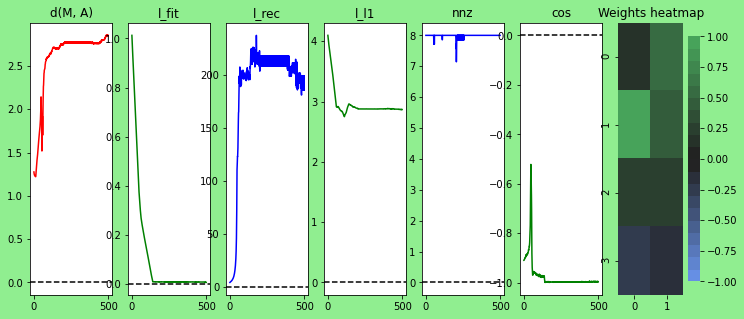

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


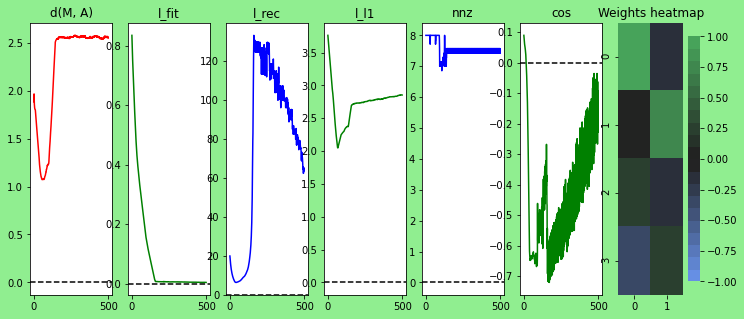

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


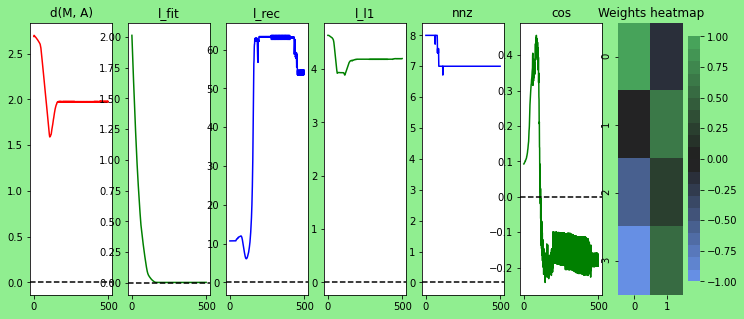

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


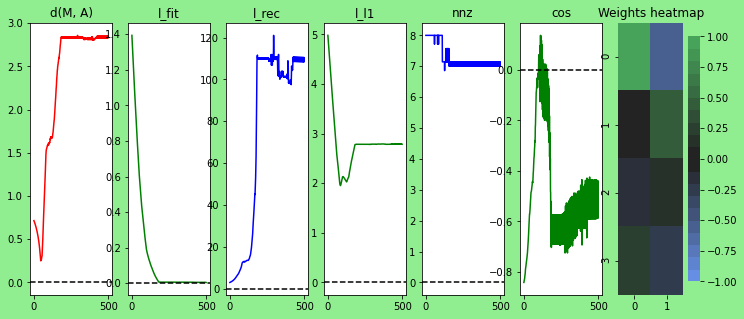

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


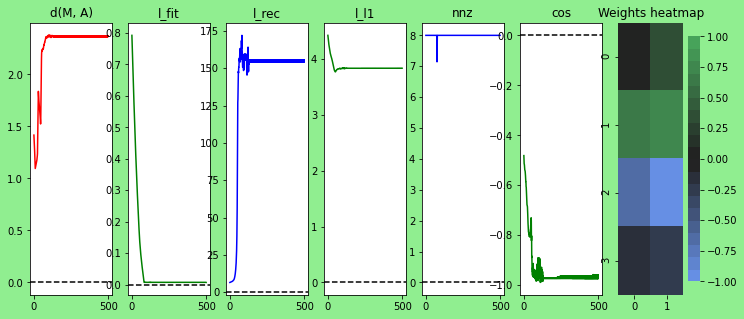

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


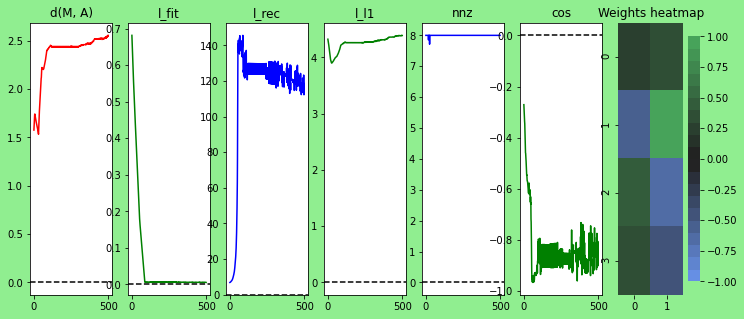

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


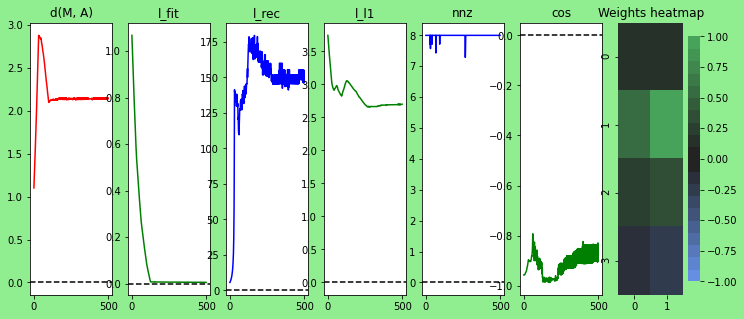

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


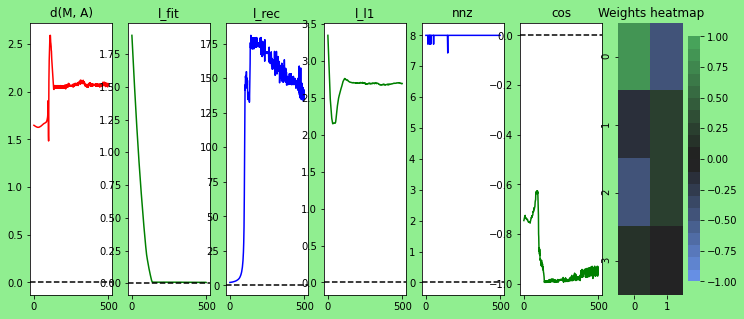

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


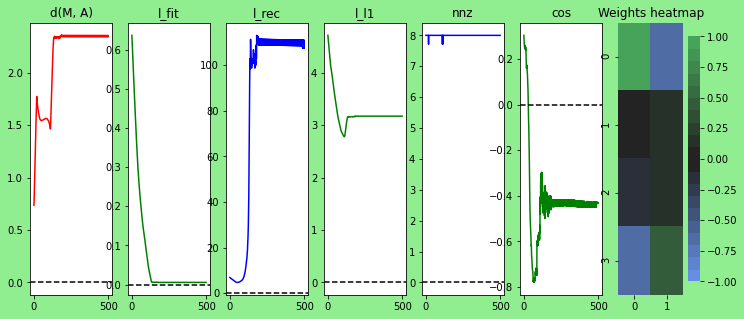

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


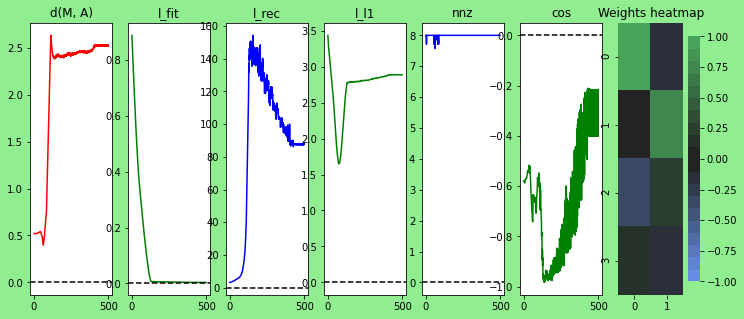

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


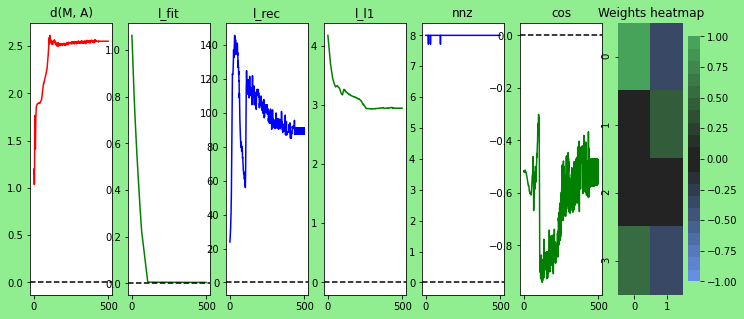

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


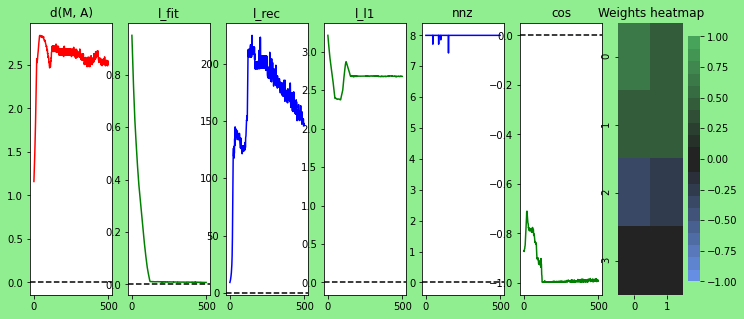

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


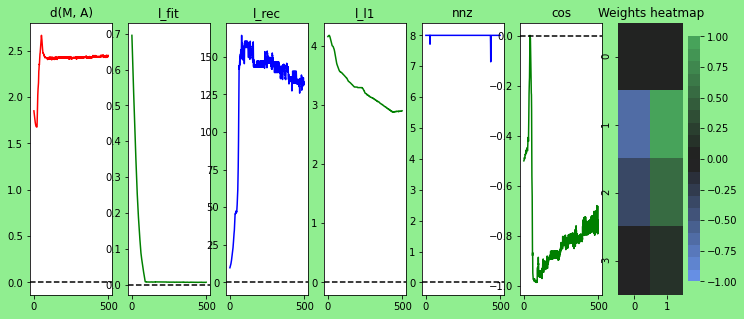

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


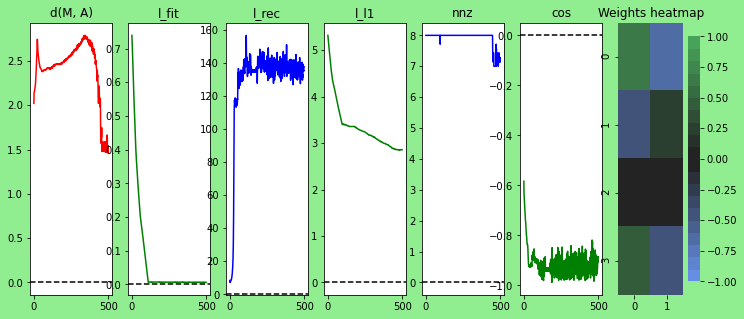

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


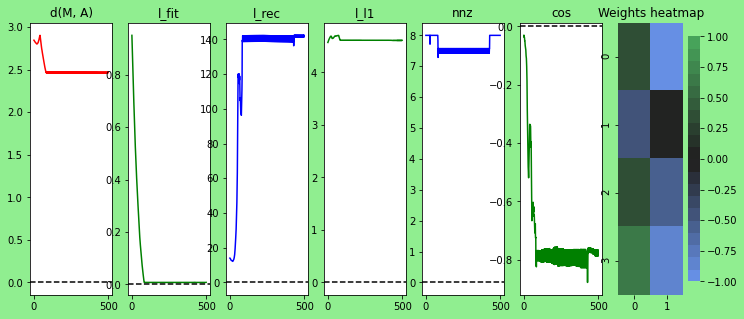

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


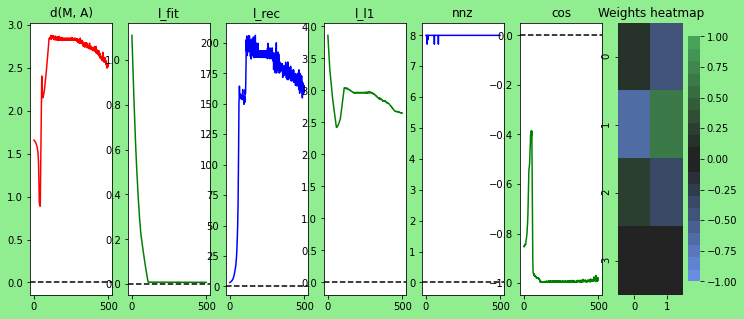

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


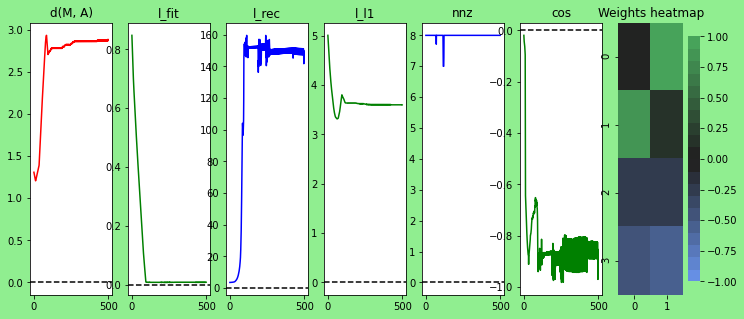

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


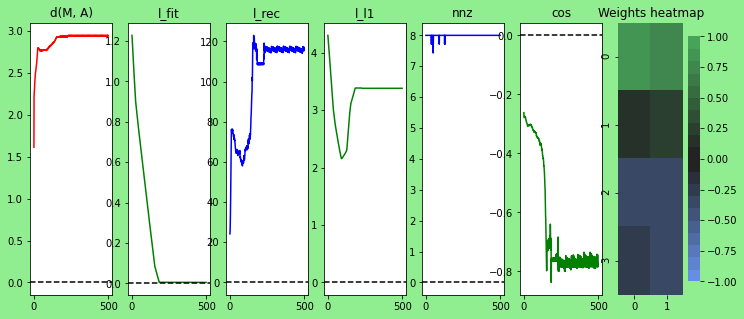

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


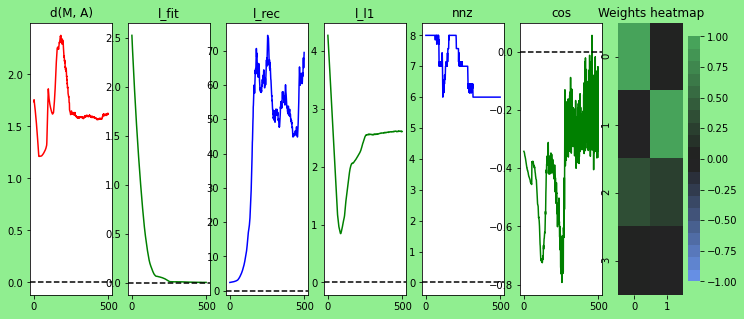

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


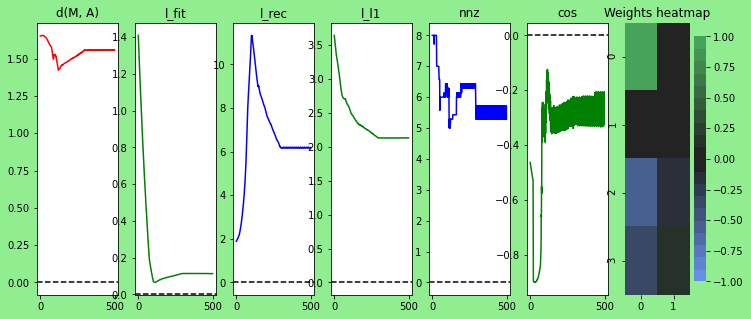

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


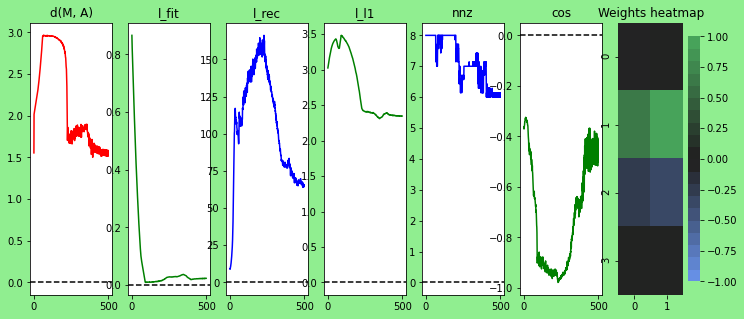

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


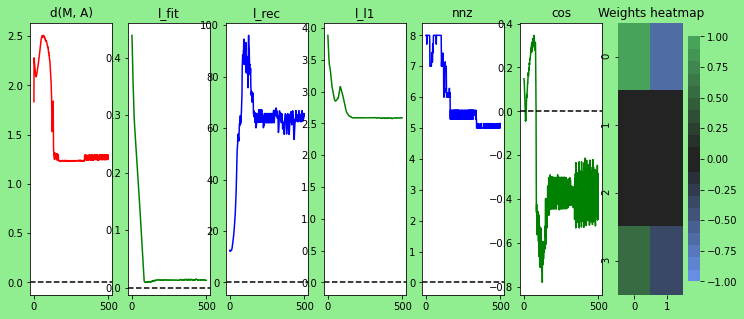

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


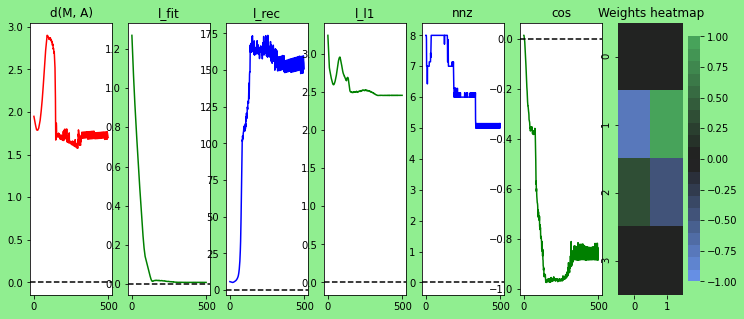

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


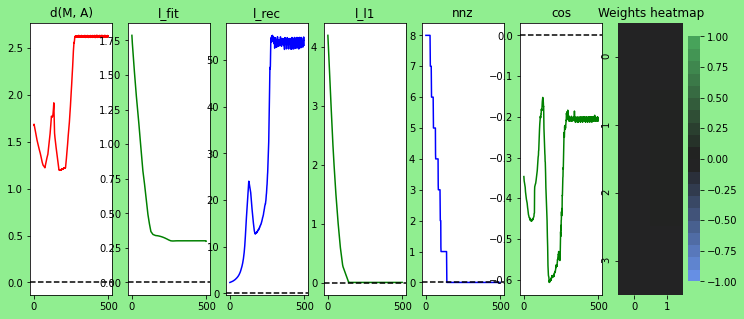

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


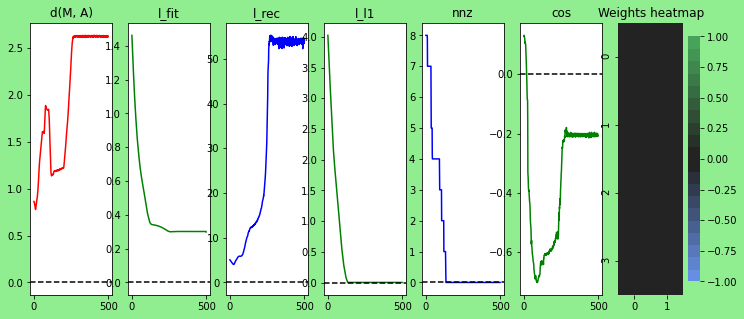

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


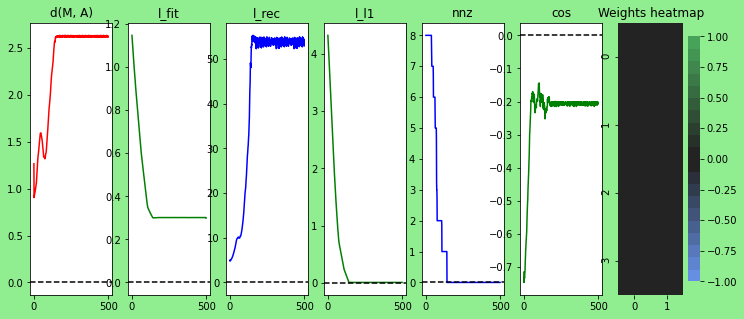

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


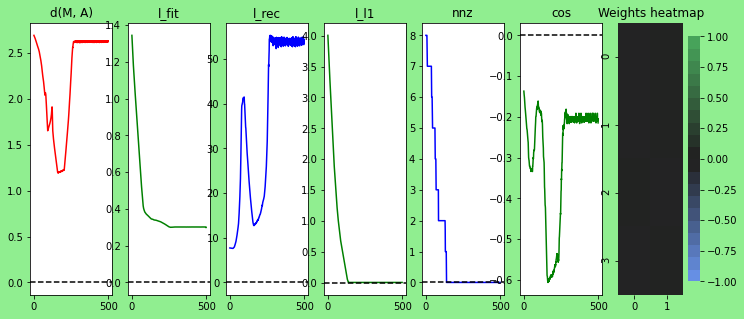

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


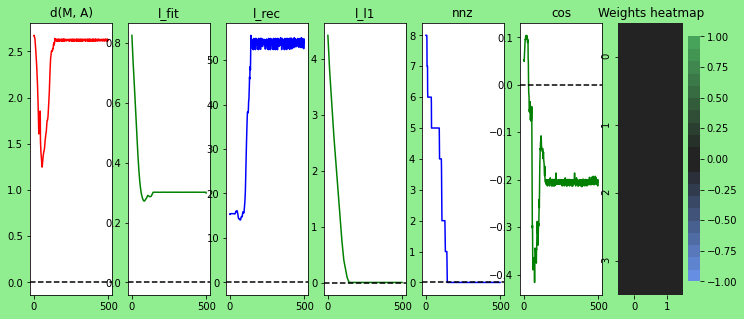

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


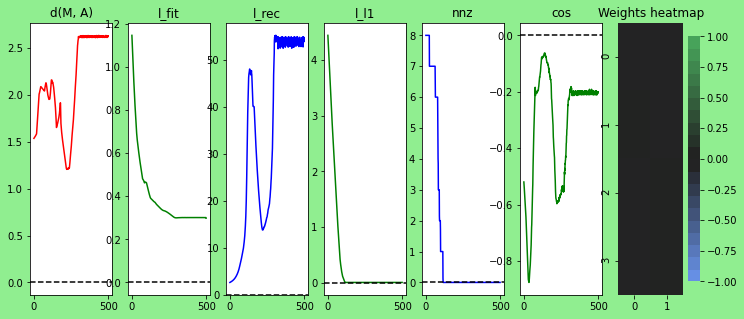

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


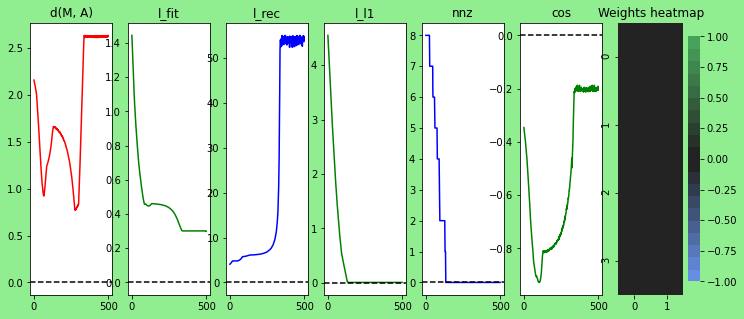

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


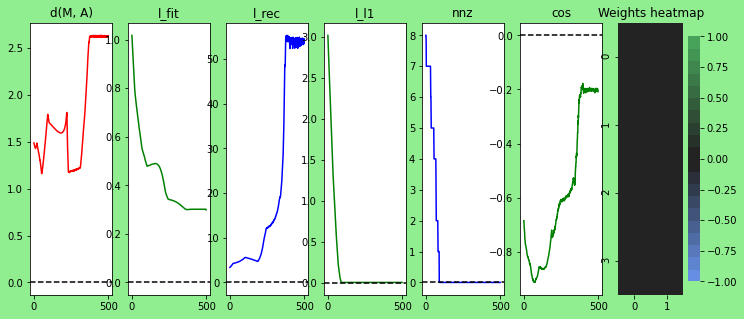

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


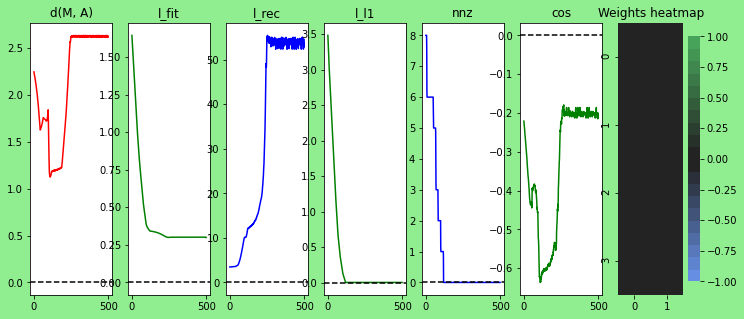

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


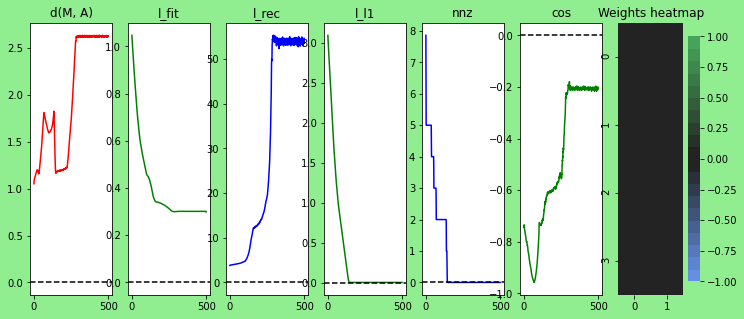

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


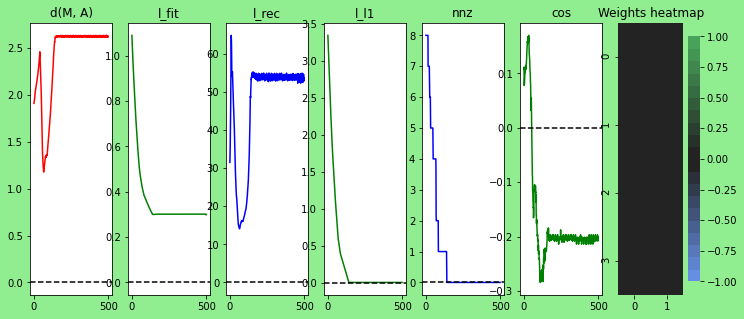

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


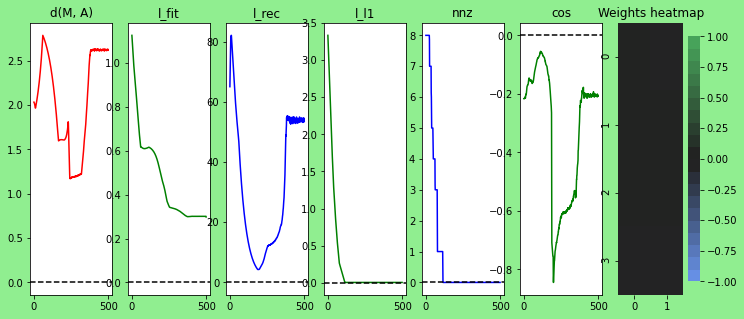

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


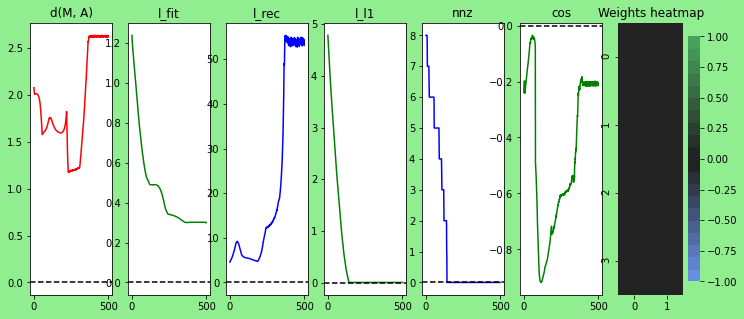

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


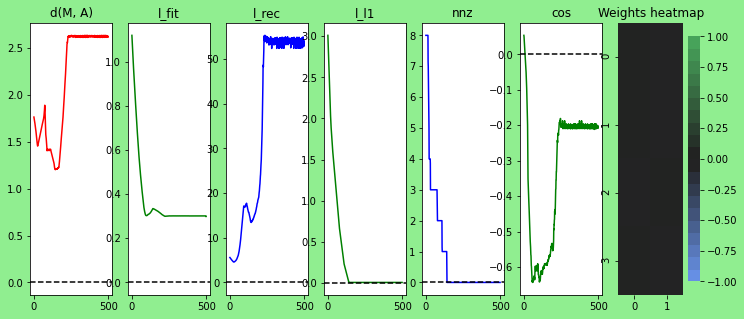

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 4.641588833612782e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


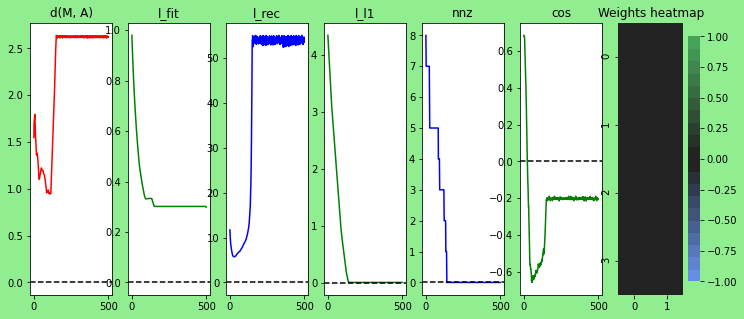

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


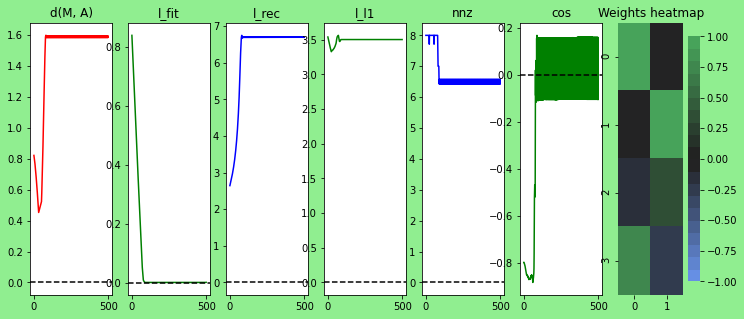

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


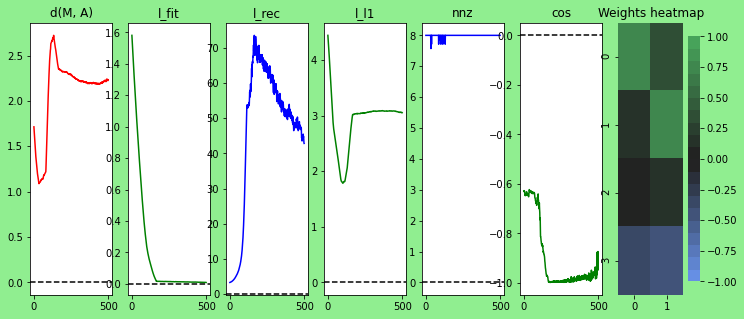

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


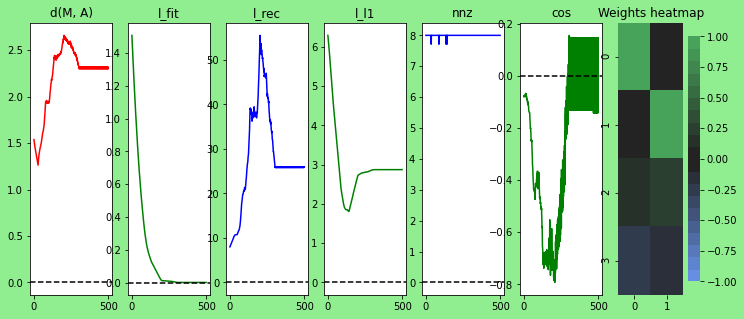

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


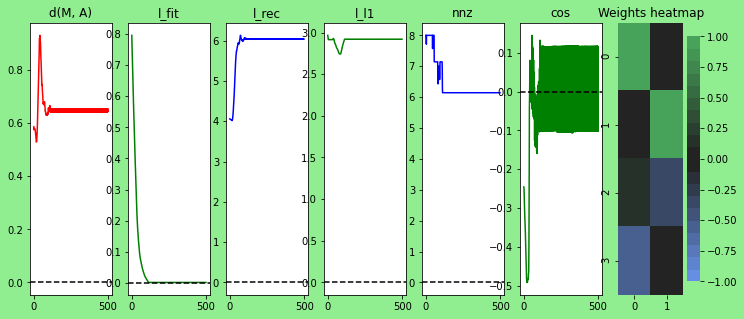

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


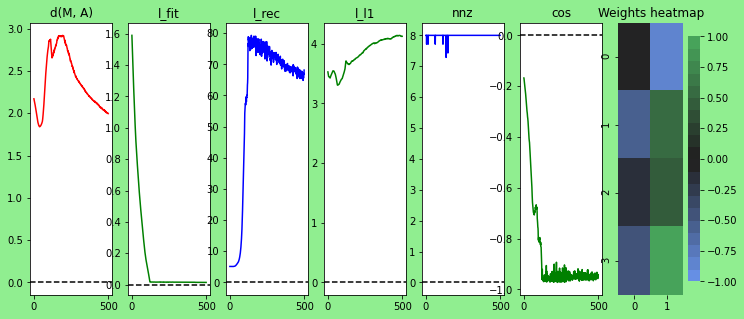

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


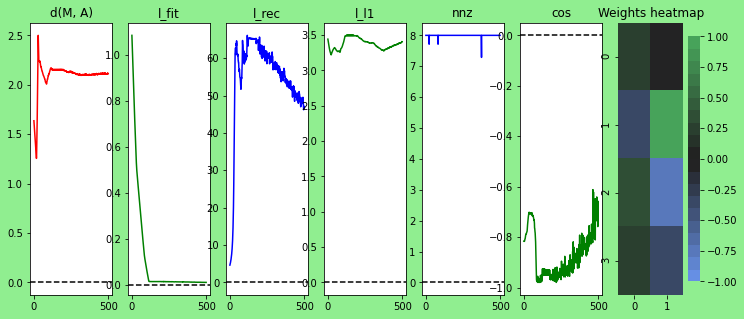

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


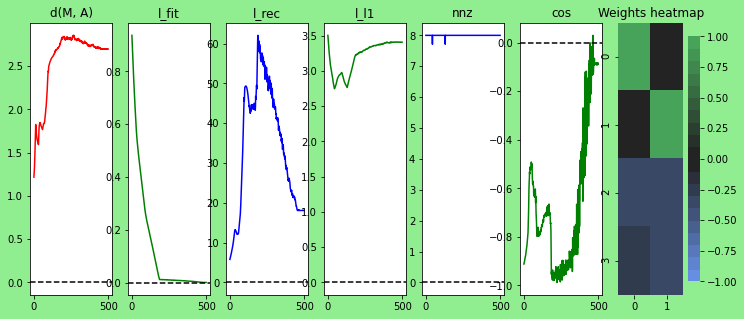

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


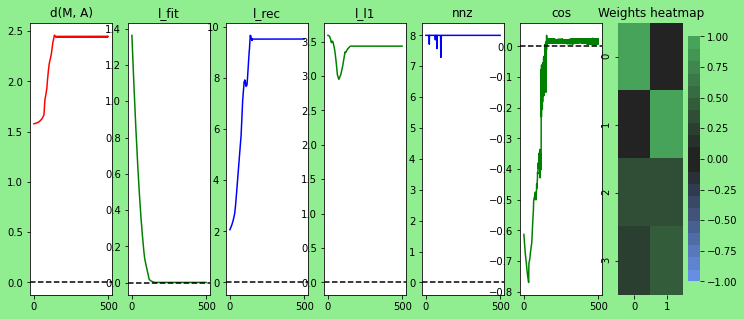

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


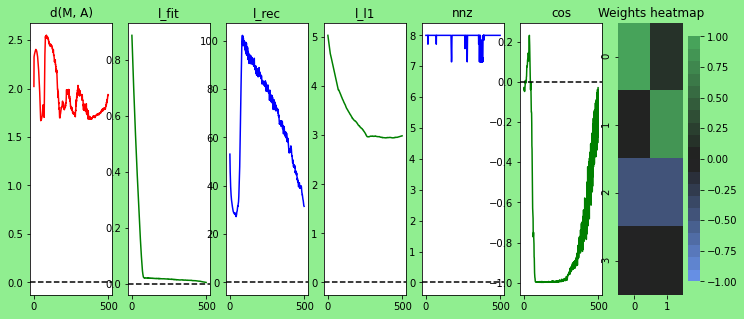

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


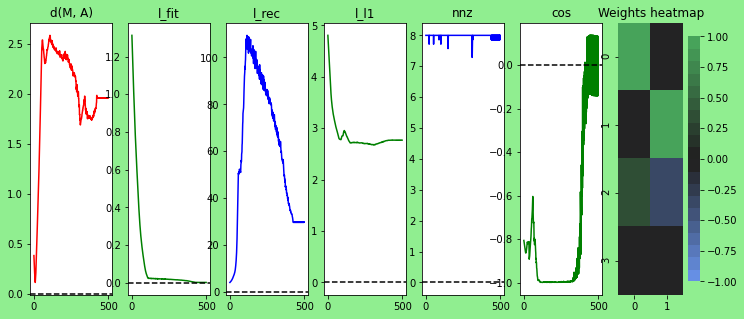

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


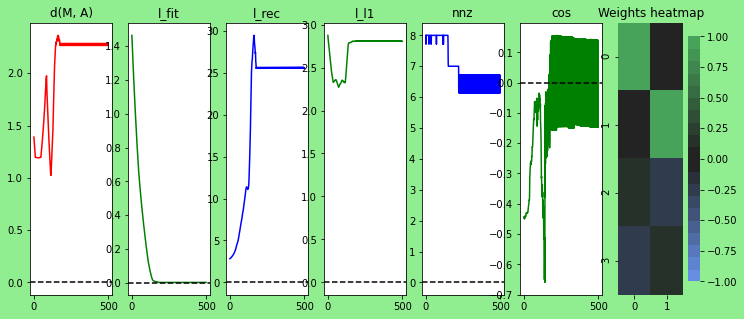

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


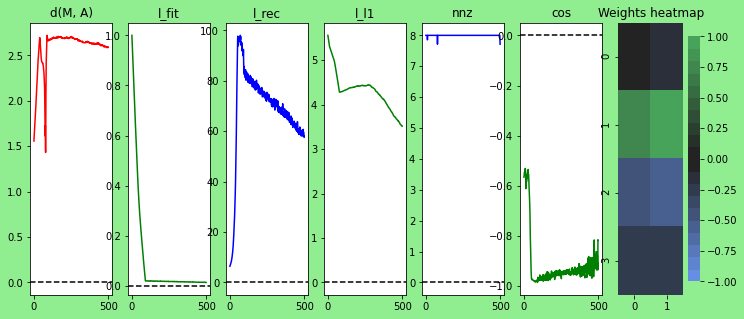

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


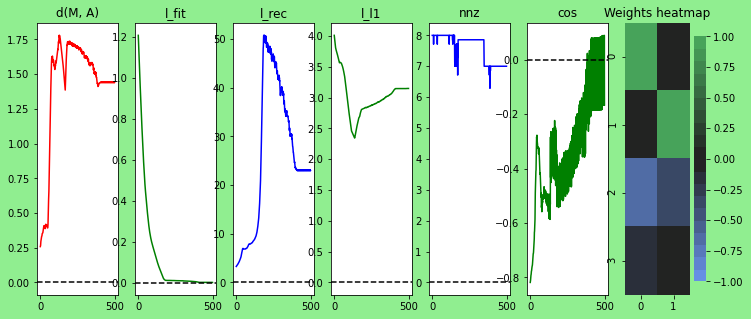

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


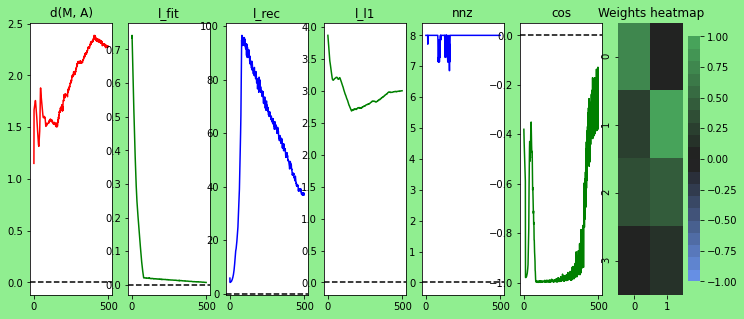

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


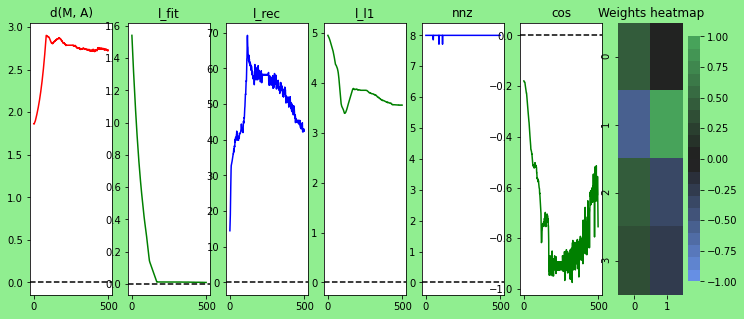

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


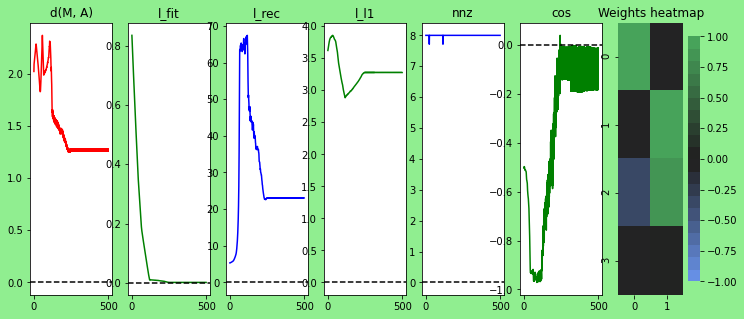

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


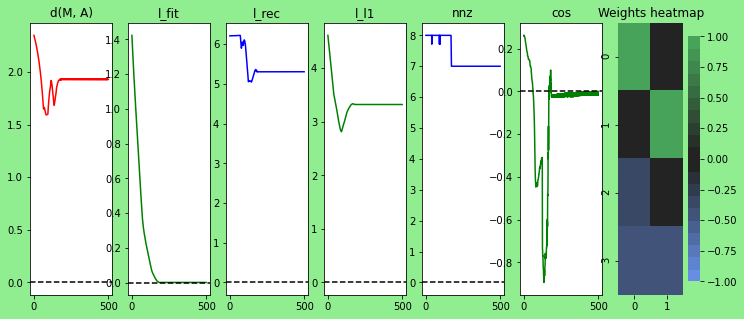

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


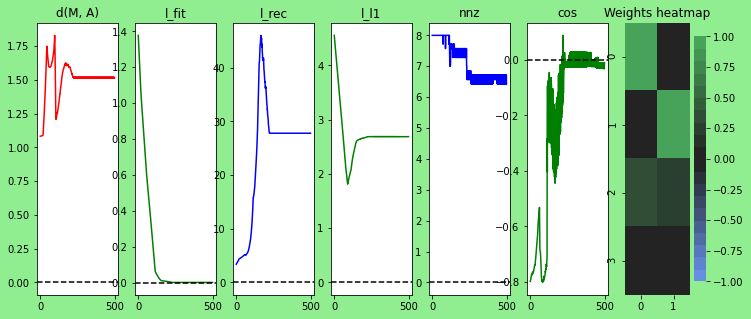

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


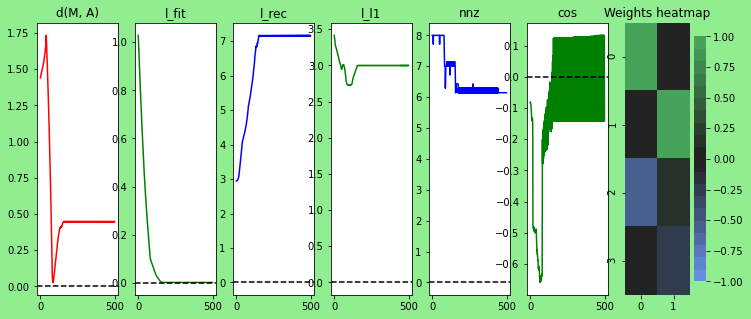

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


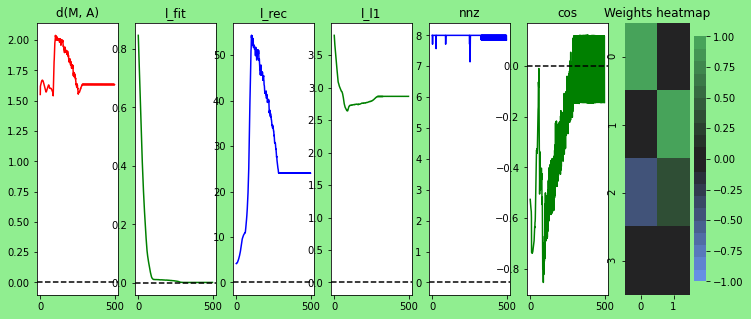

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


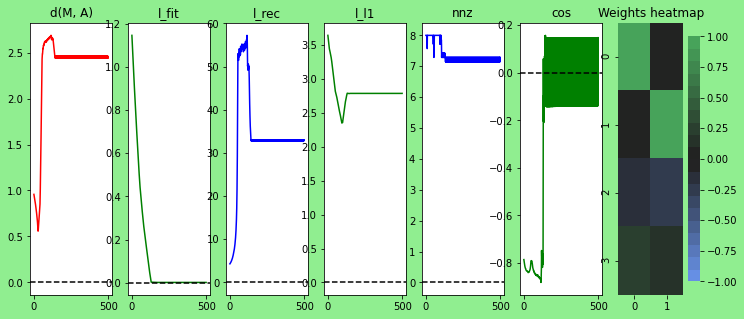

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


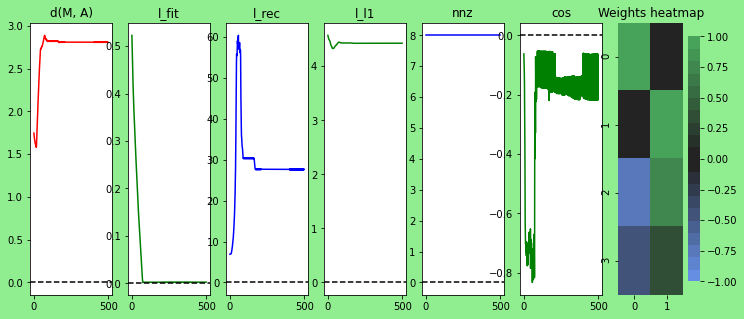

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


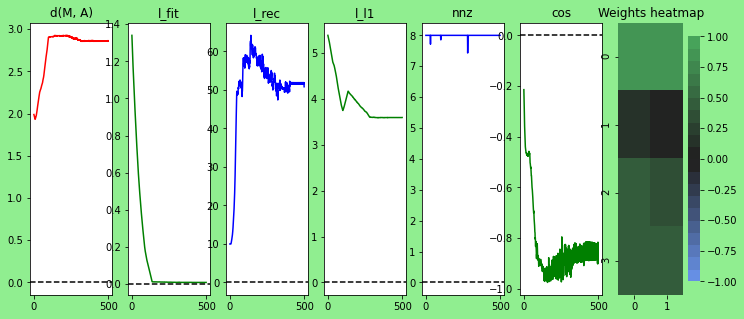

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


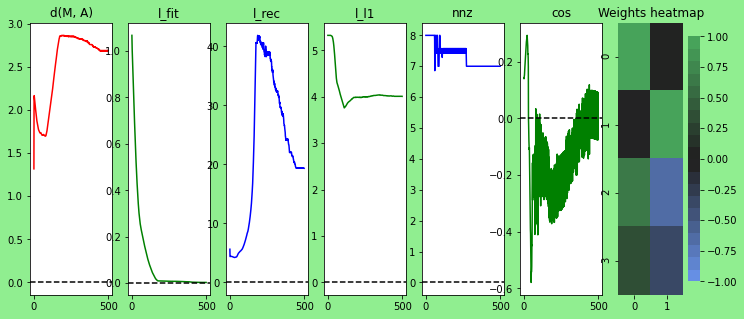

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


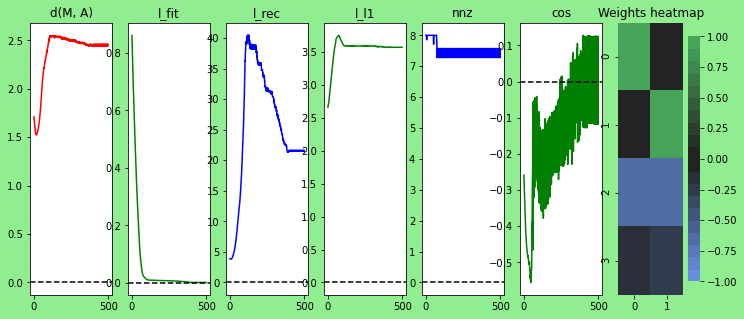

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


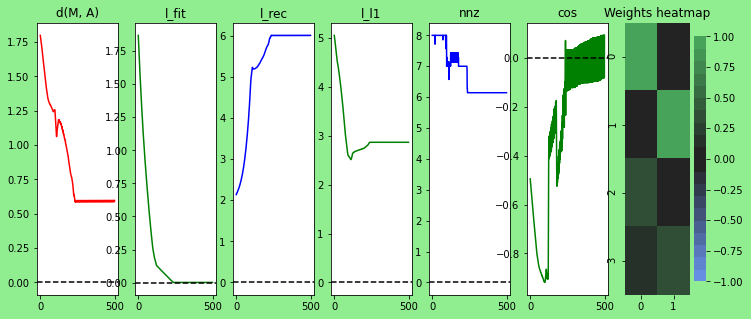

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


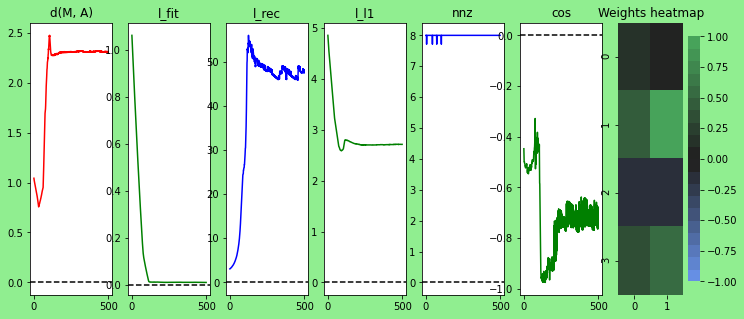

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


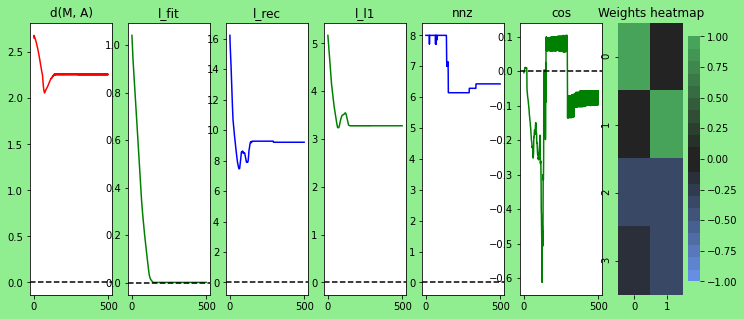

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


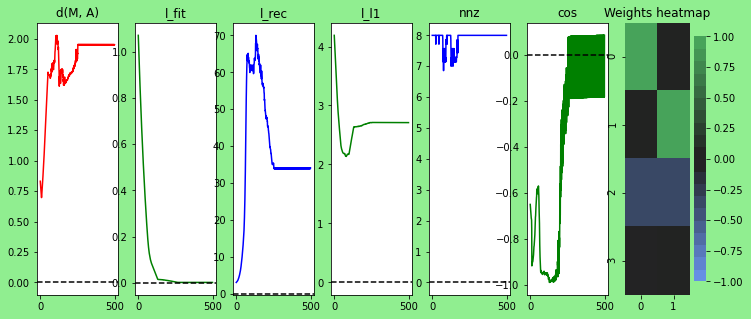

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


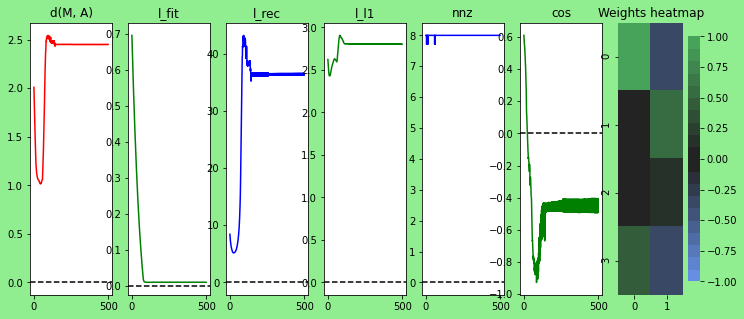

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


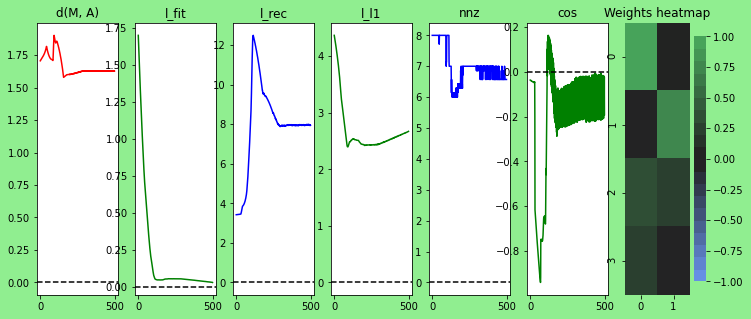

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


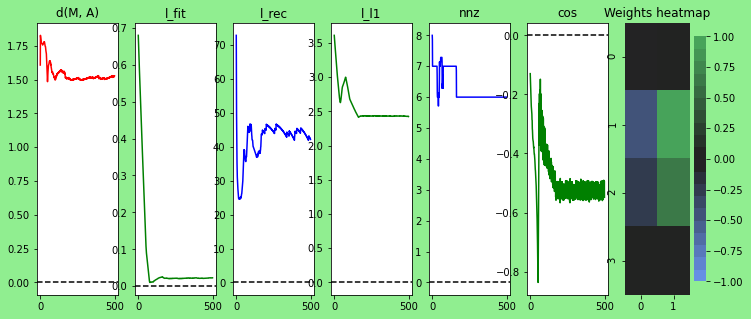

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


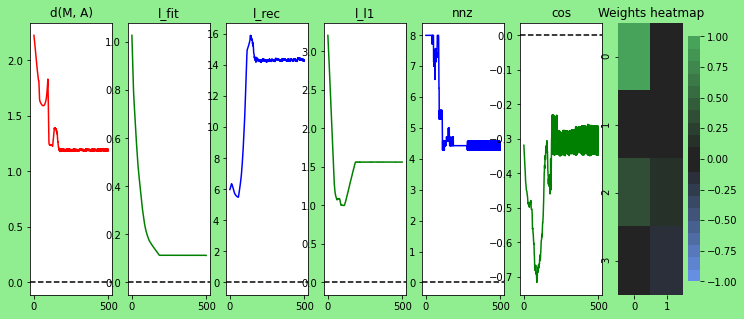

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


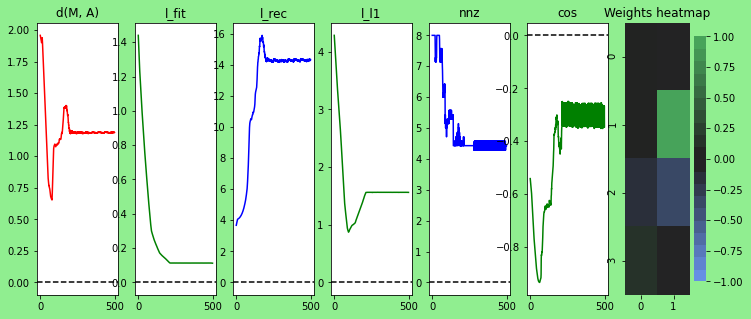

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


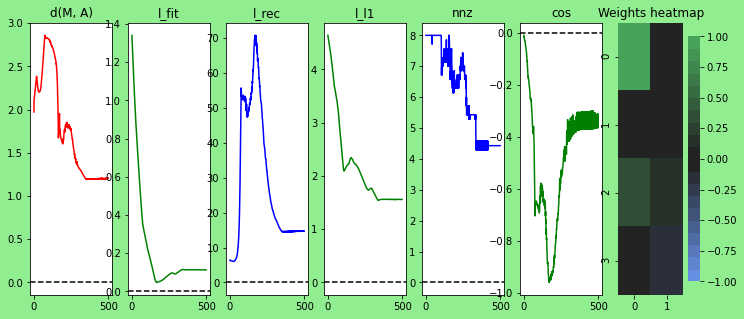

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


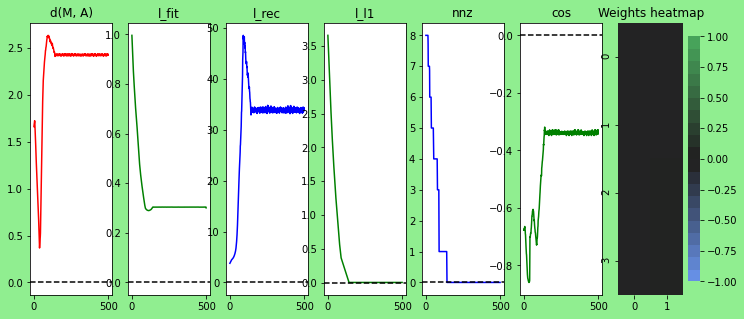

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


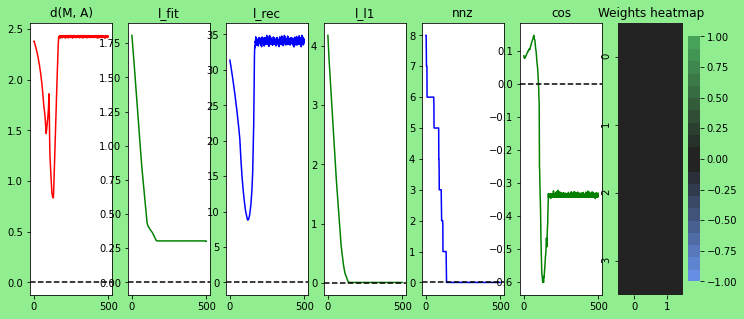

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


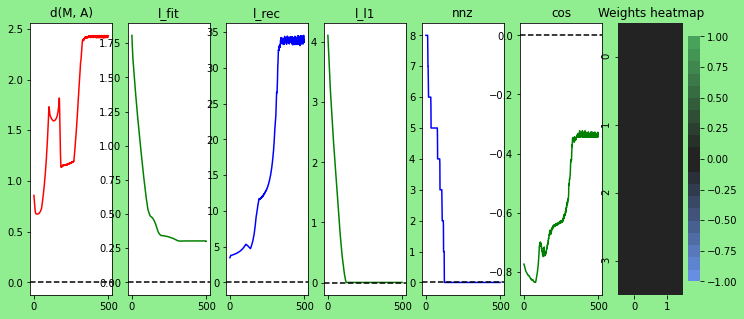

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


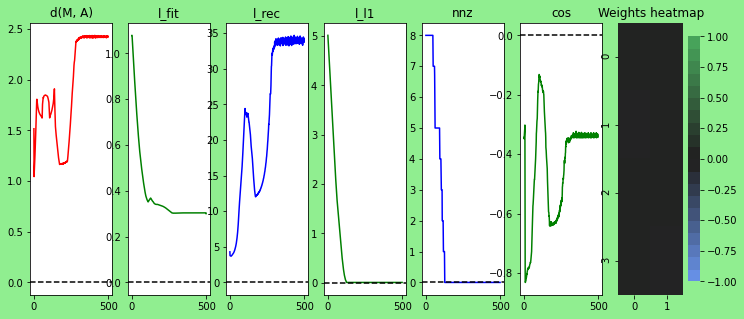

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


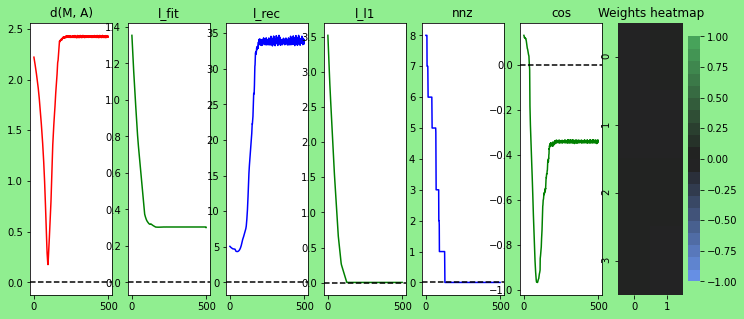

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


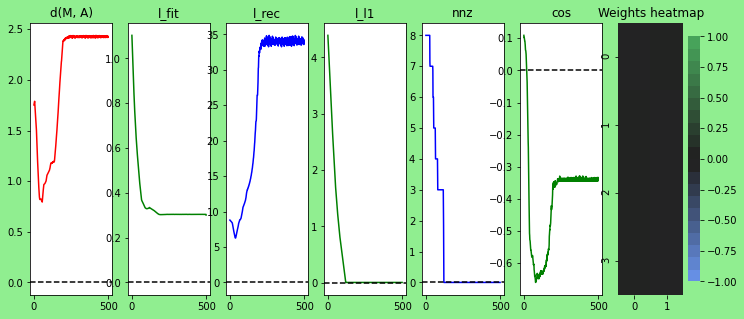

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


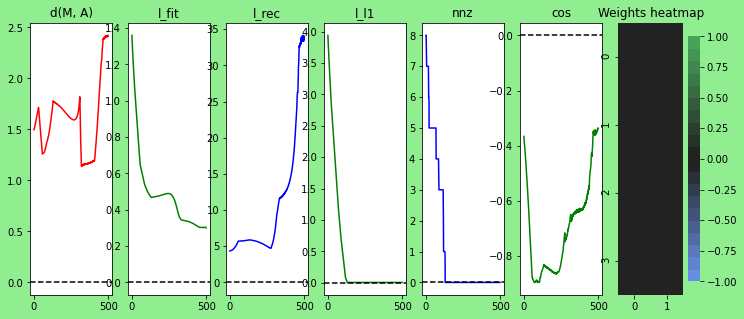

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


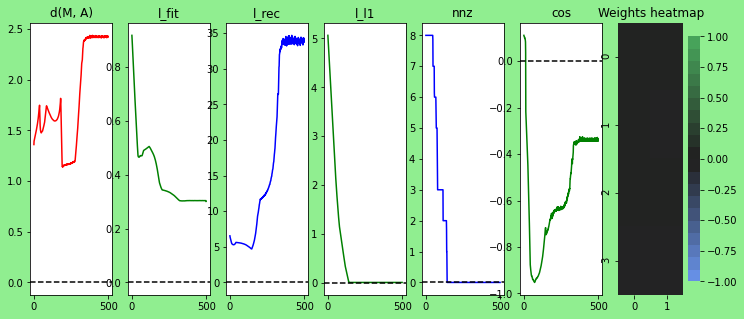

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


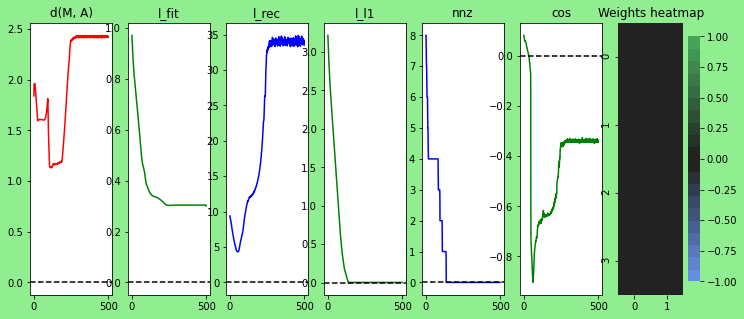

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


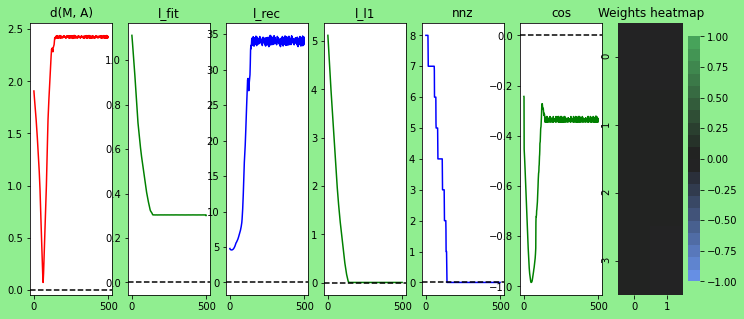

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


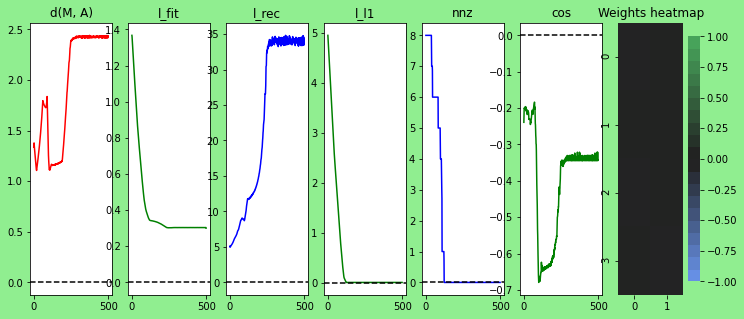

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


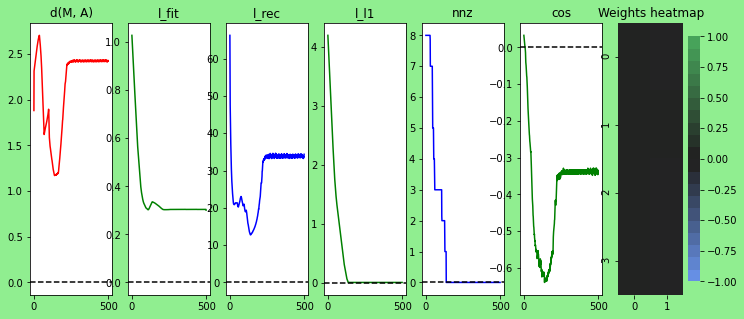

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


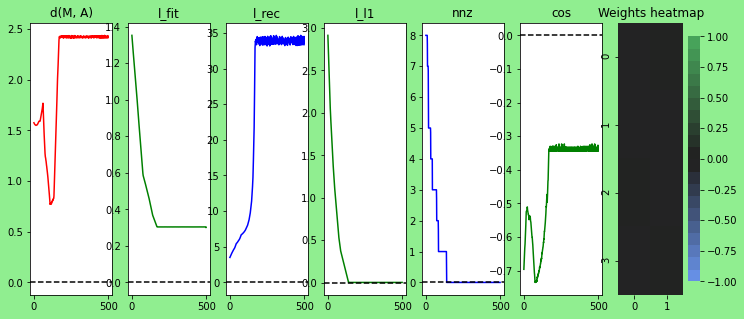

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


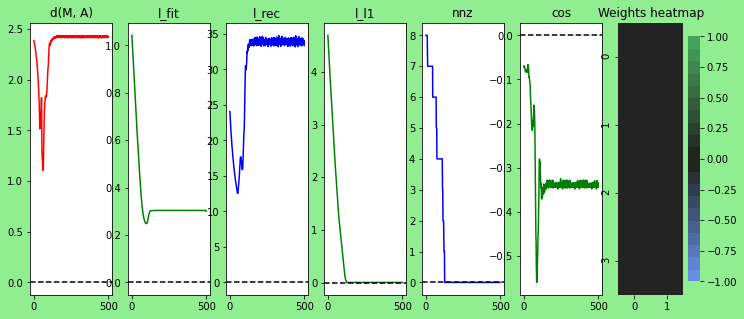

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


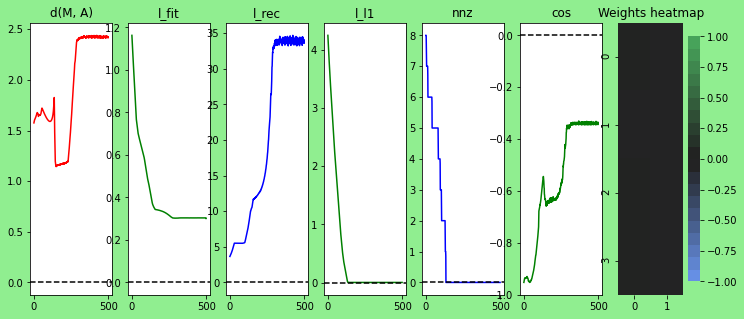

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


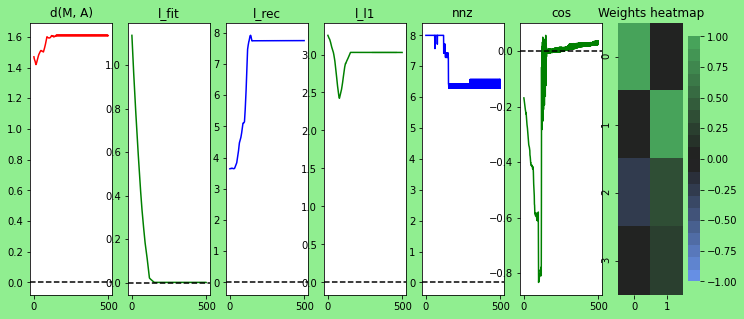

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


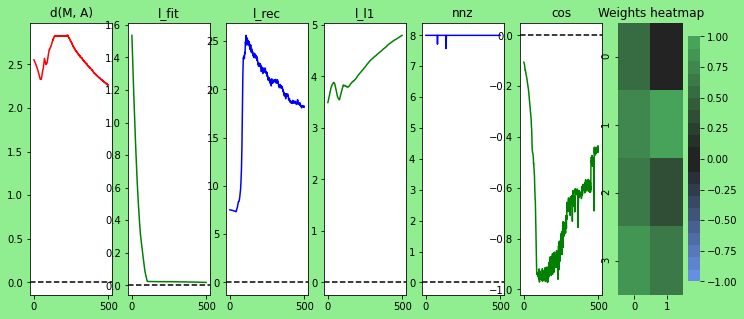

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


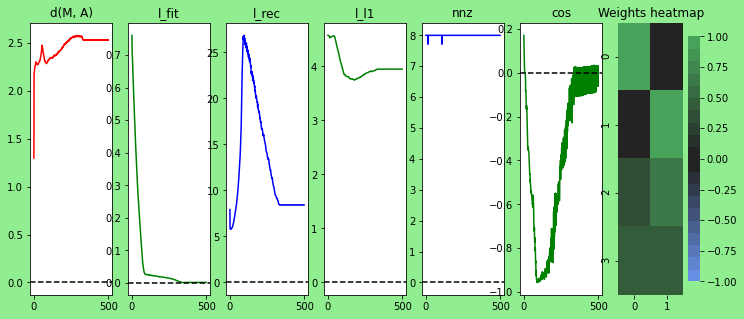

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


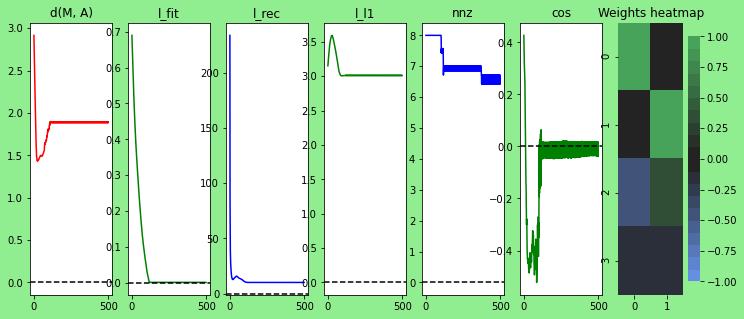

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


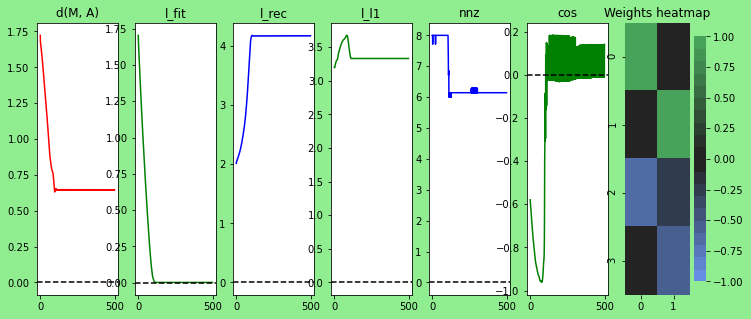

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


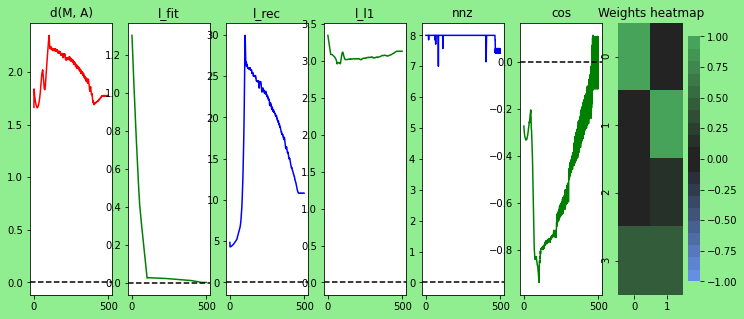

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


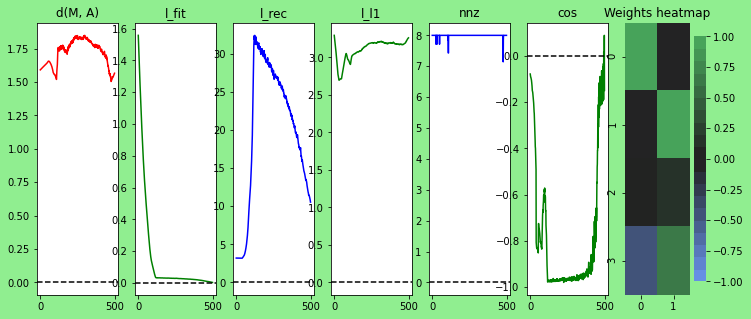

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


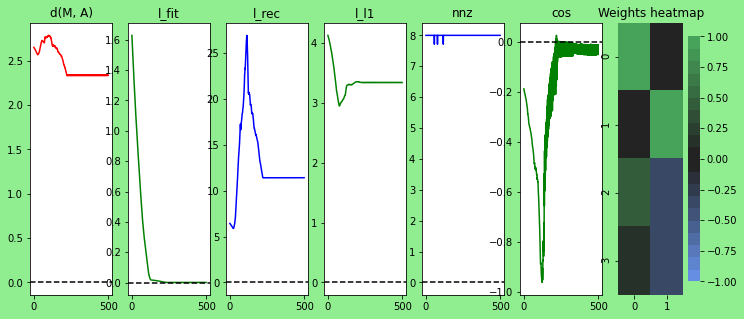

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


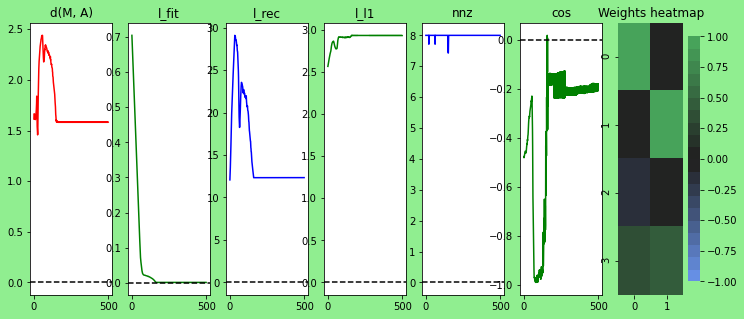

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


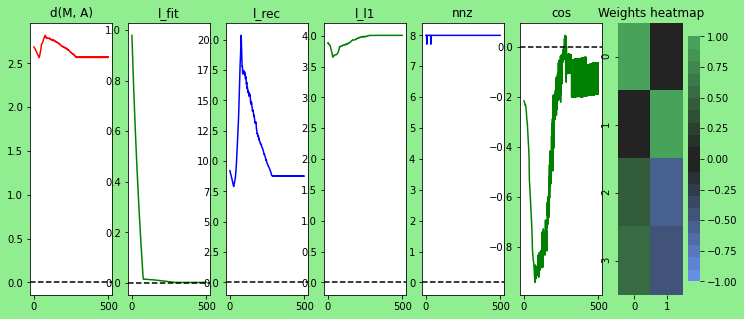

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


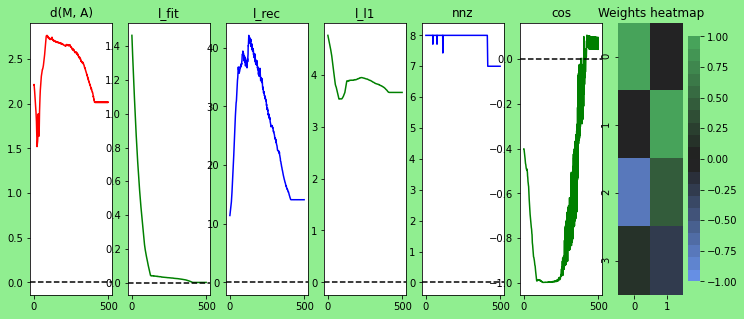

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


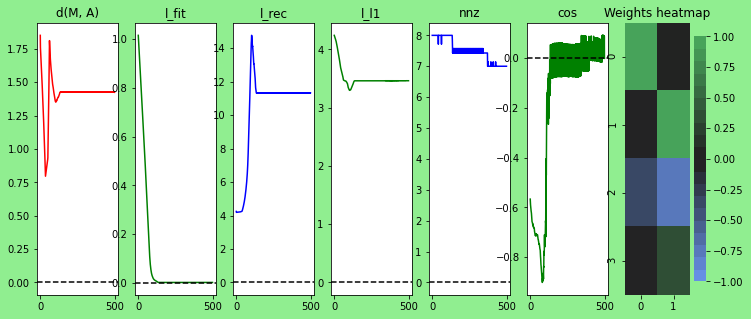

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


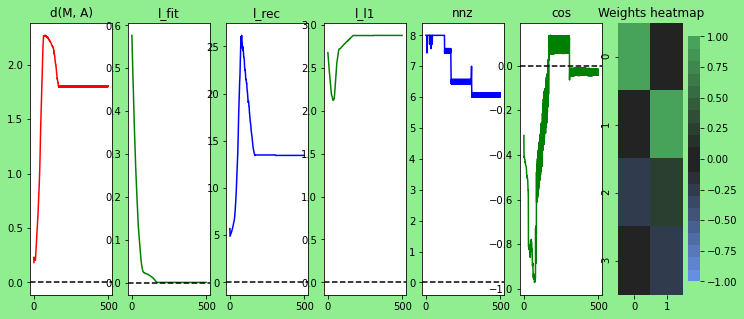

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


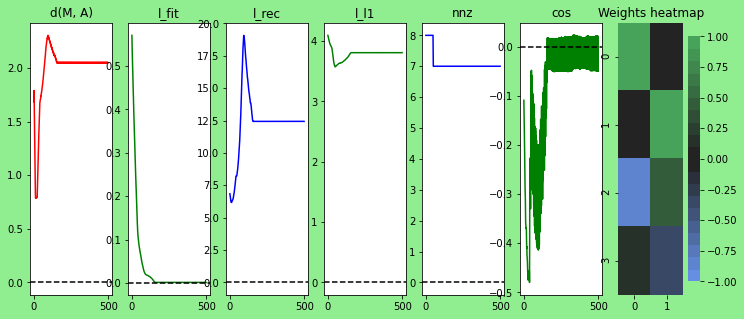

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


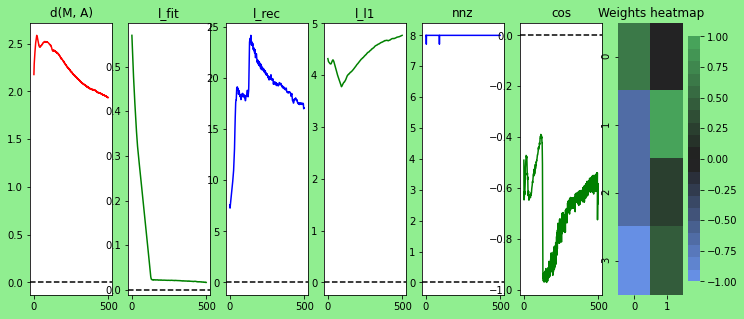

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


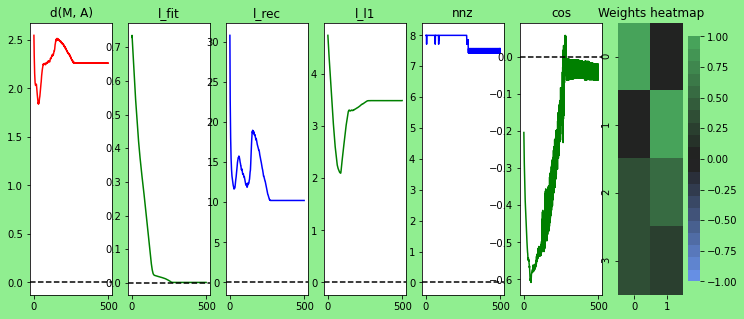

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


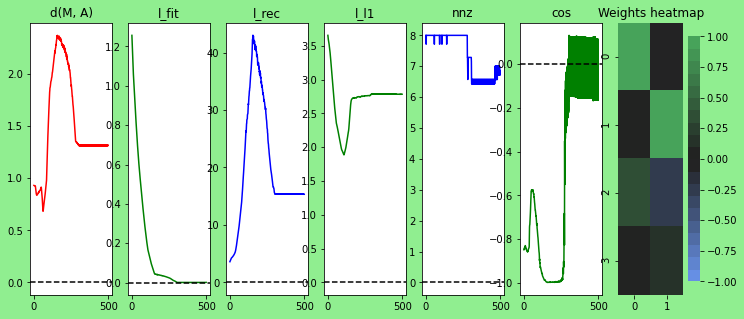

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


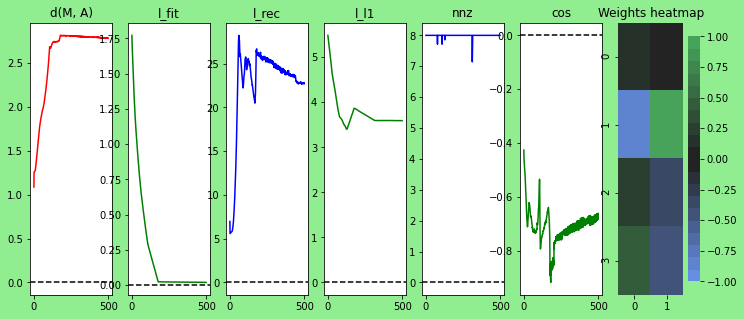

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


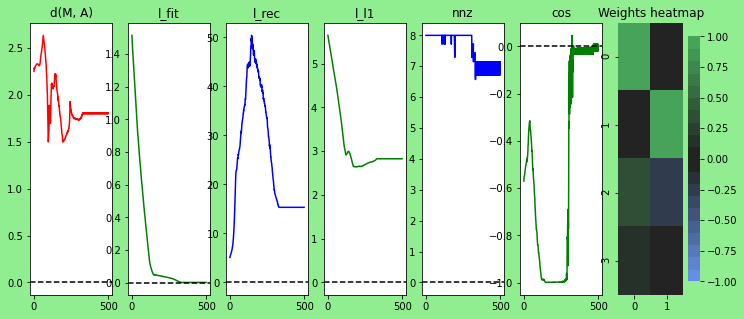

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


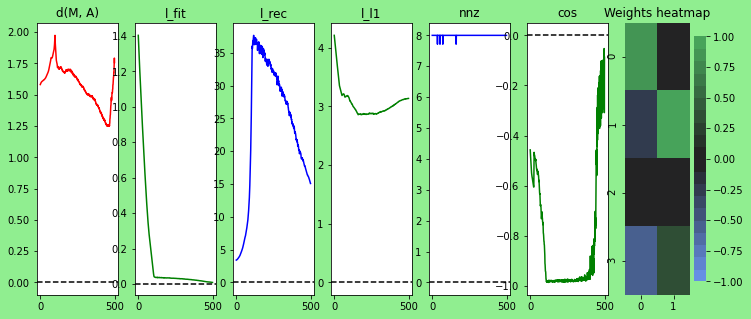

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


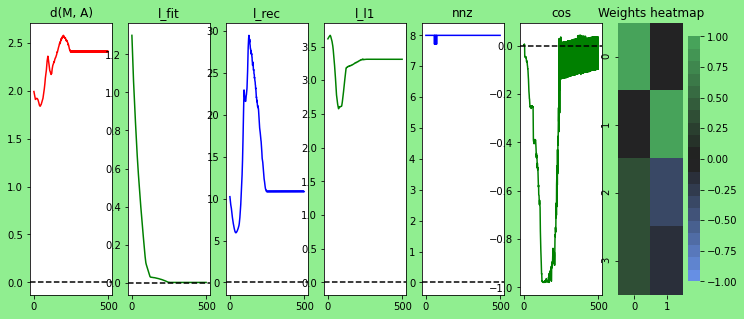

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


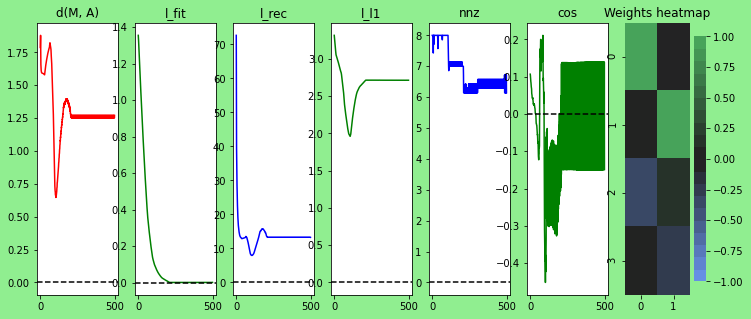

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


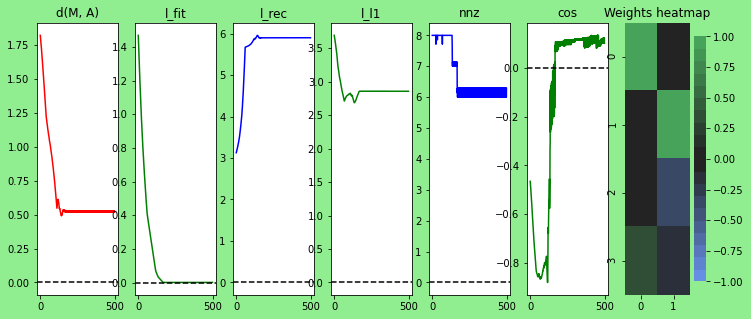

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


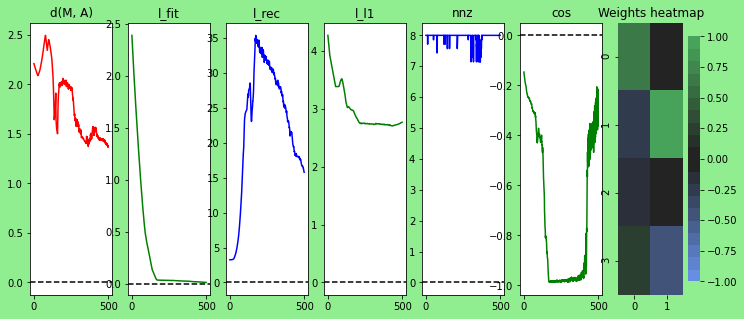

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


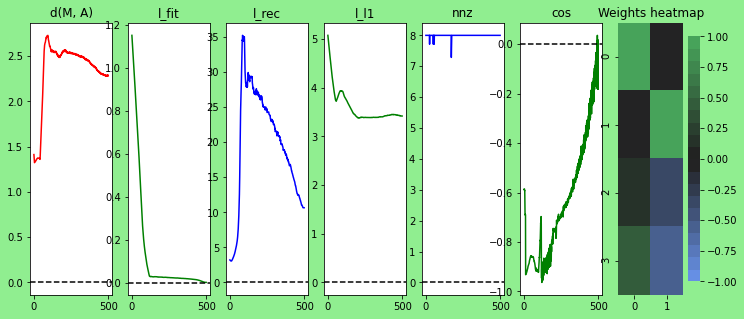

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


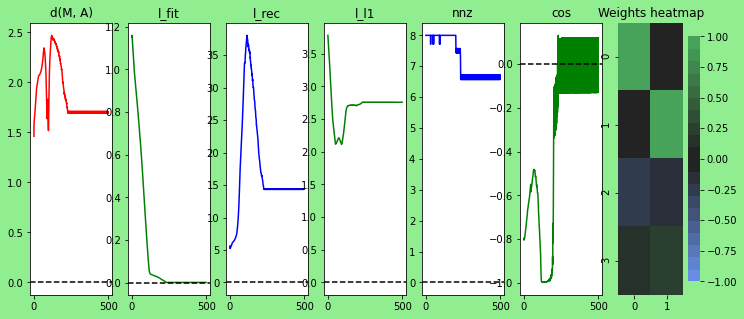

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


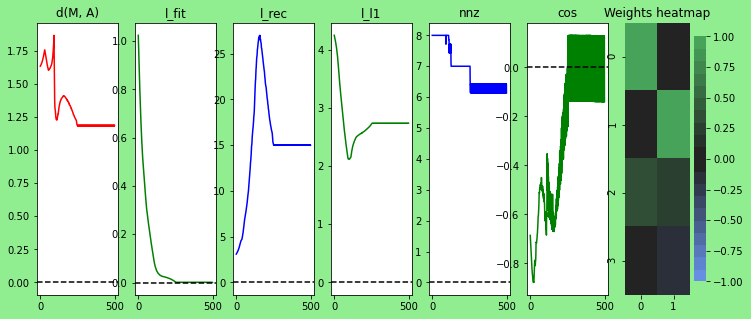

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


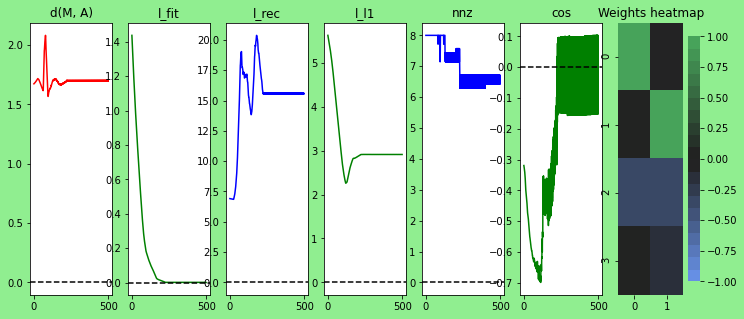

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


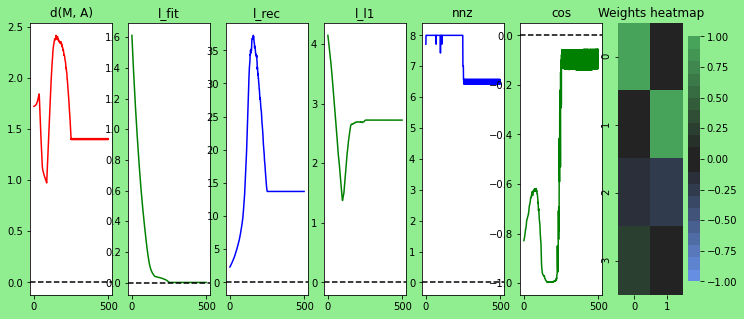

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


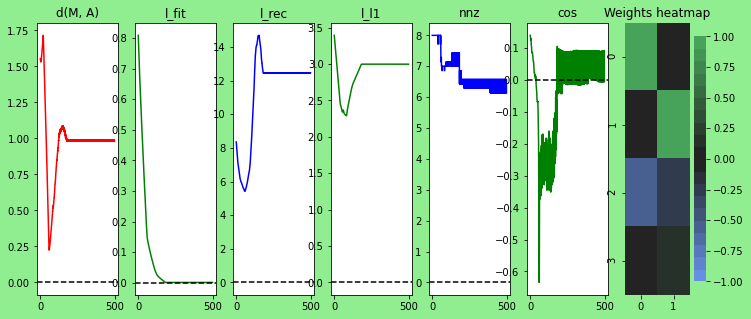

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


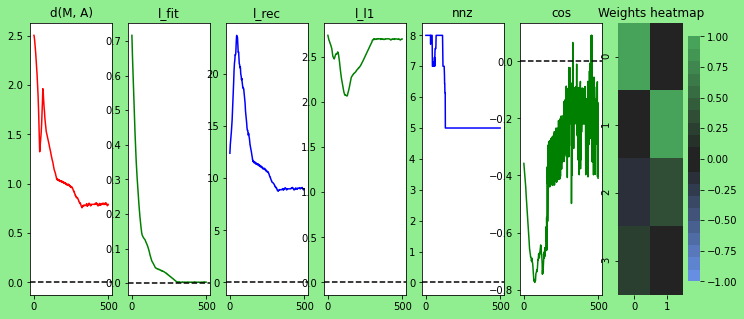

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


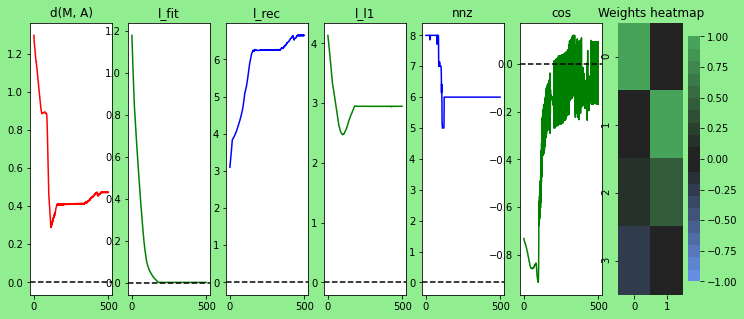

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


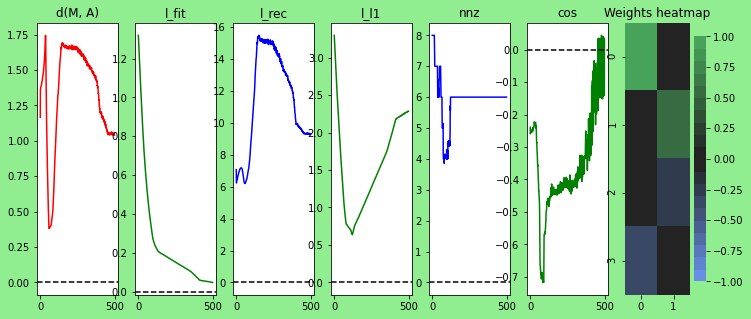

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


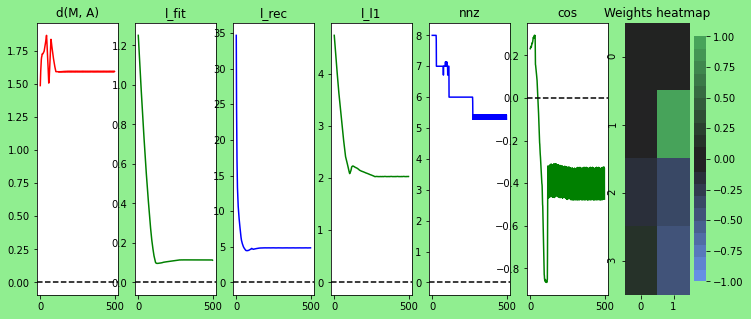

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


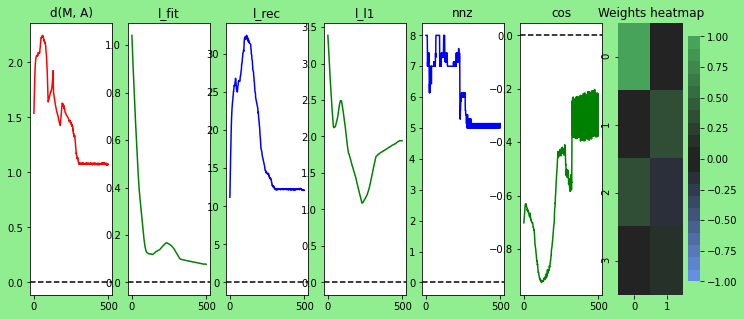

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


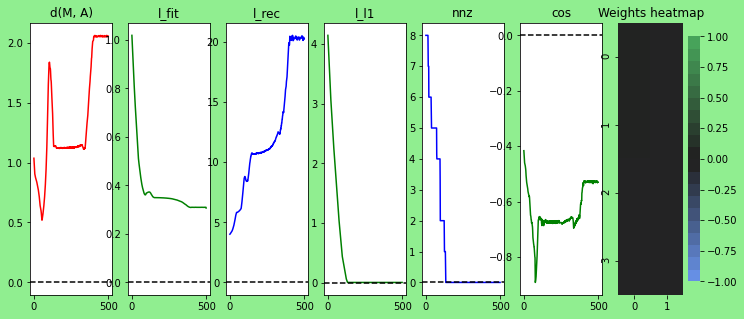

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


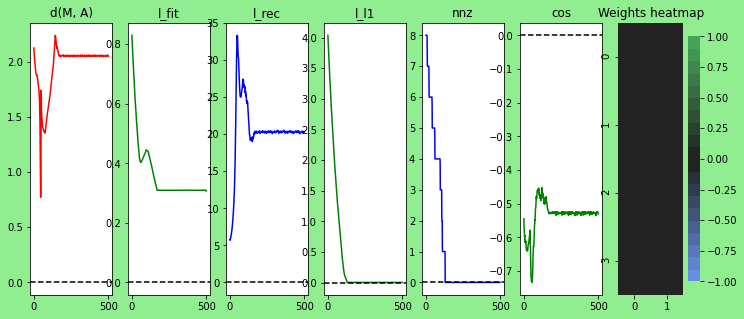

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


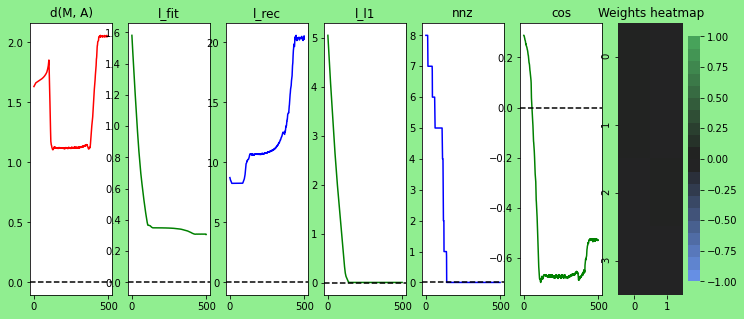

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


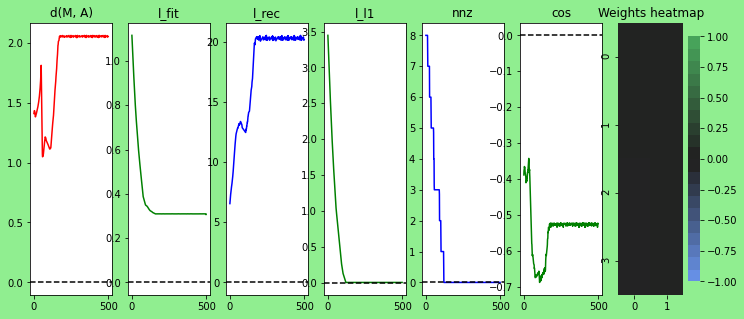

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


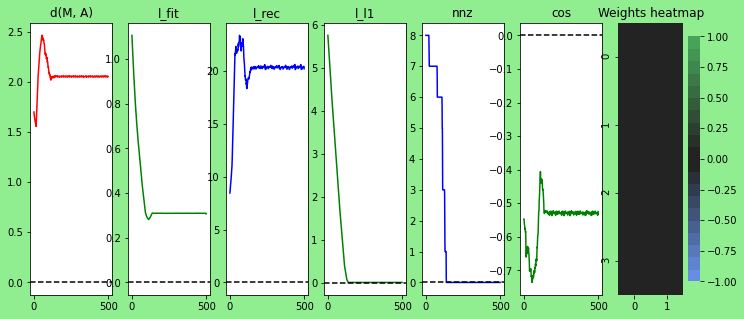

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


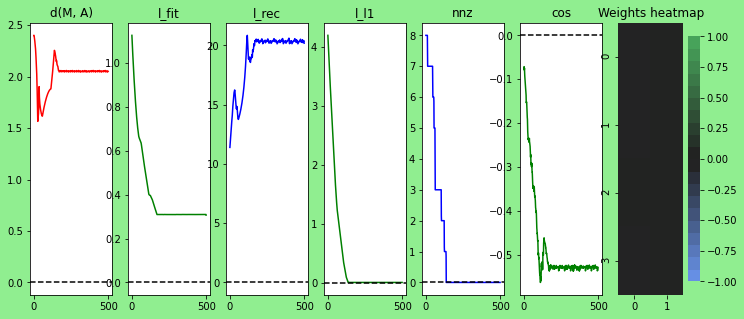

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


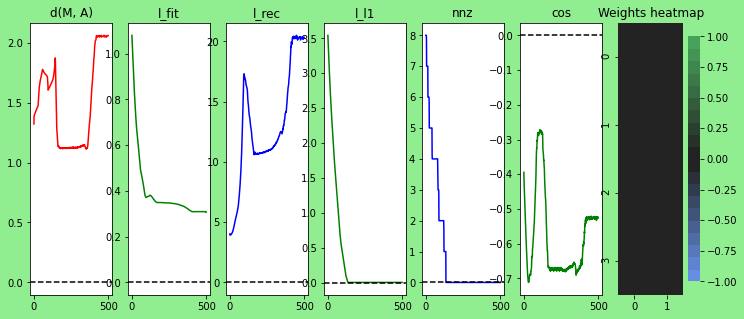

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


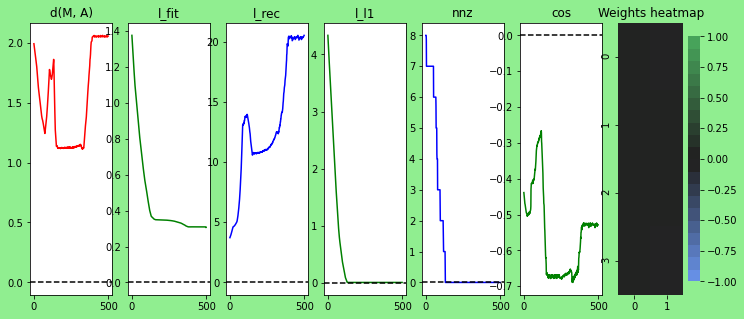

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


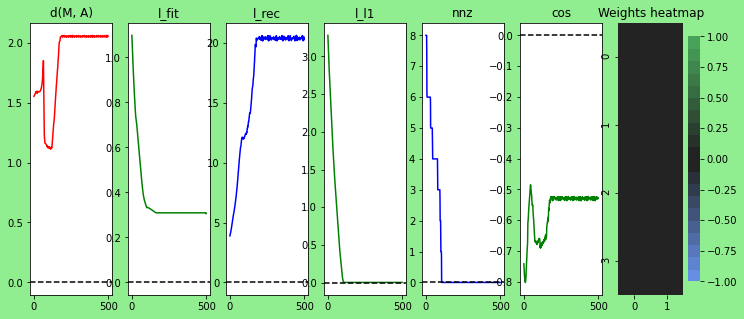

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


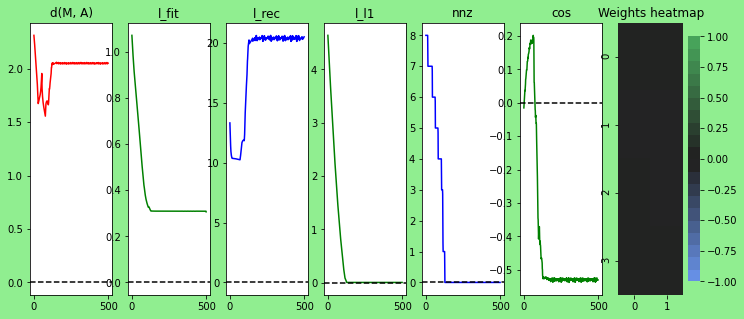

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


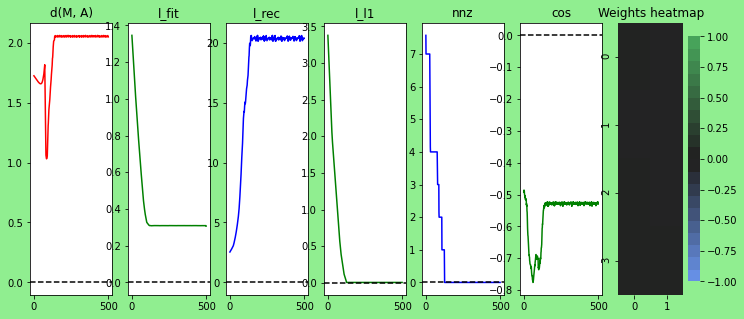

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


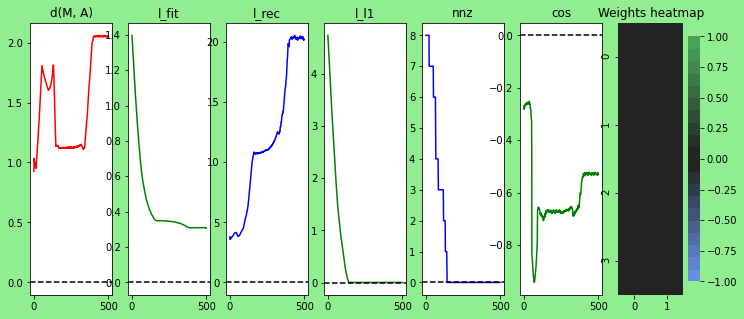

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


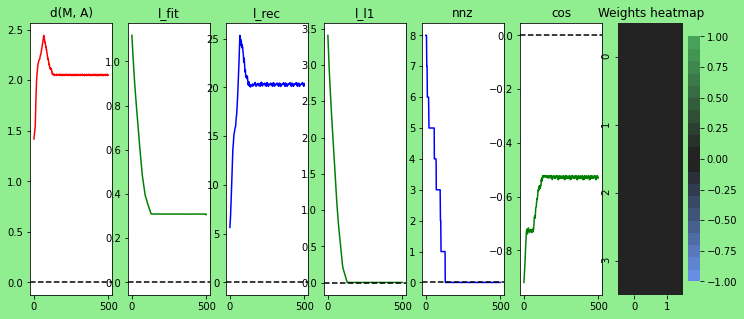

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


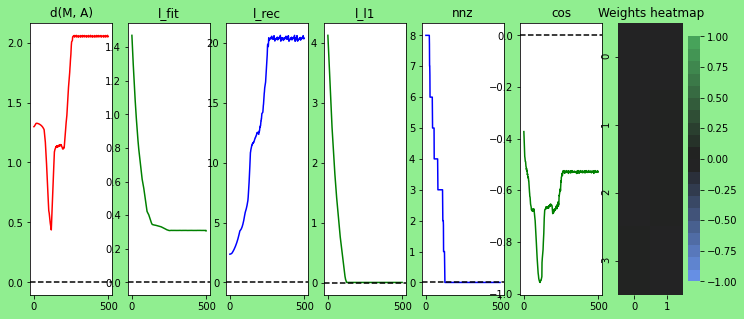

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.001, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


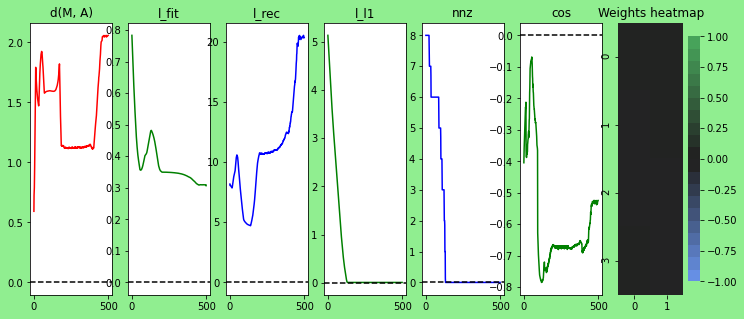

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


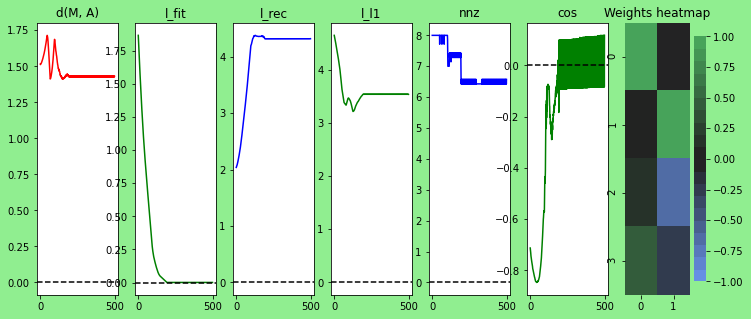

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


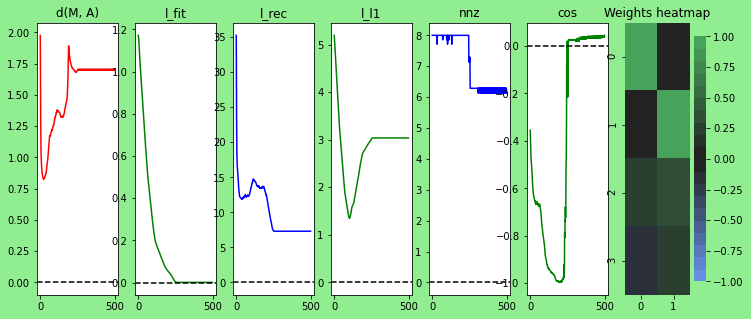

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


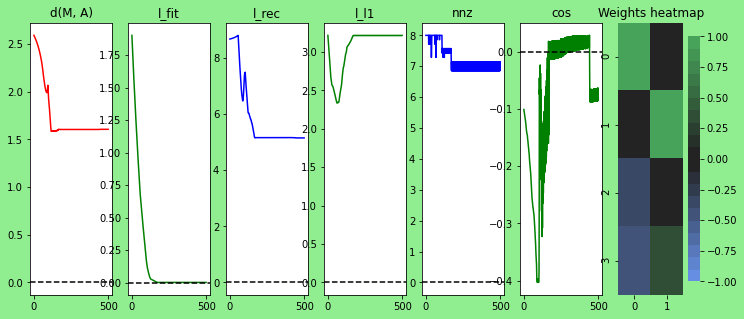

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


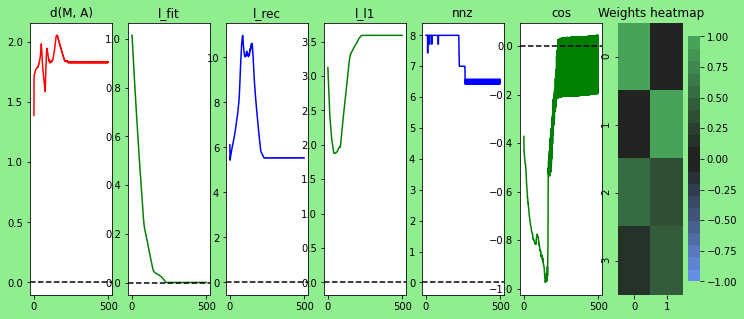

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


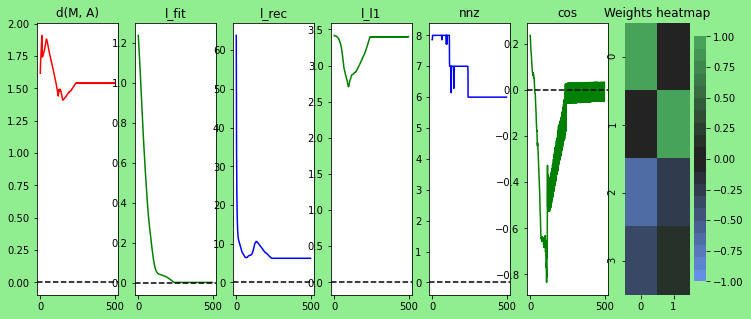

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


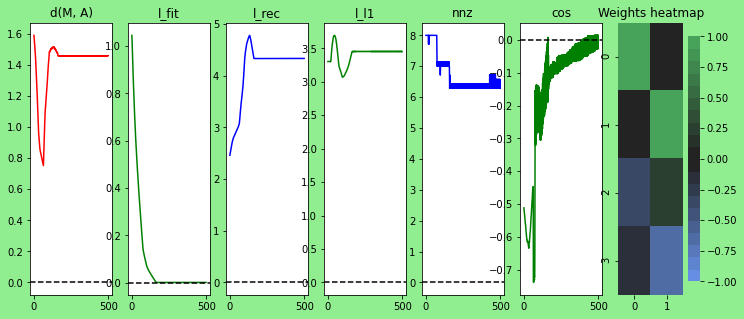

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


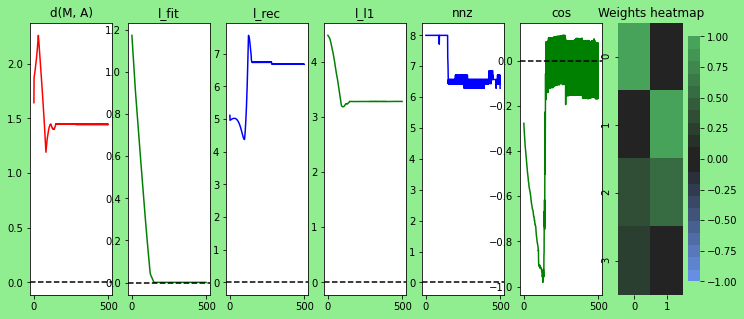

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


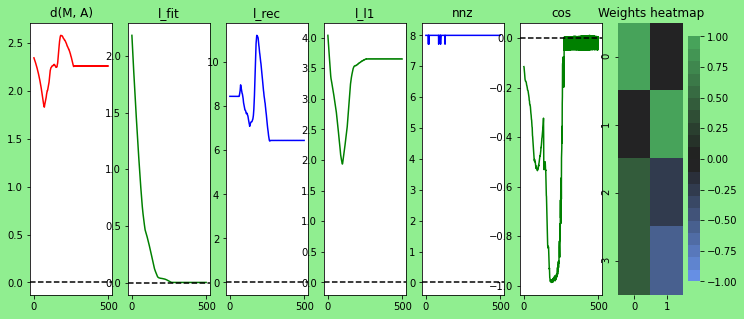

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


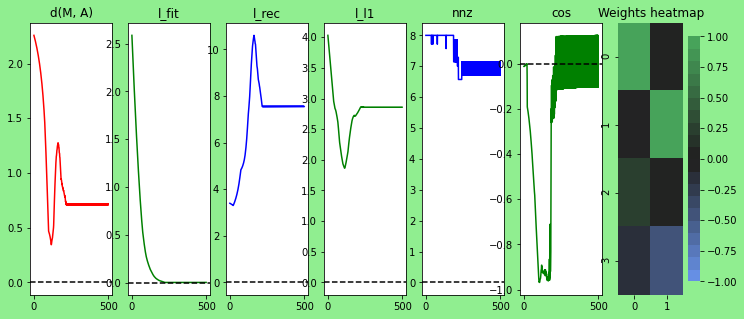

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


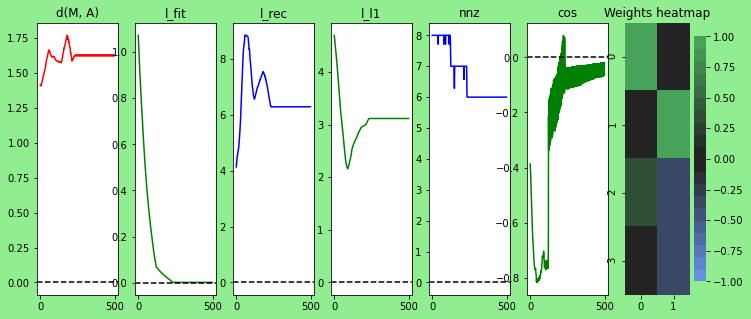

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


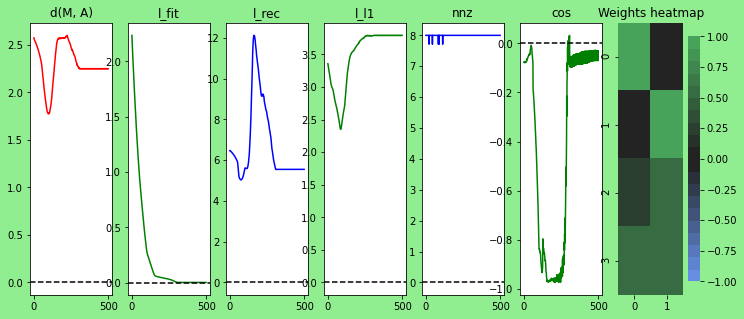

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


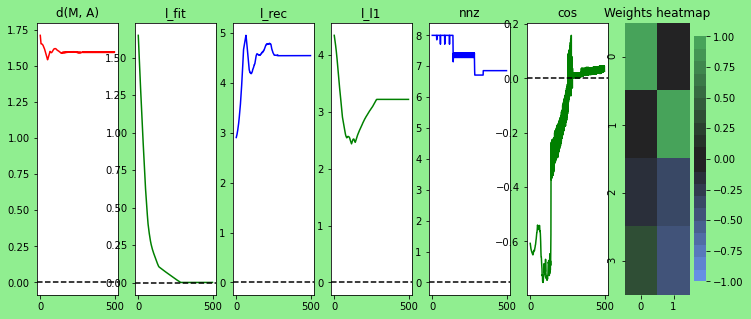

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


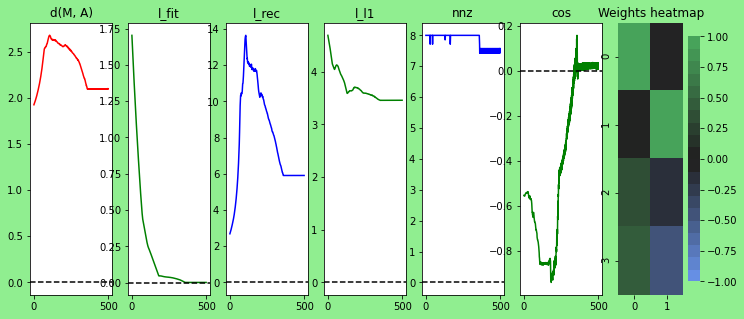

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


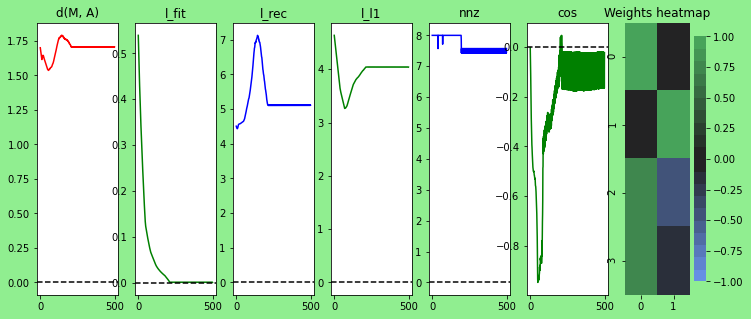

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


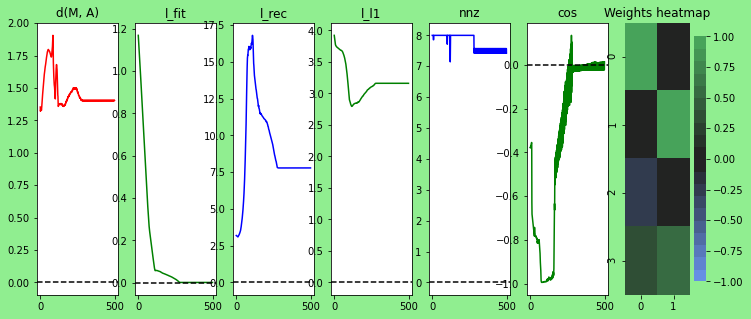

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


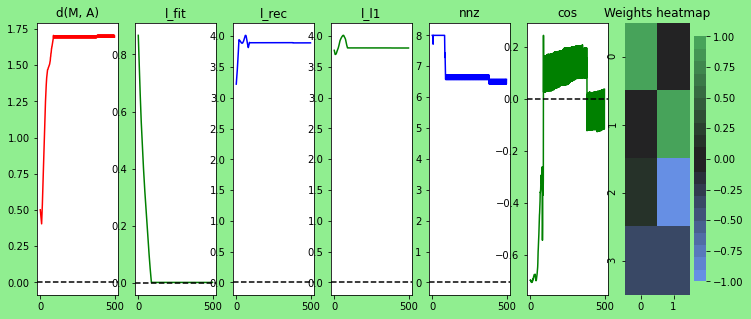

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


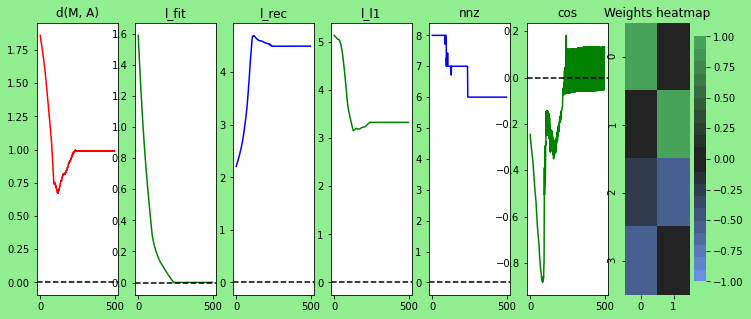

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


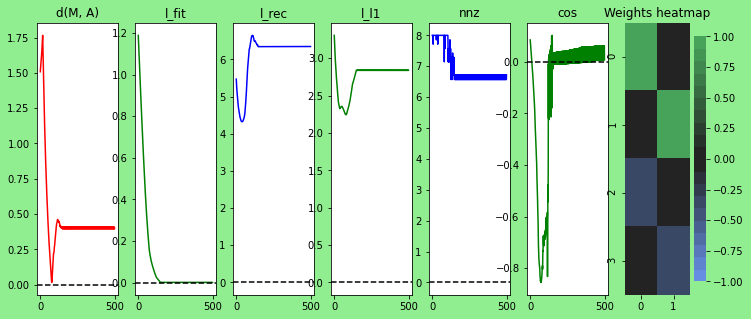

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


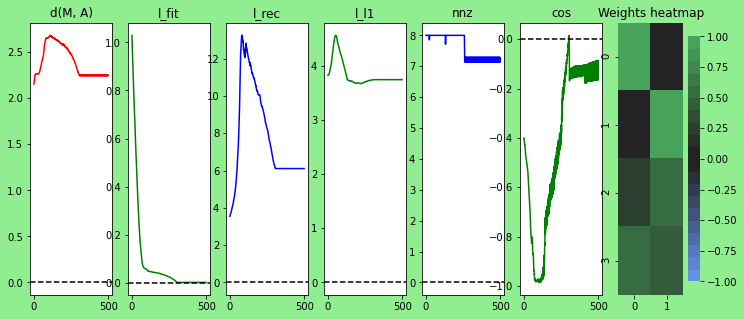

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


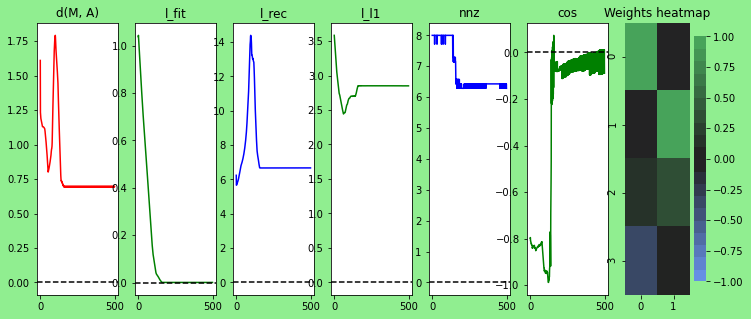

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


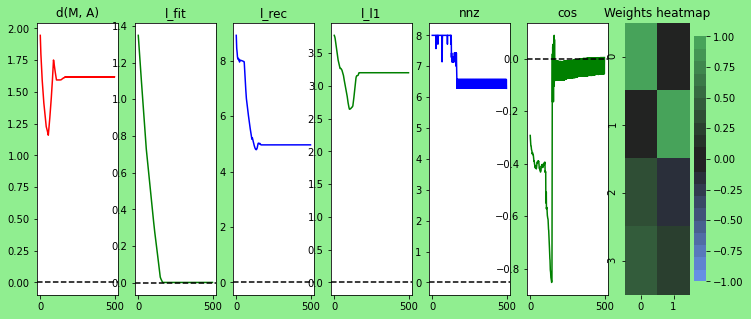

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


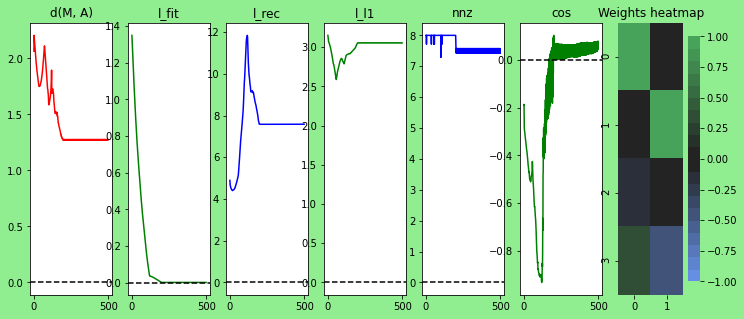

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


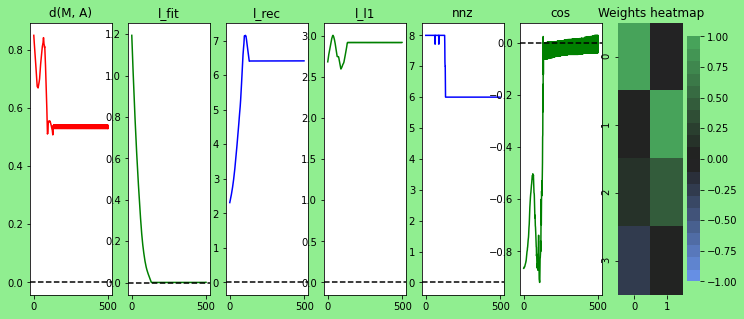

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


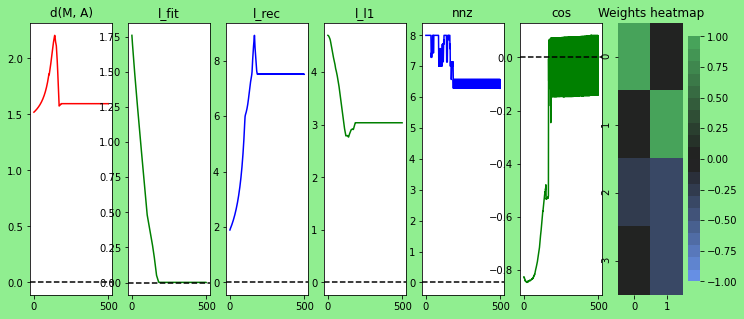

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


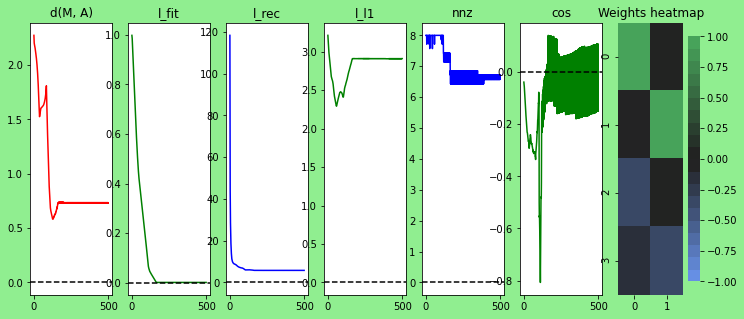

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


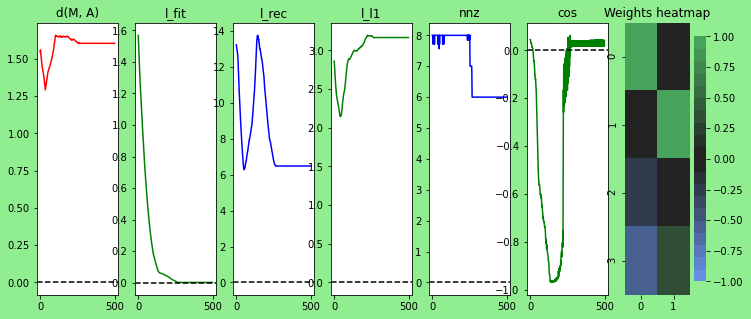

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


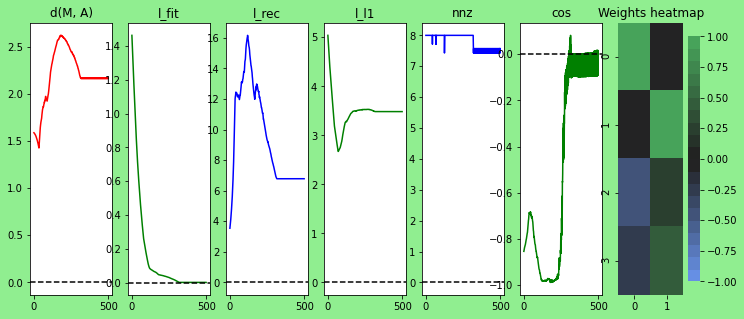

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


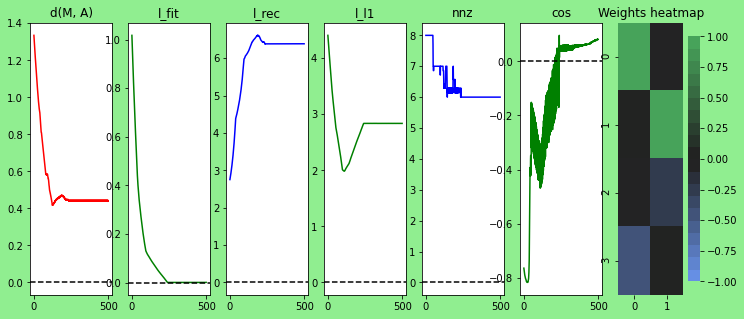

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


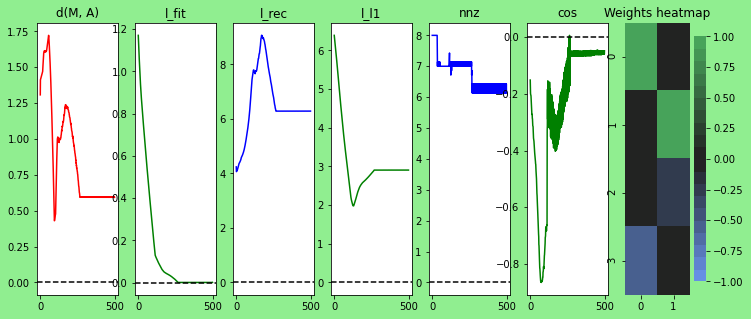

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


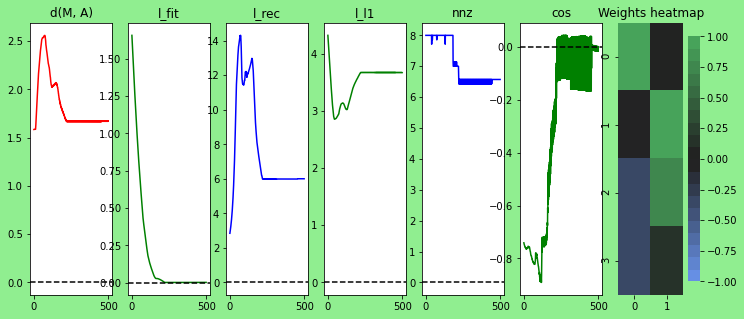

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


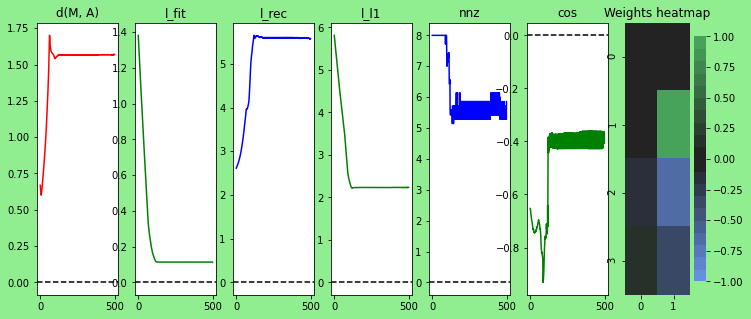

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


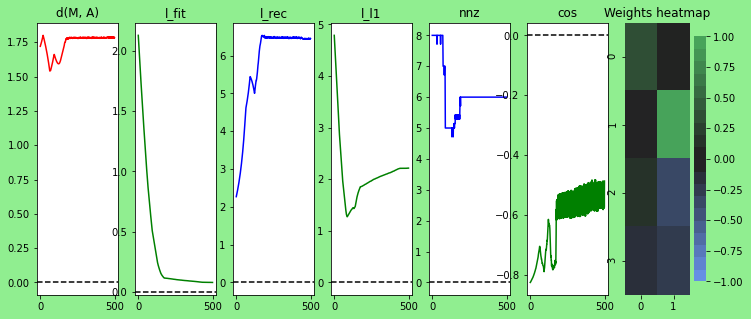

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


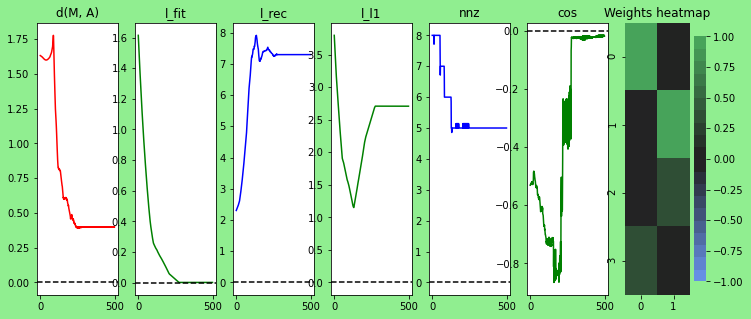

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


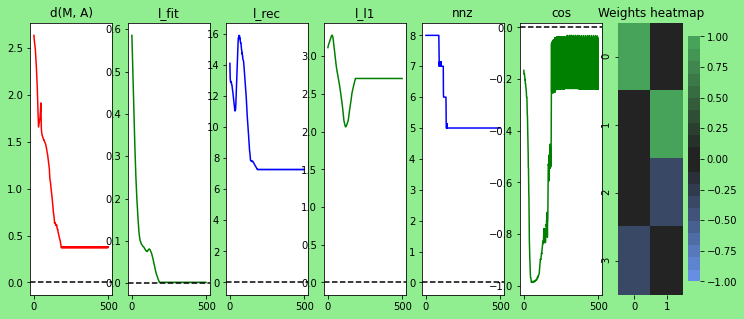

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


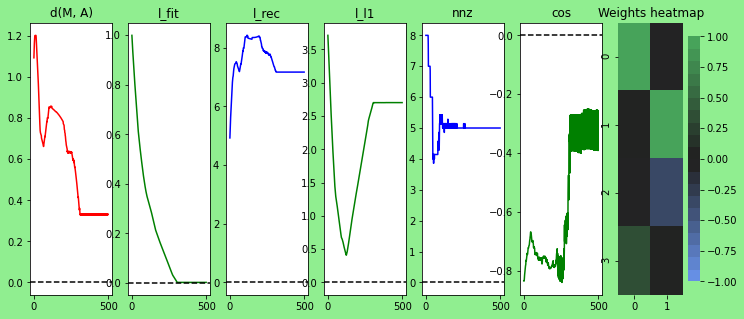

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


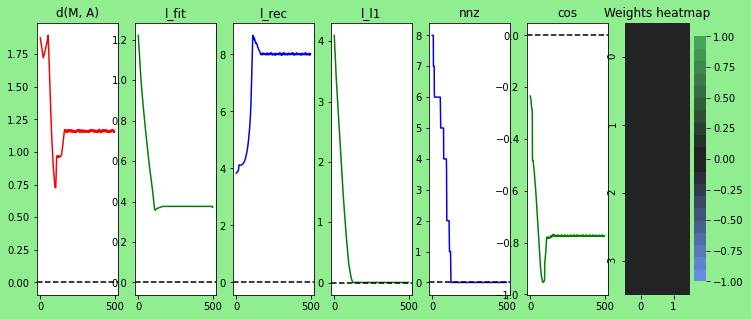

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


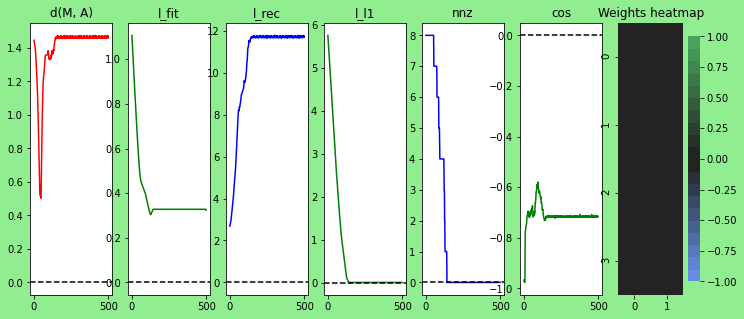

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


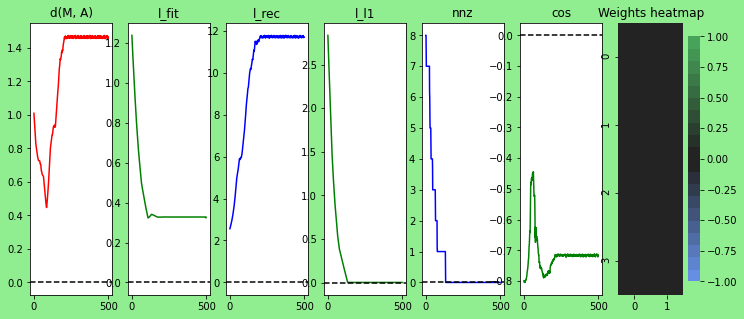

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


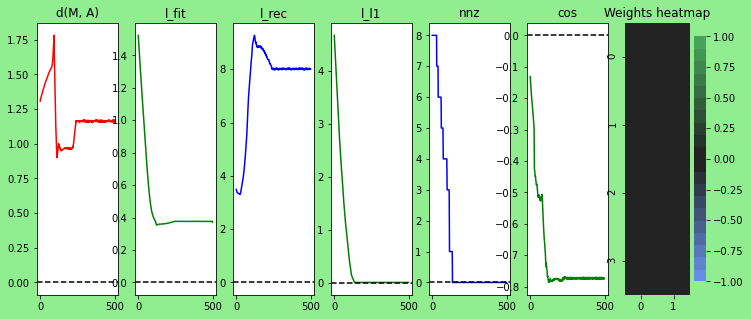

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


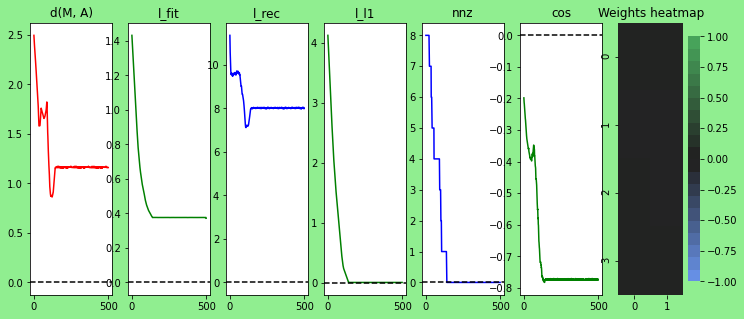

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


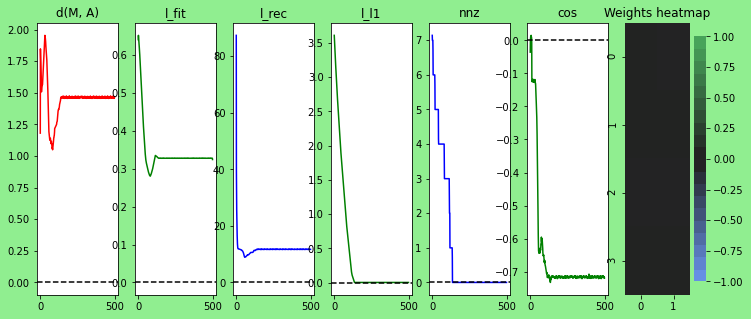

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


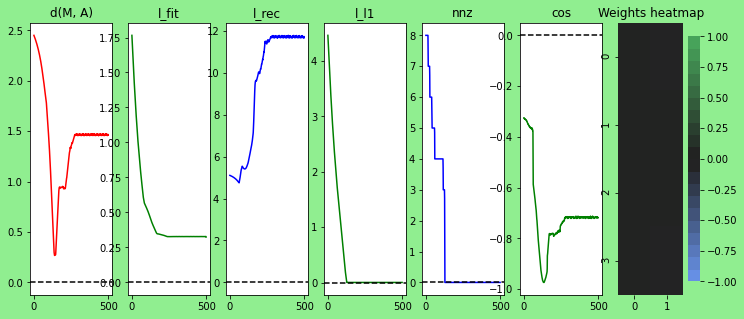

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


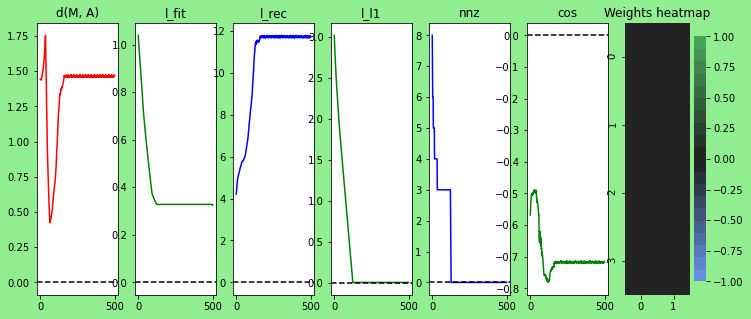

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


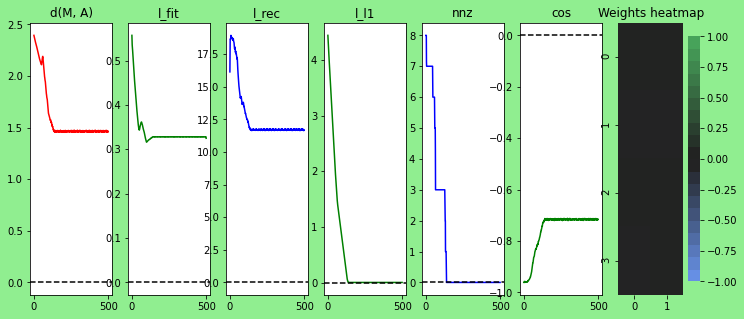

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


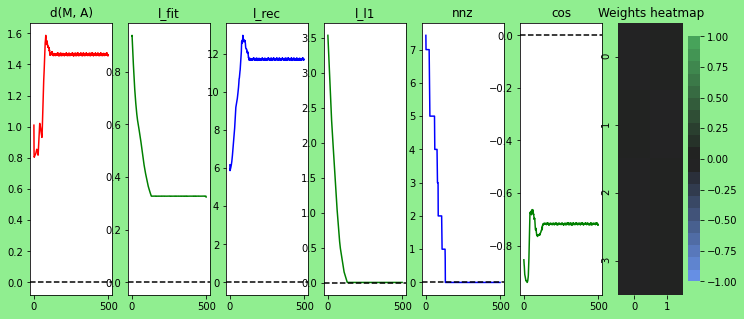

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


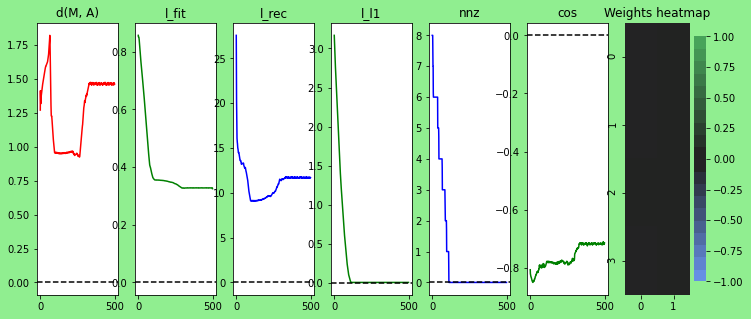

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


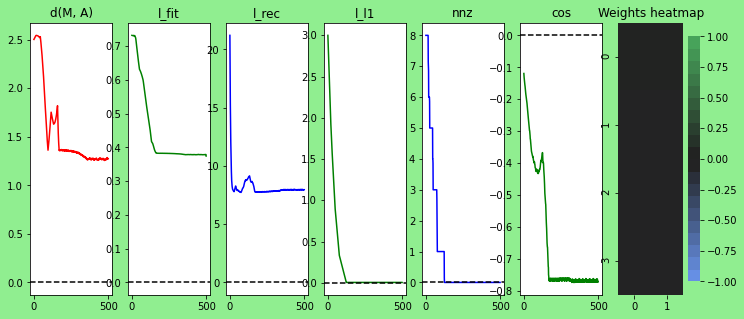

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


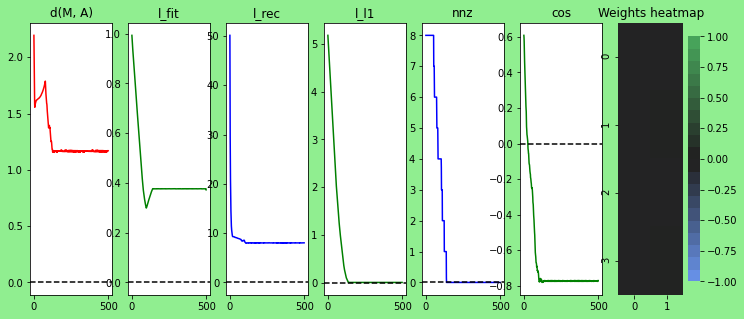

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


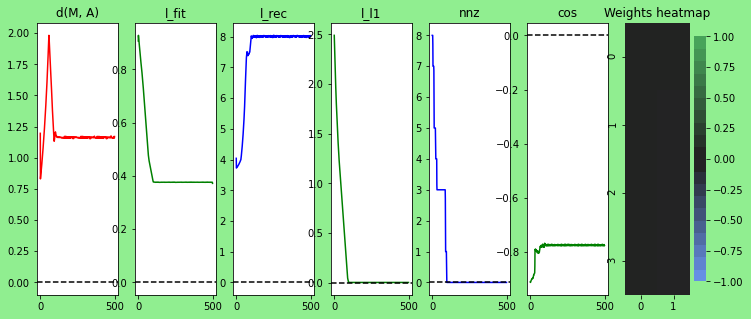

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


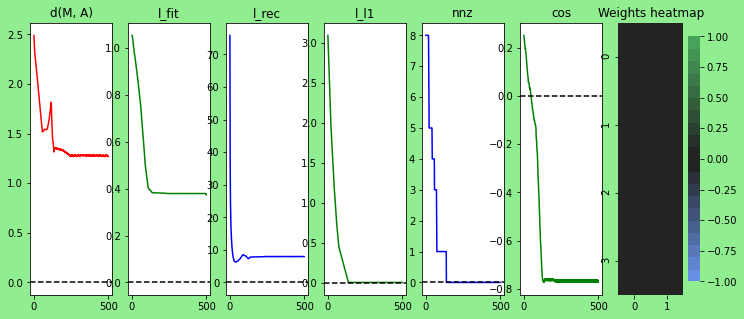

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


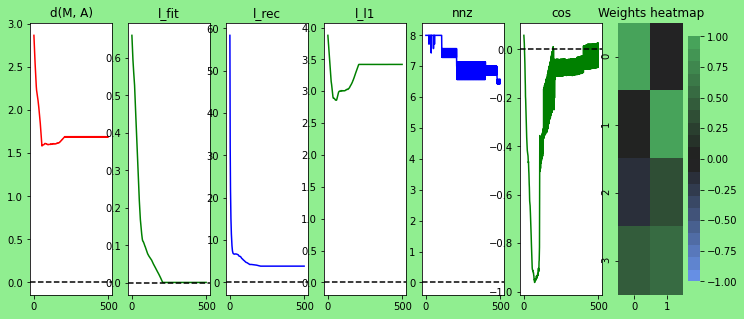

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


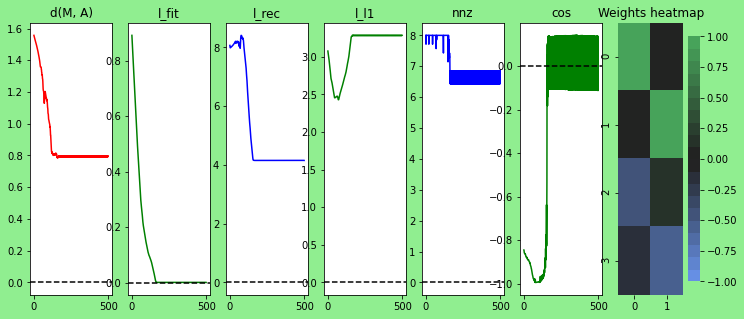

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


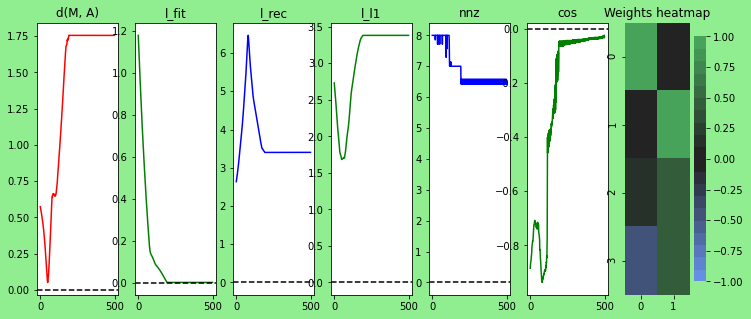

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


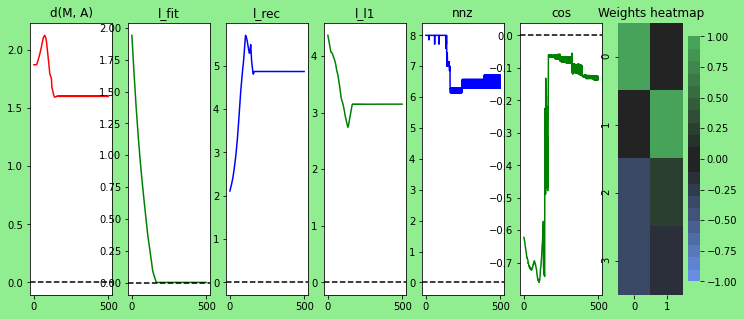

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


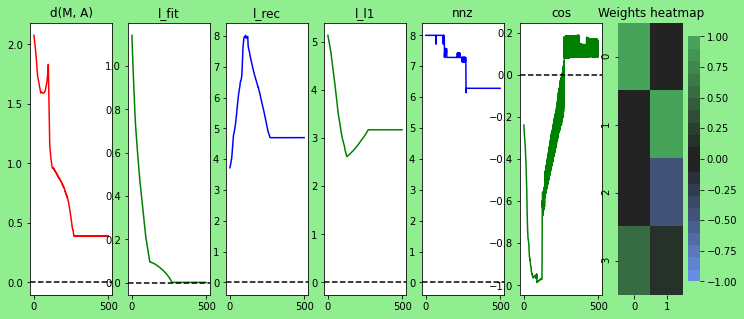

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


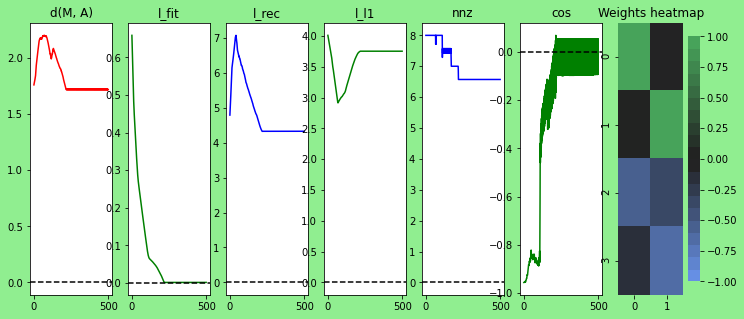

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


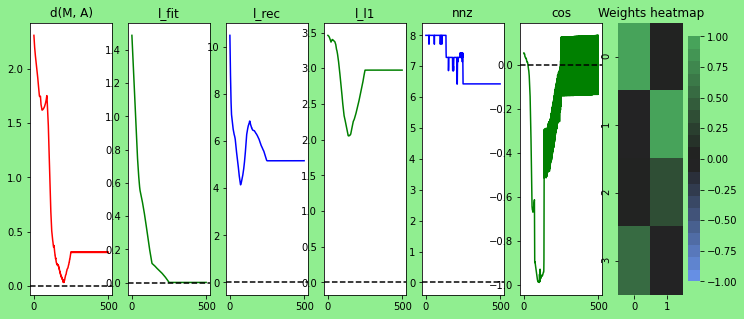

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


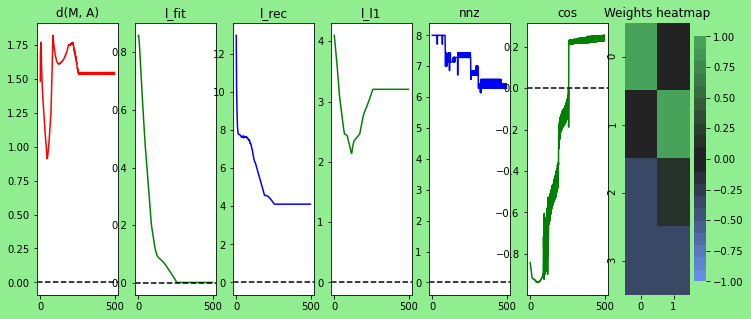

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


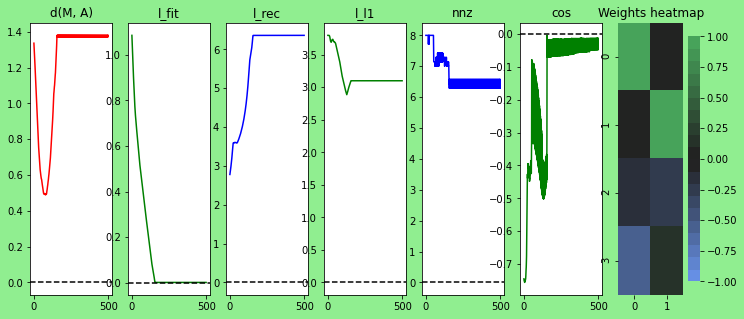

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


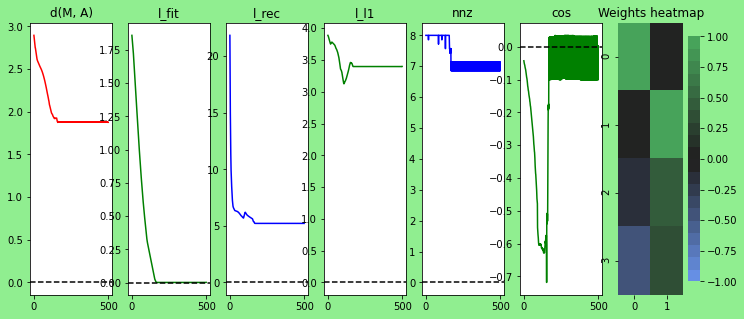

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


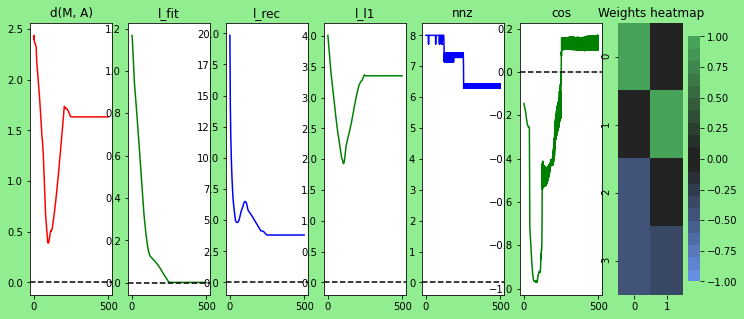

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


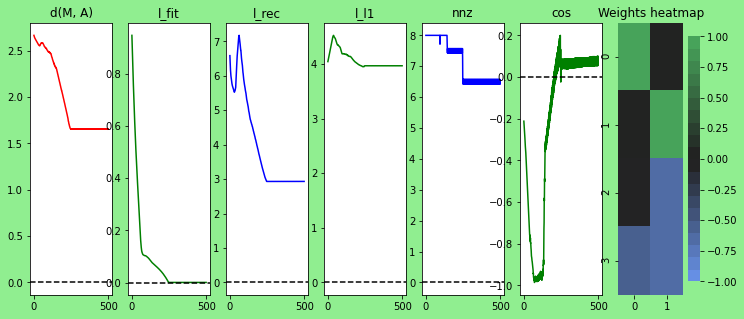

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


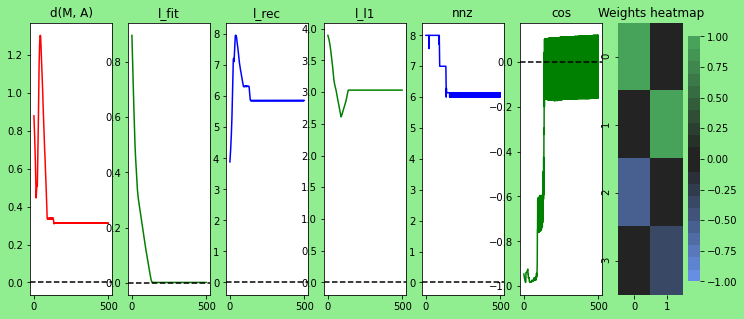

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


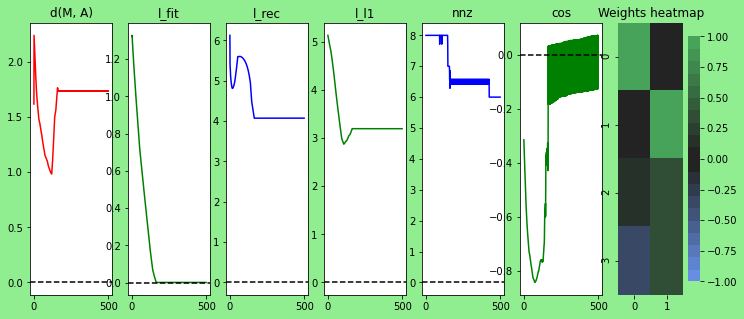

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


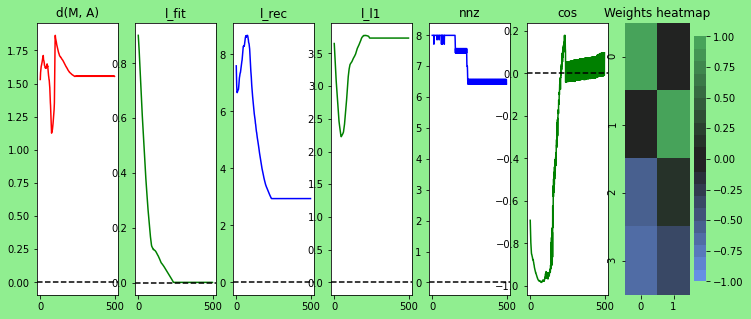

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


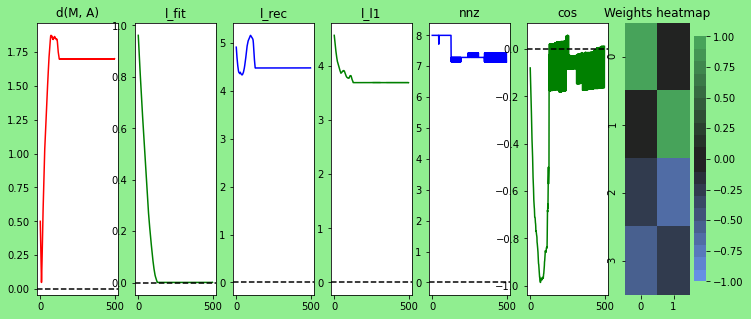

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


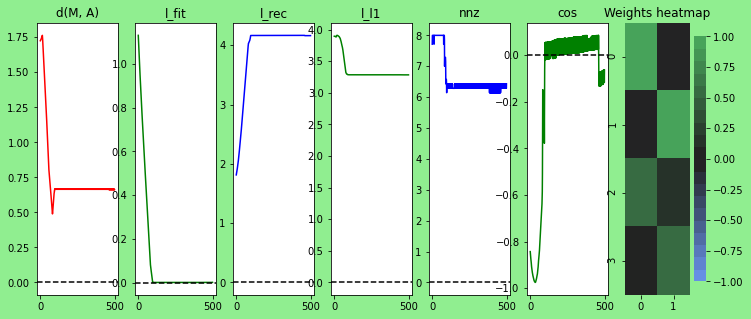

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


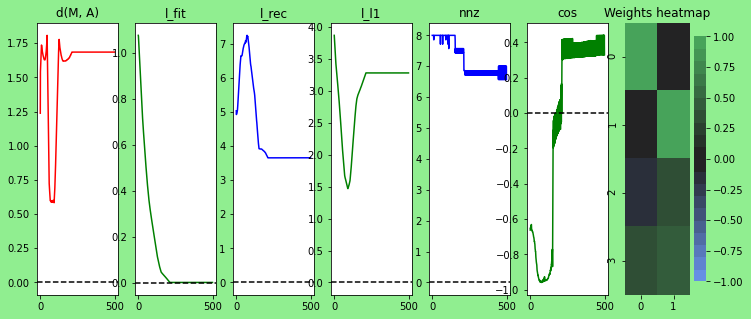

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


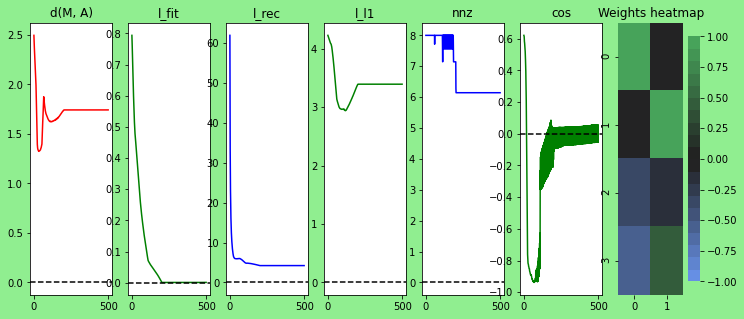

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


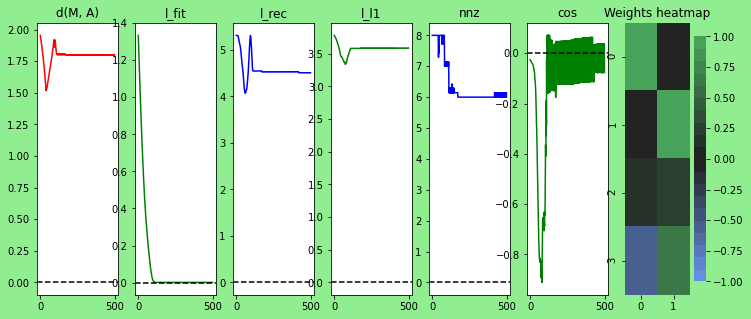

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


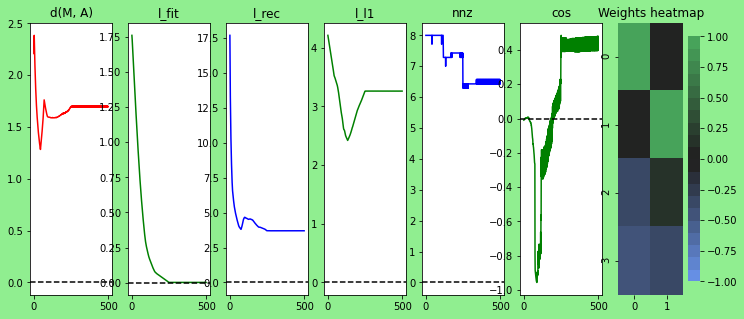

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


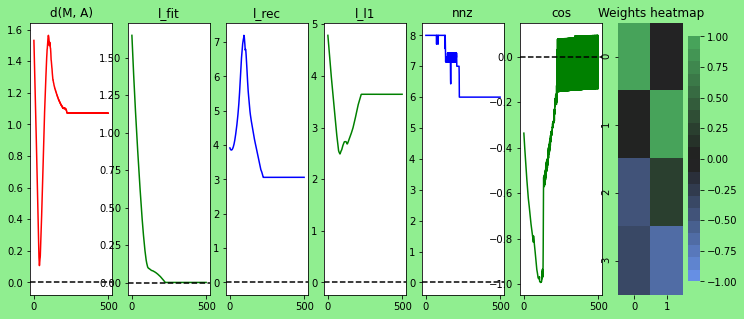

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


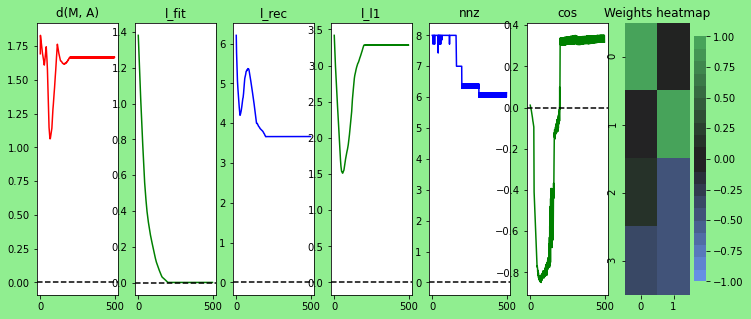

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


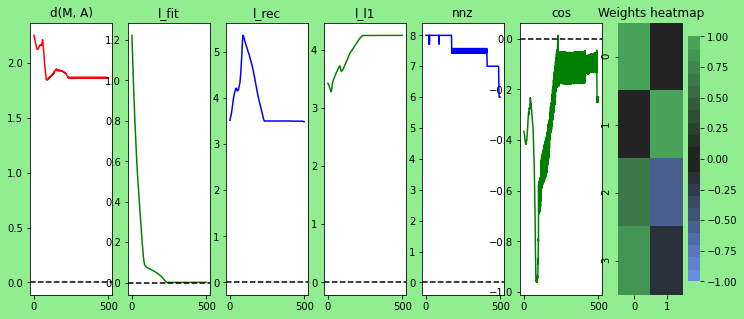

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


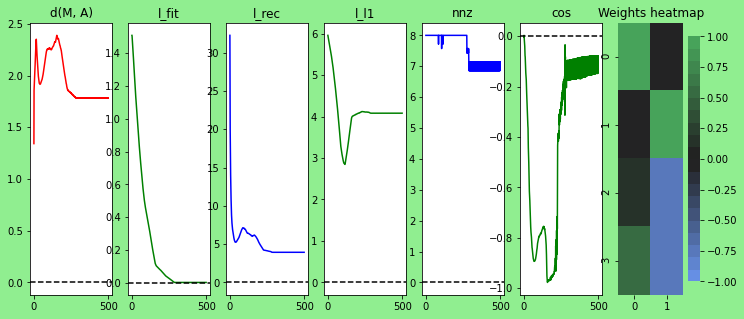

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


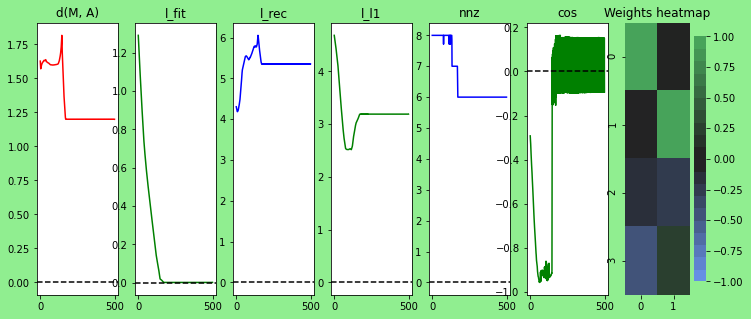

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


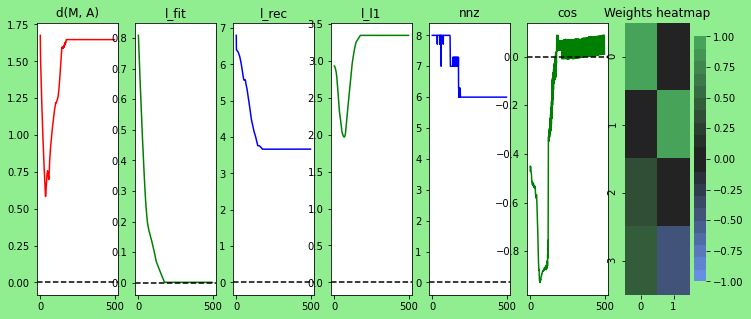

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


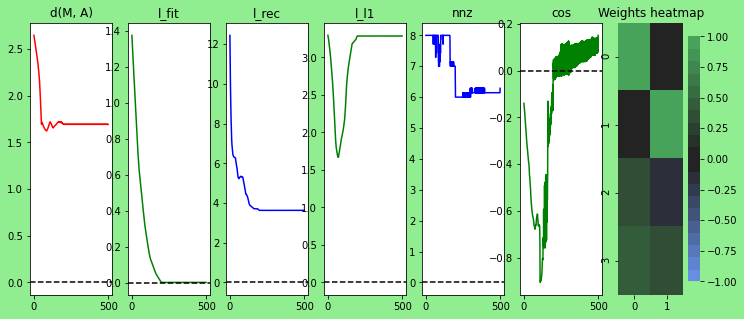

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


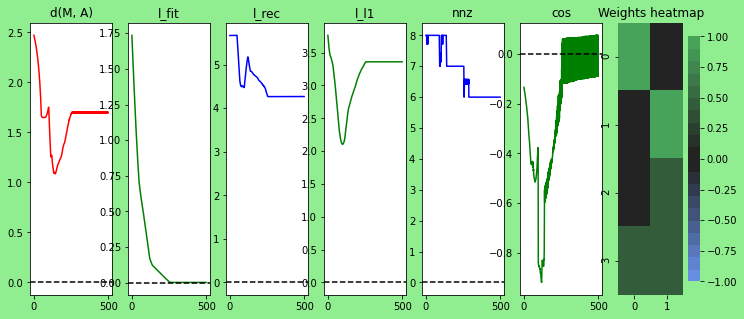

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


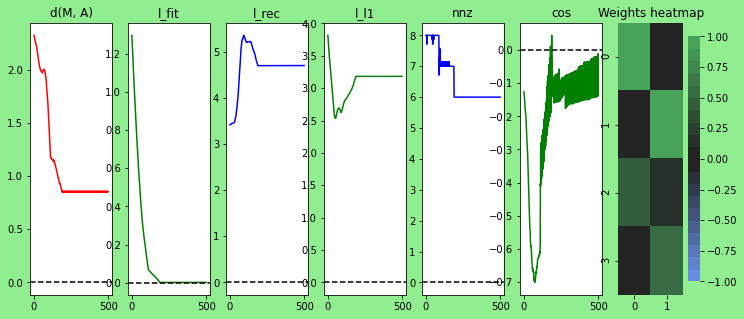

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


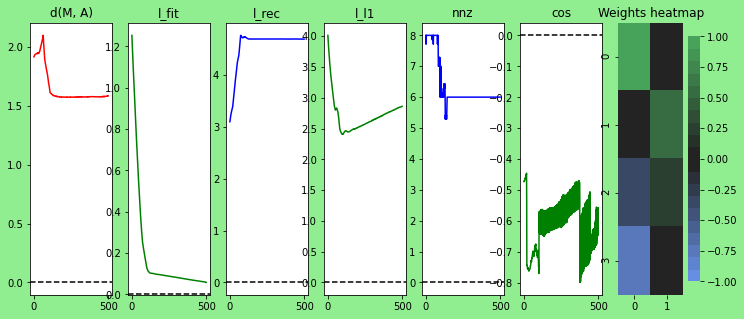

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


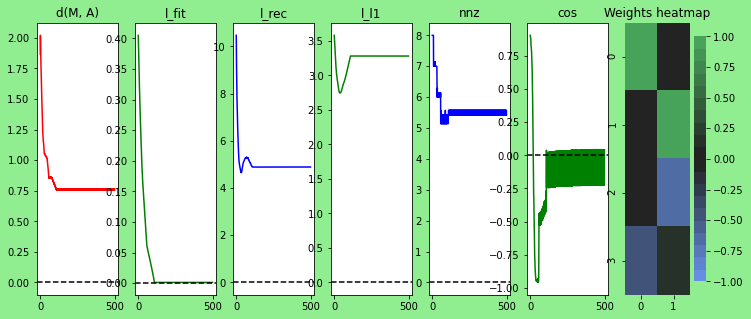

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


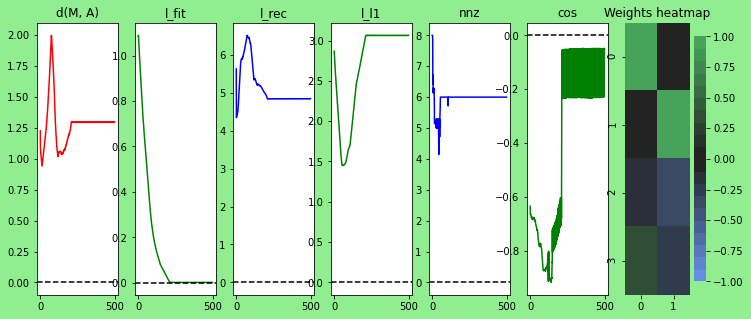

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


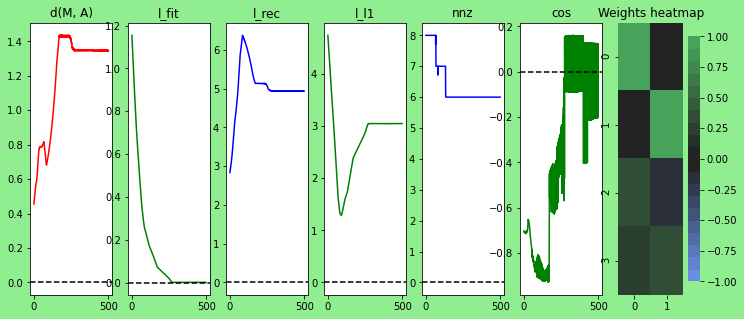

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


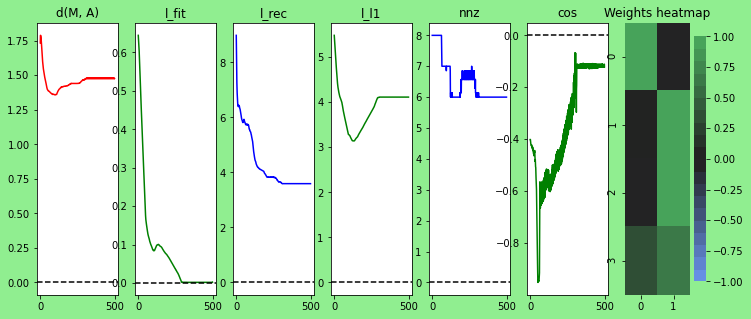

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


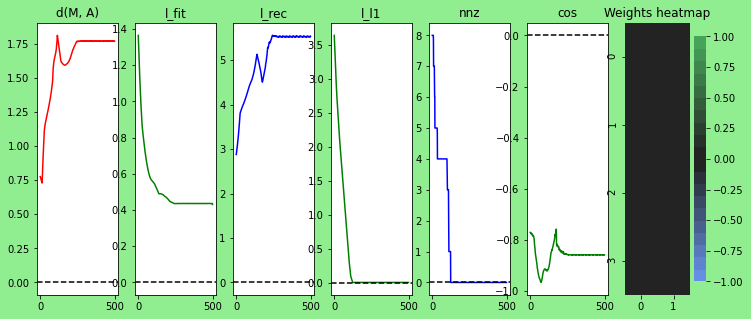

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


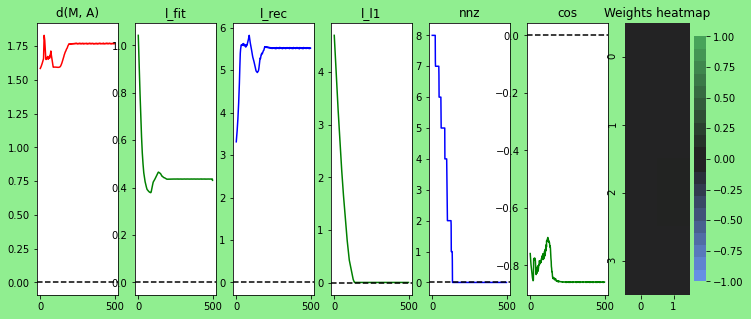

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


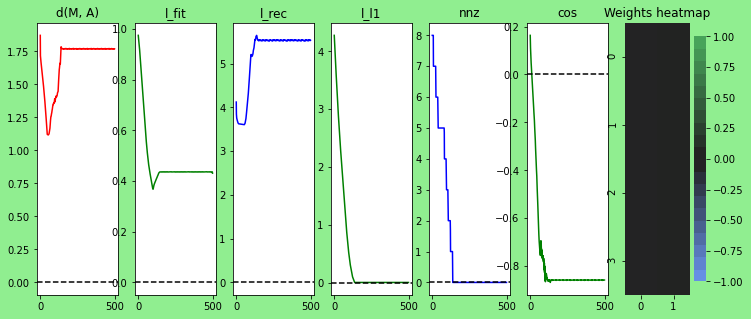

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


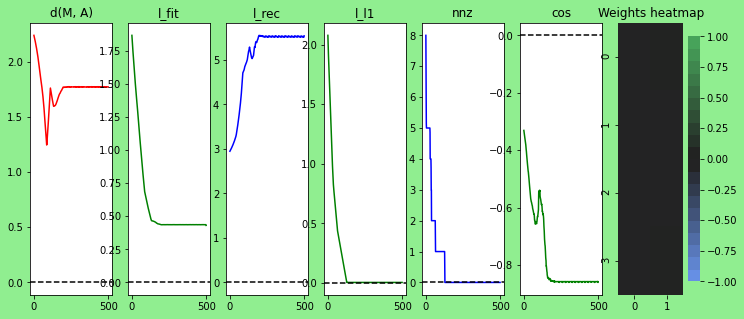

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


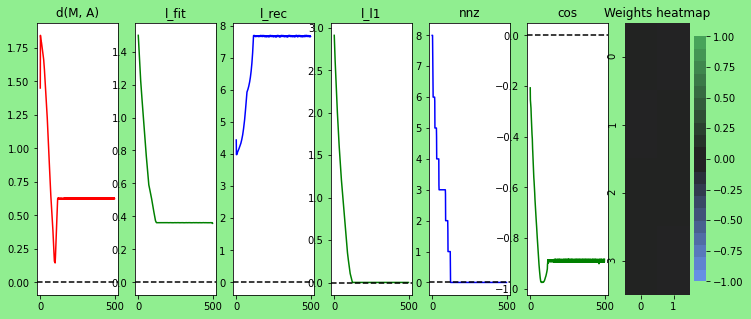

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


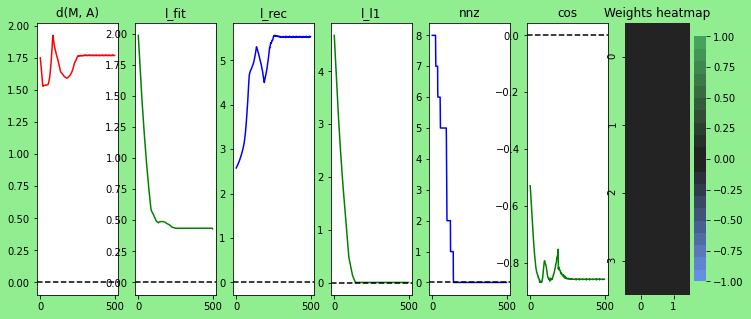

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


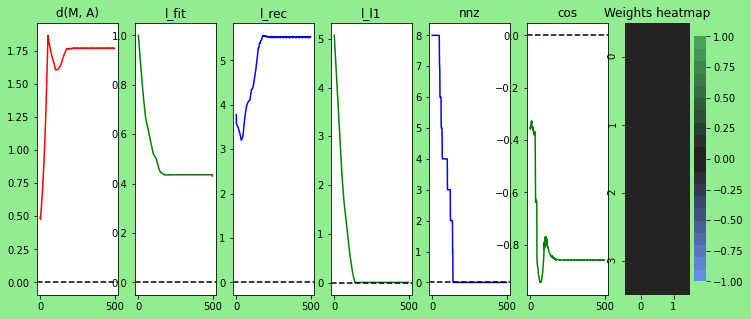

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


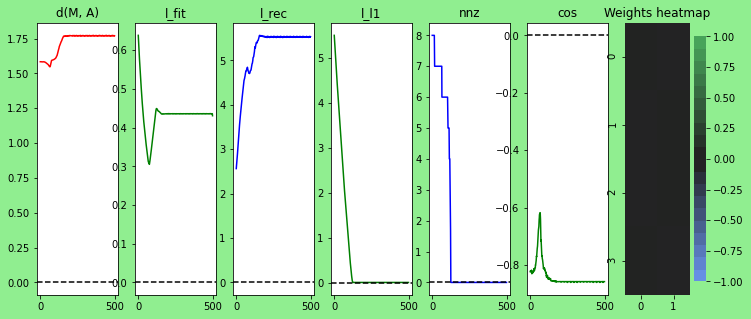

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


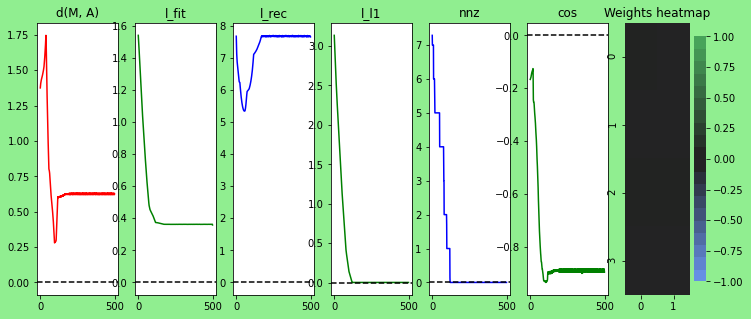

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


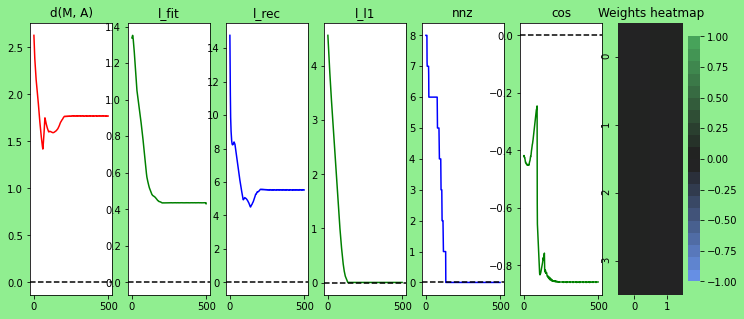

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


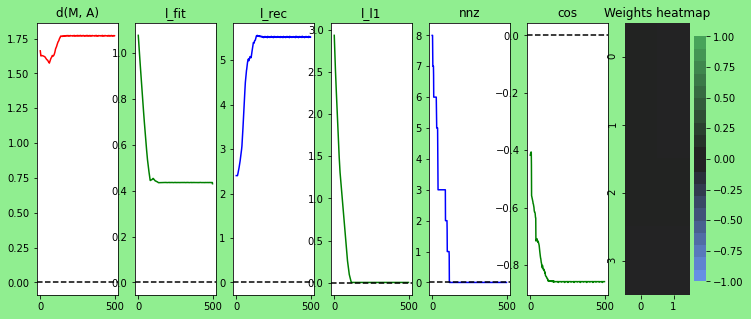

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


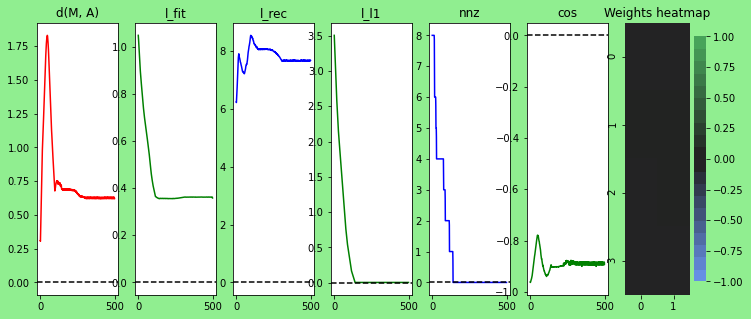

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


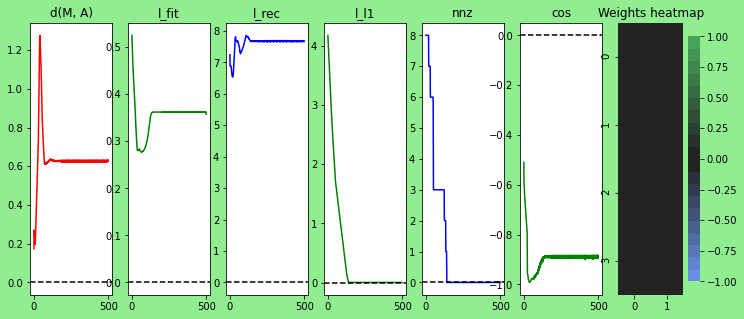

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


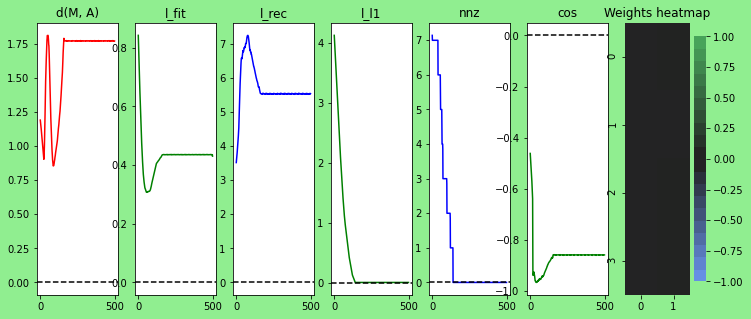

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


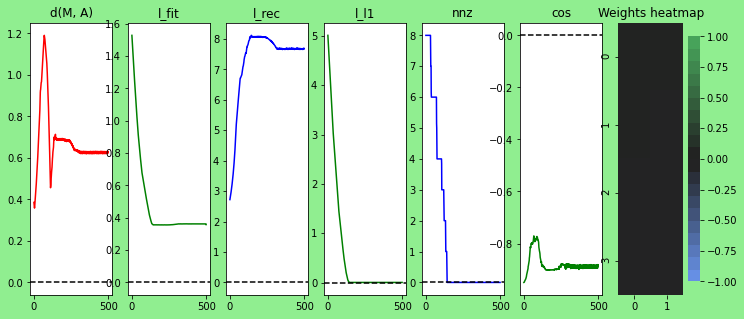

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


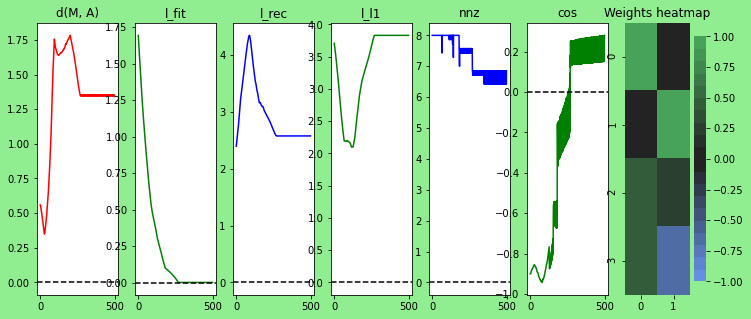

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


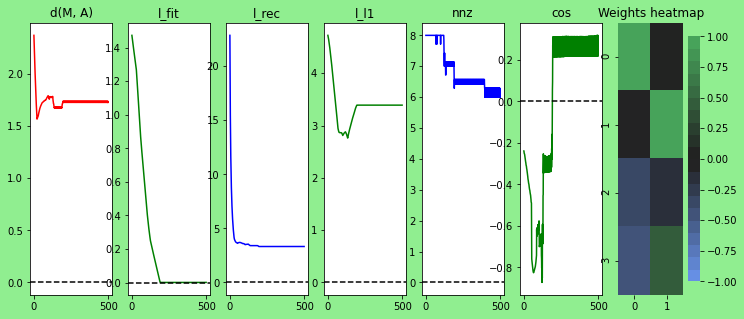

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


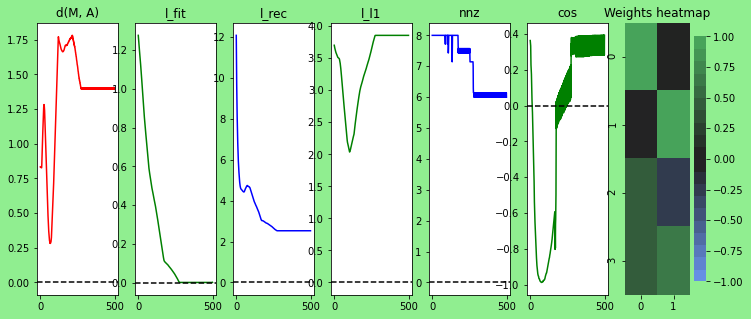

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


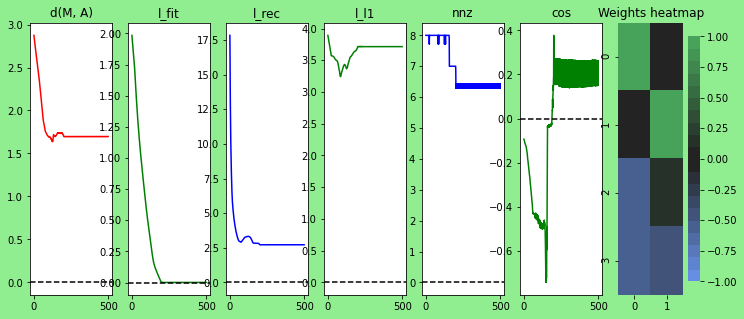

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


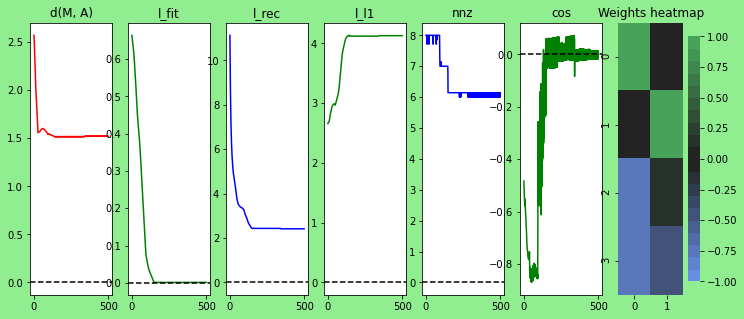

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


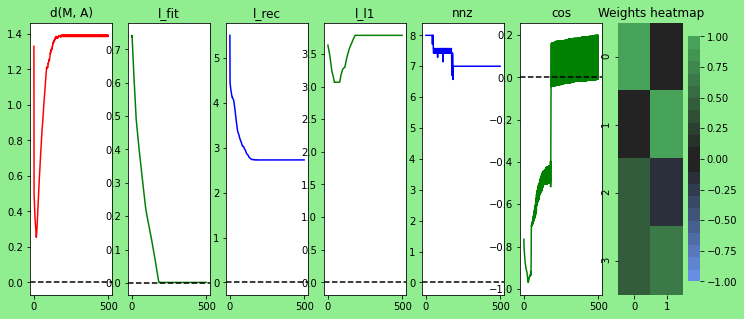

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


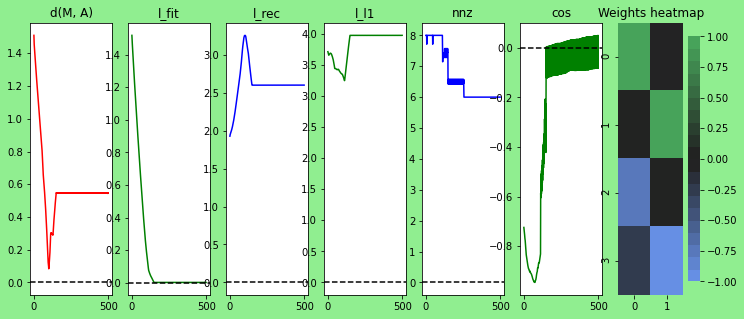

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


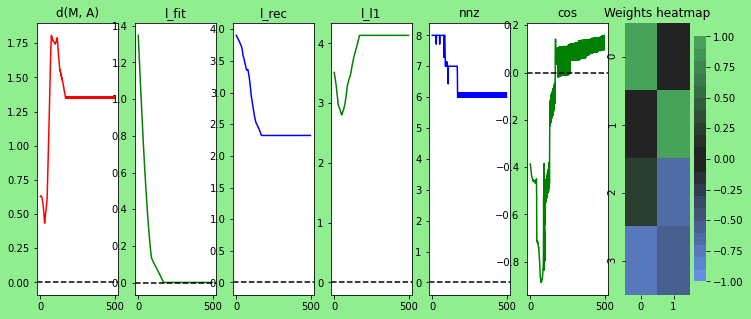

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


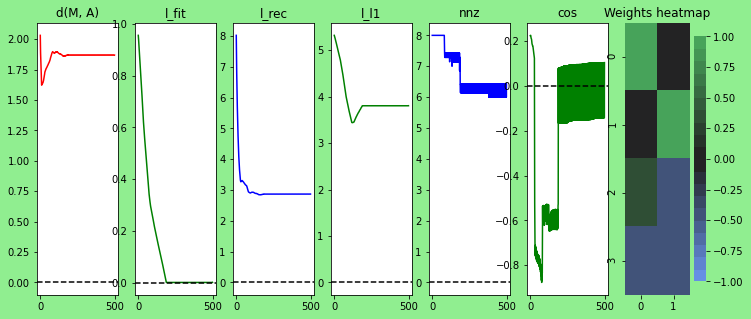

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


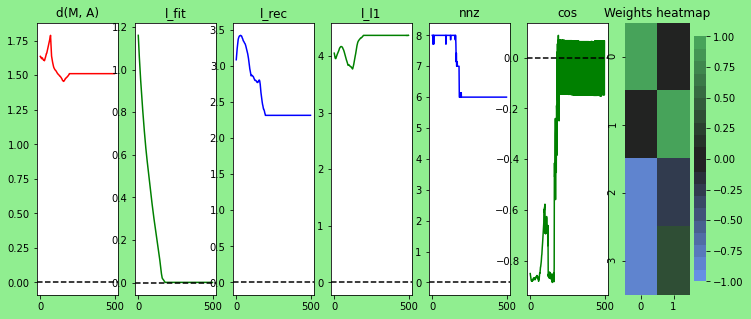

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


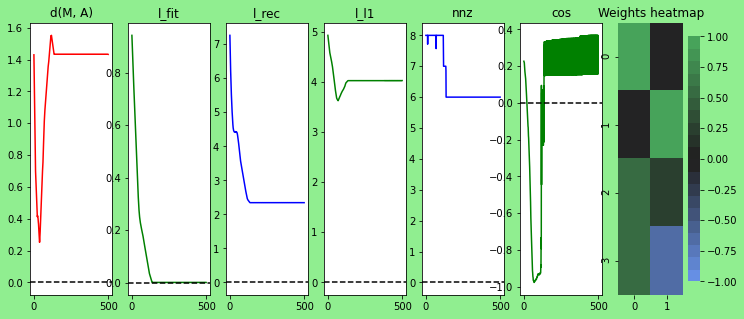

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


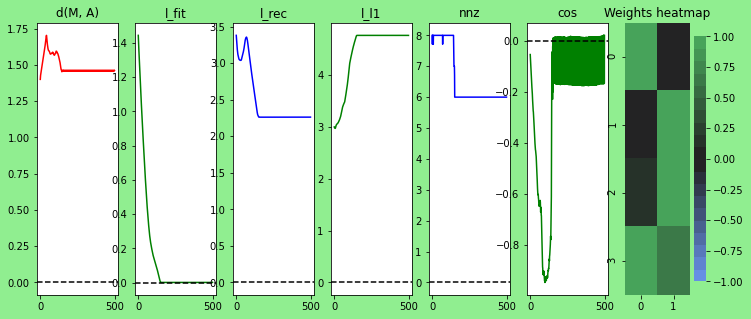

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


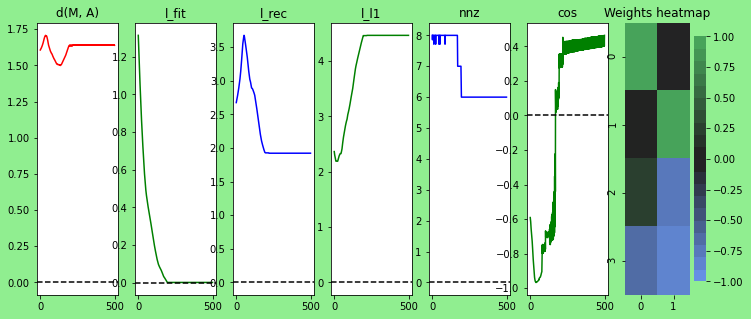

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


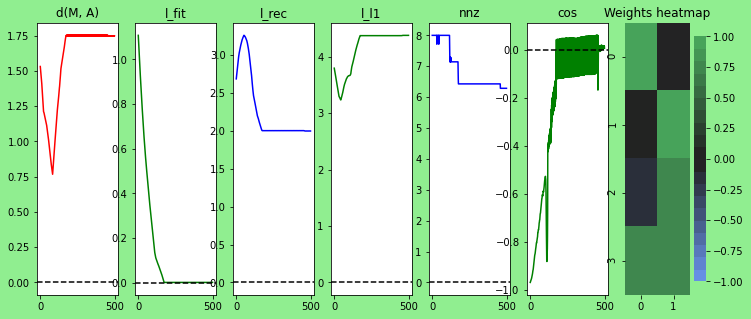

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


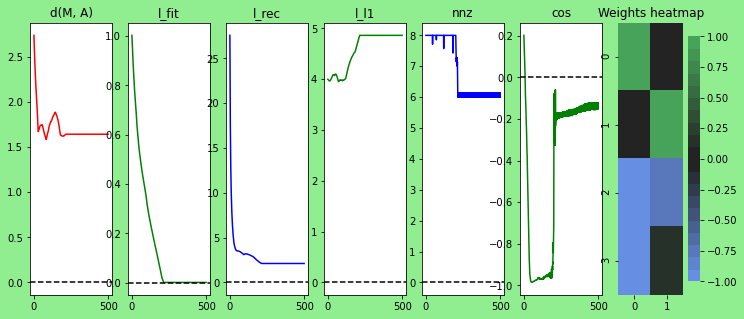

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


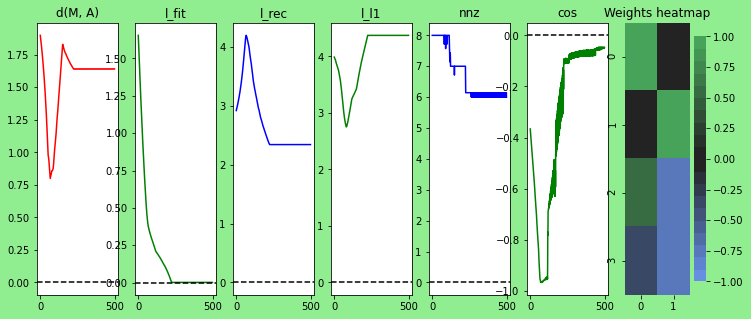

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


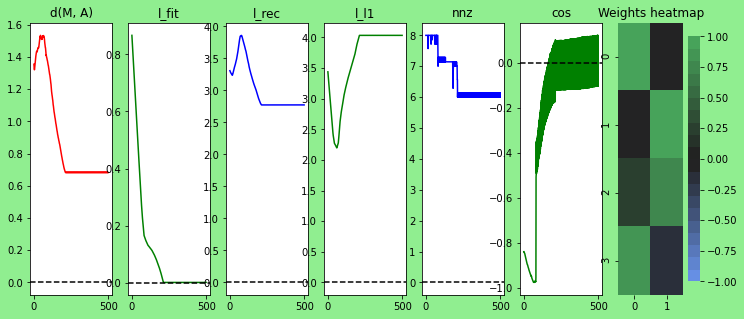

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


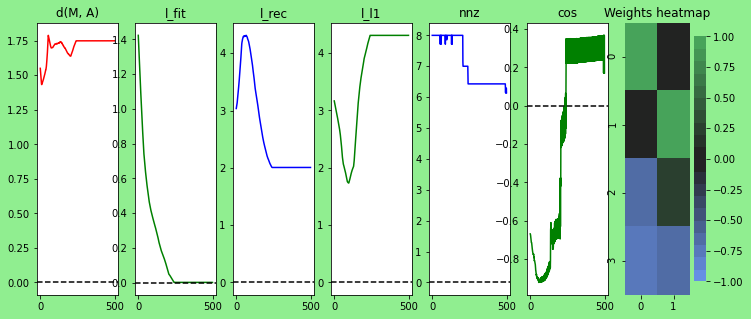

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


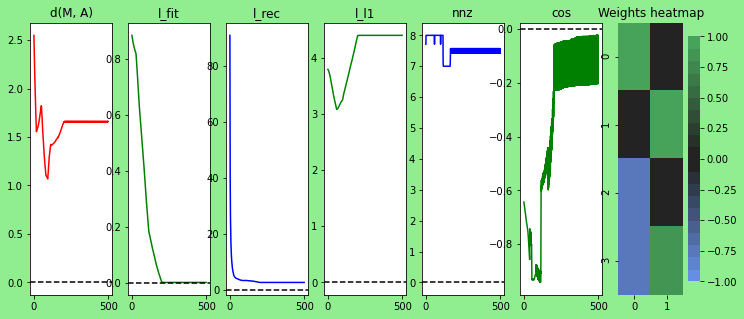

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


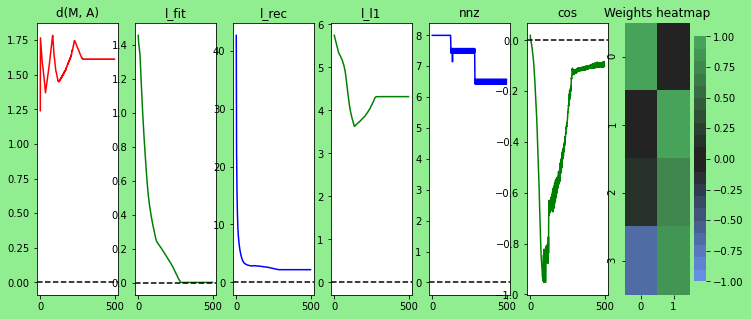

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


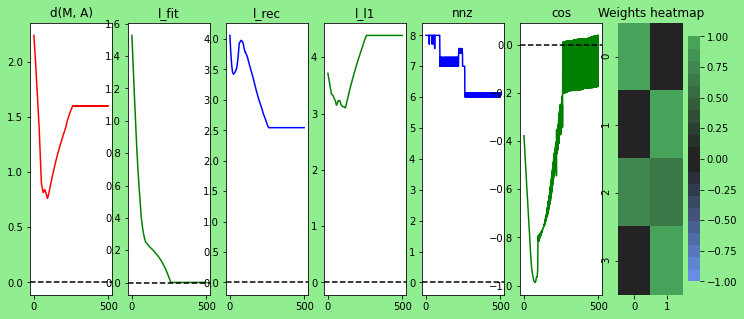

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


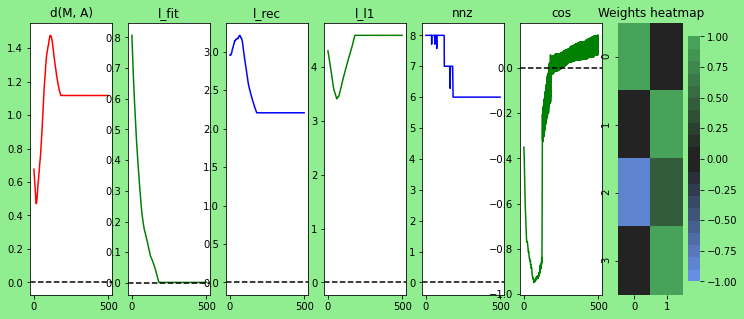

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


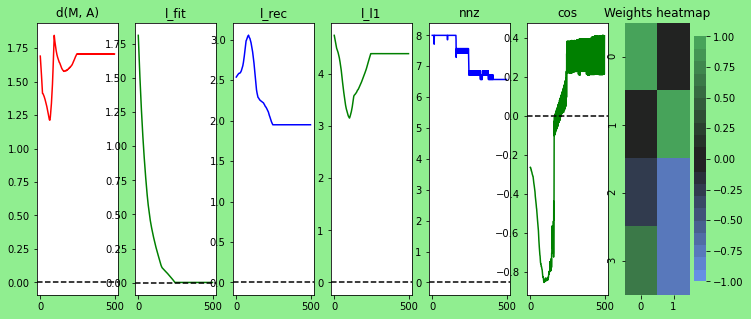

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


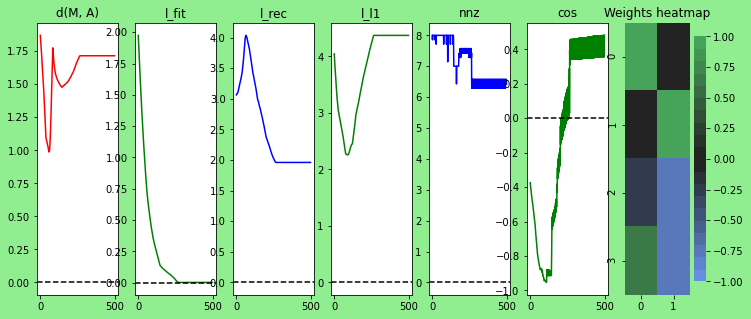

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


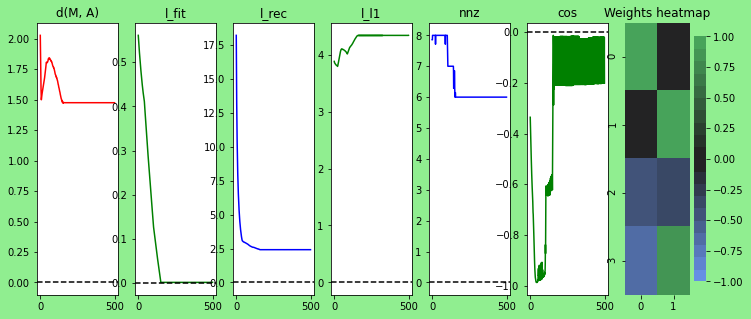

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


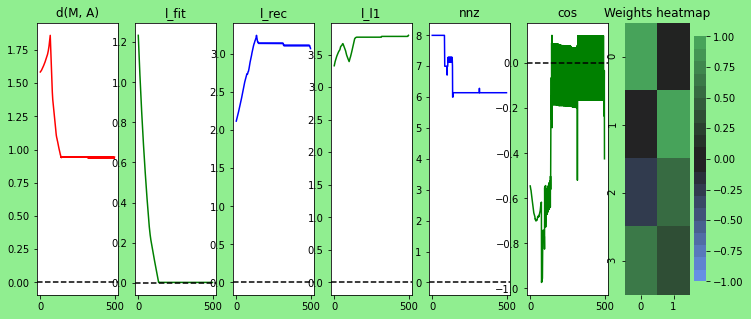

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


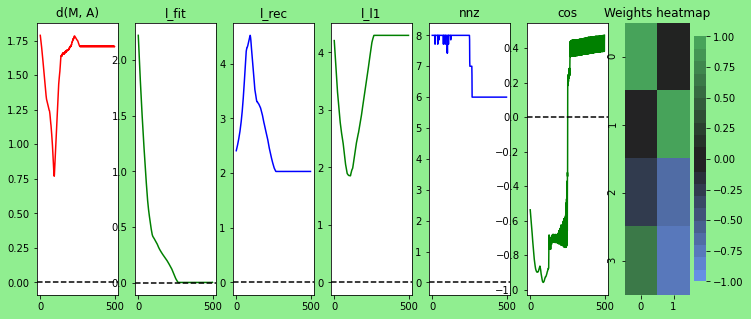

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


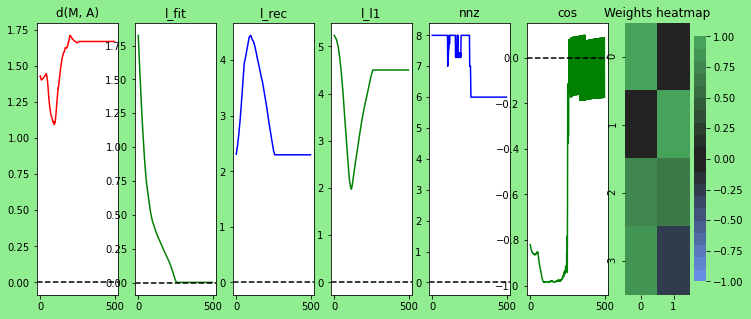

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


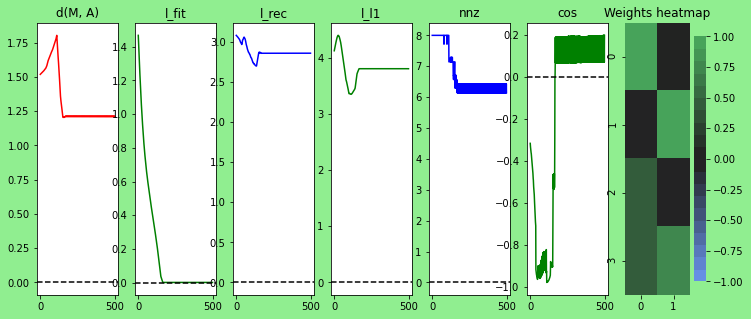

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


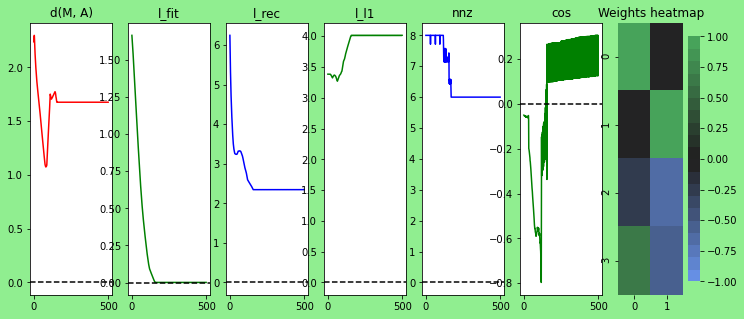

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


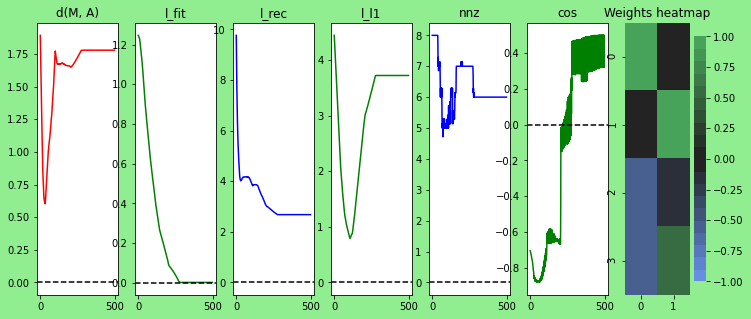

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


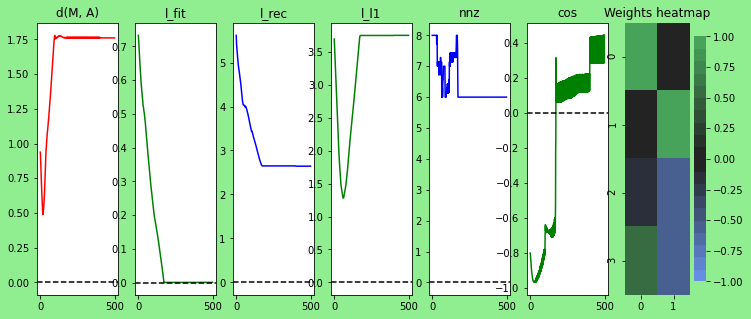

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


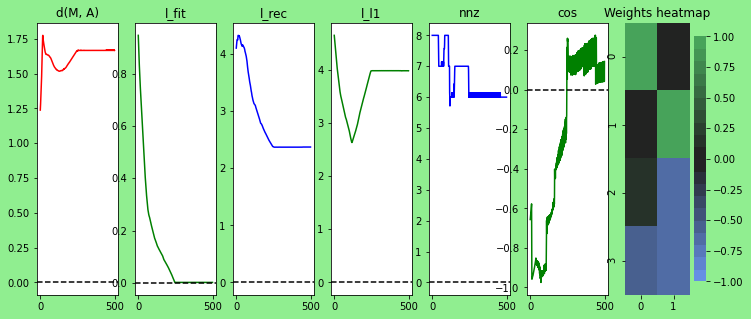

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


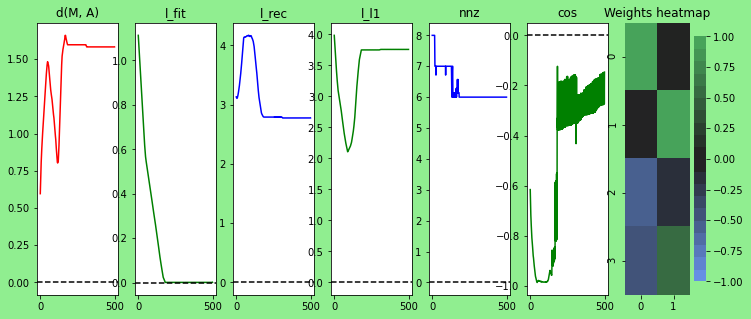

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


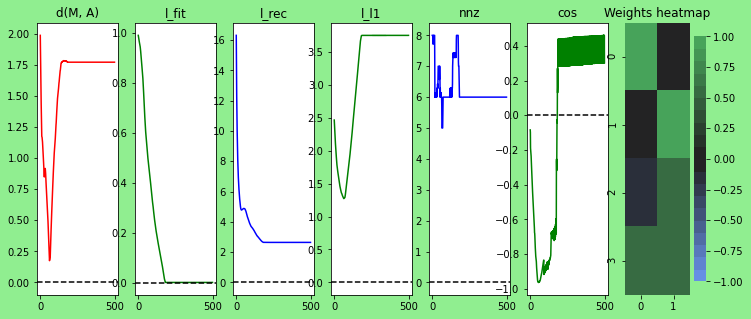

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


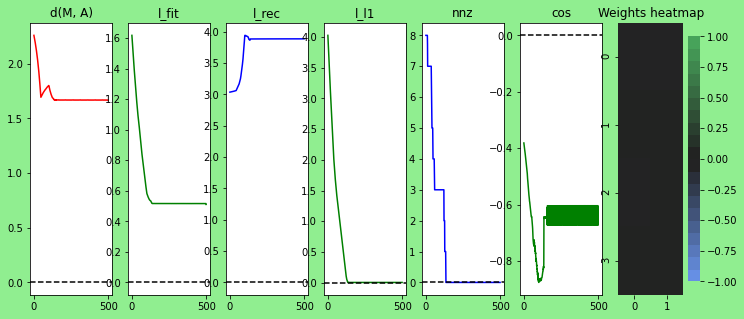

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


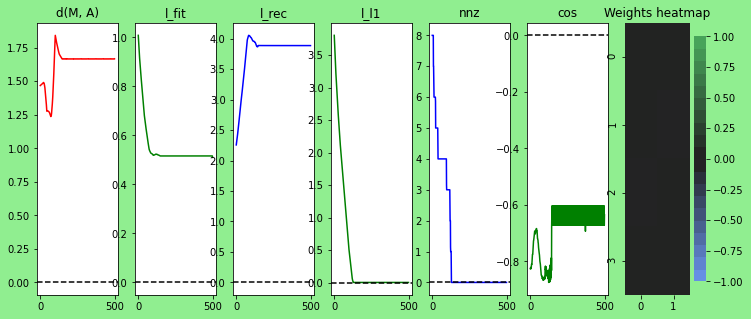

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


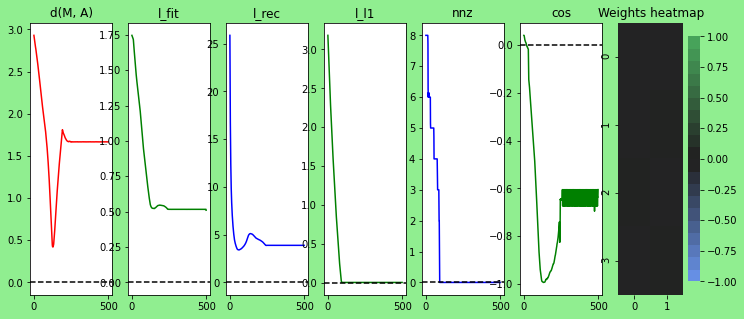

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


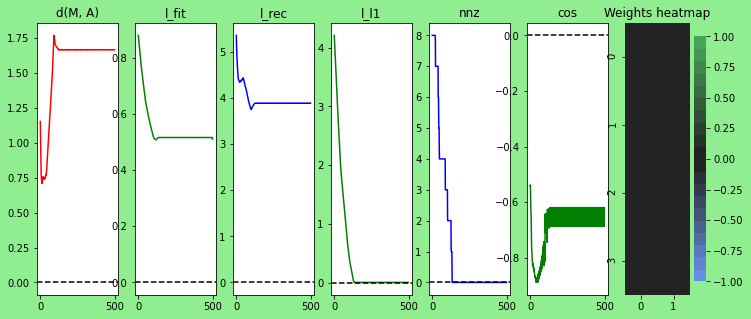

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


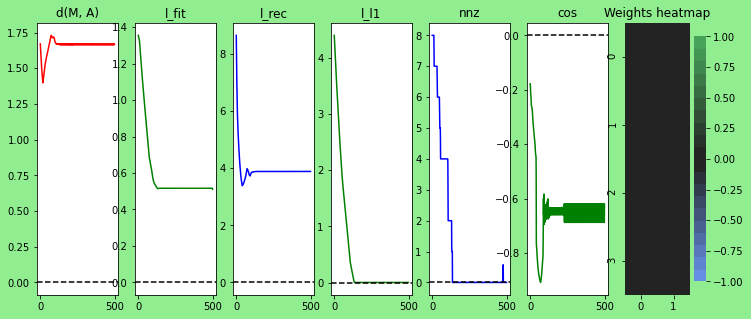

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


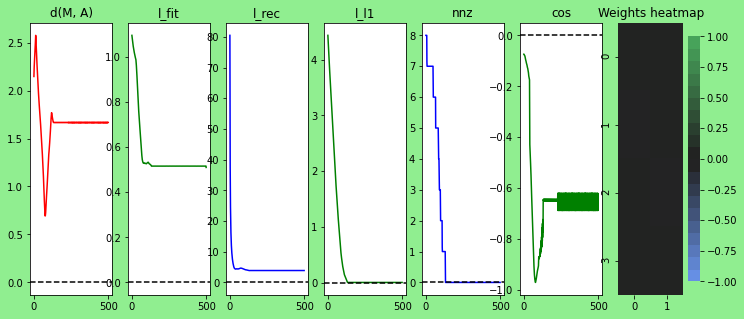

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


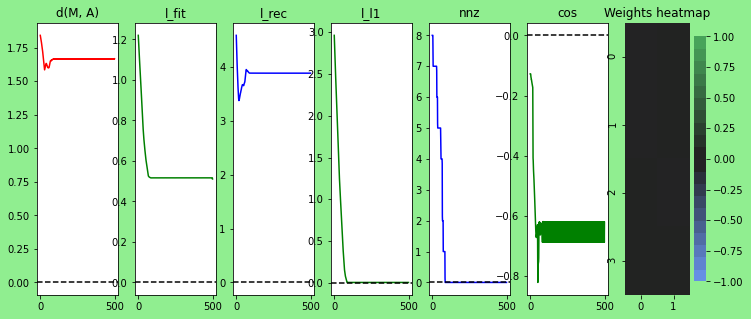

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


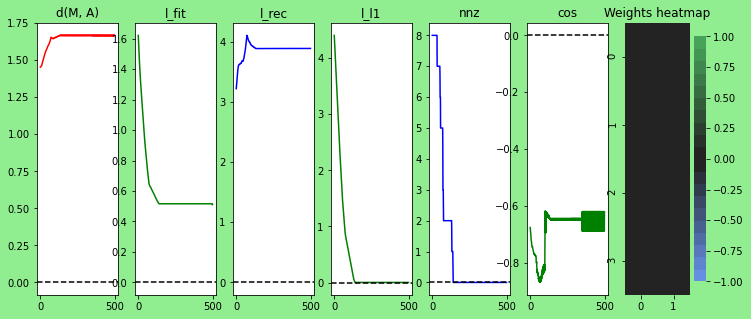

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


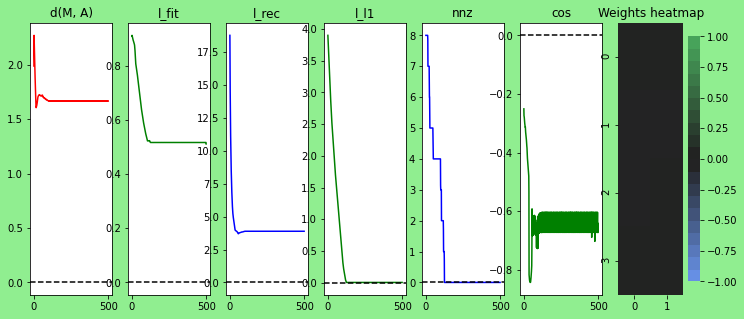

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


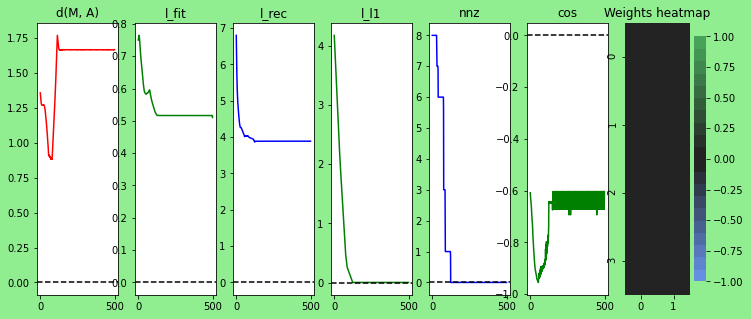

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


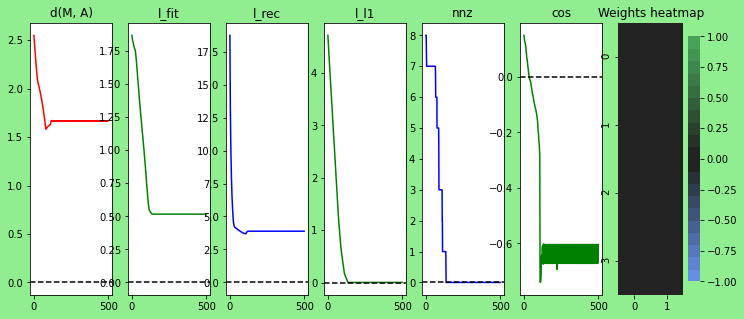

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


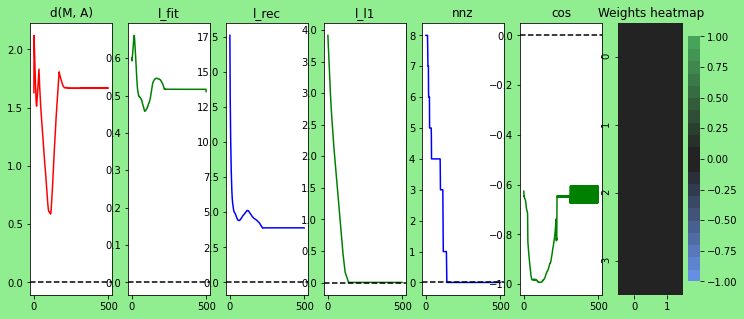

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


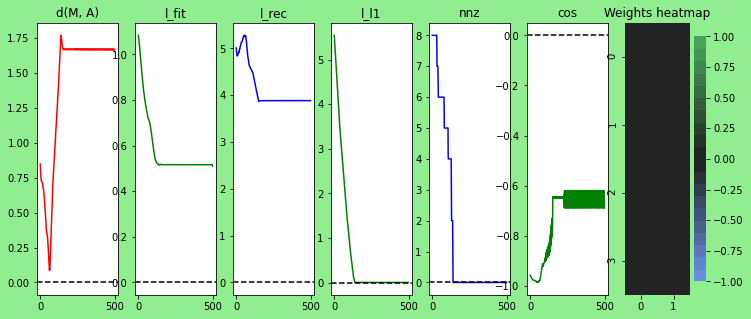

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


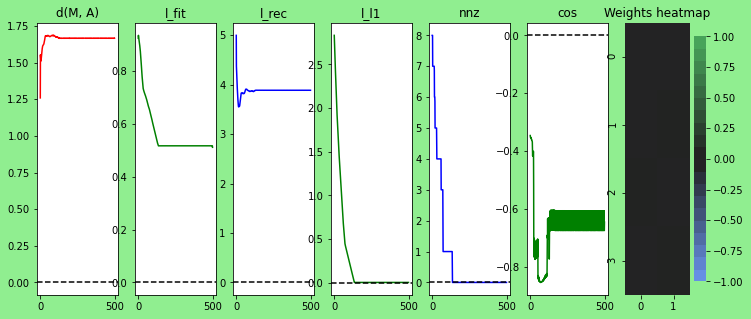

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


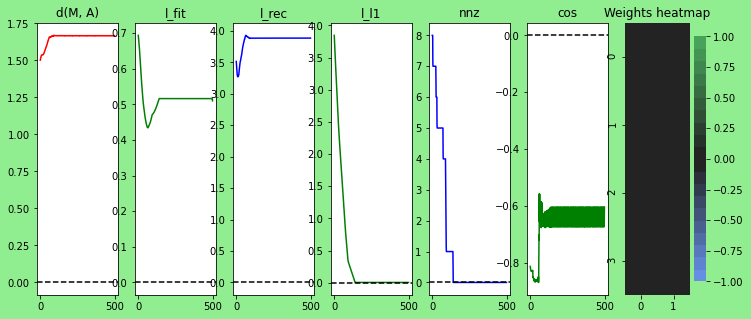

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


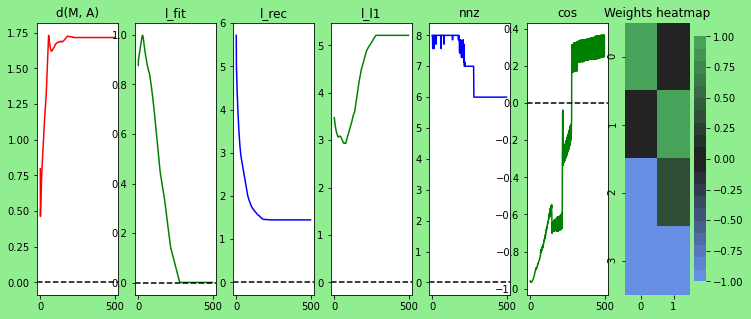

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


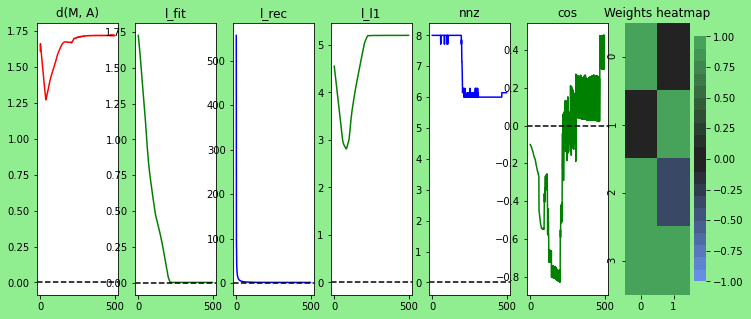

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


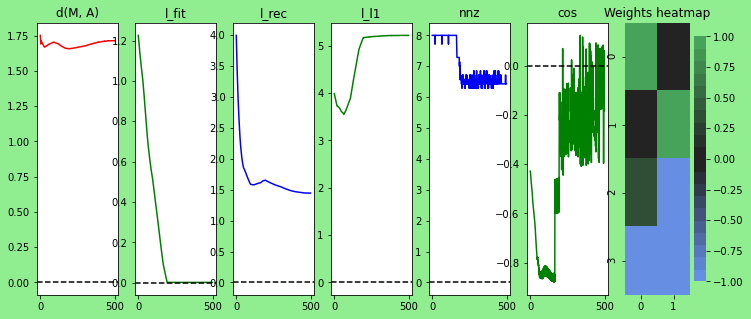

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


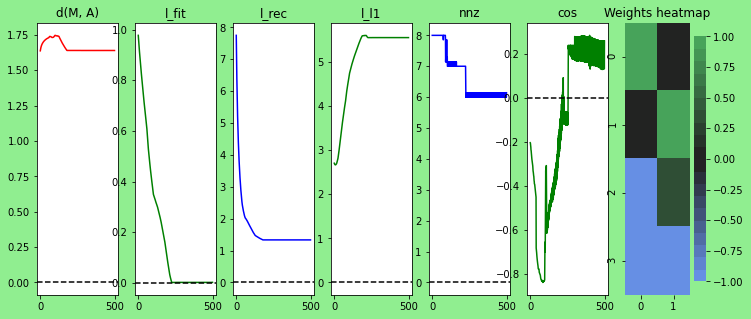

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


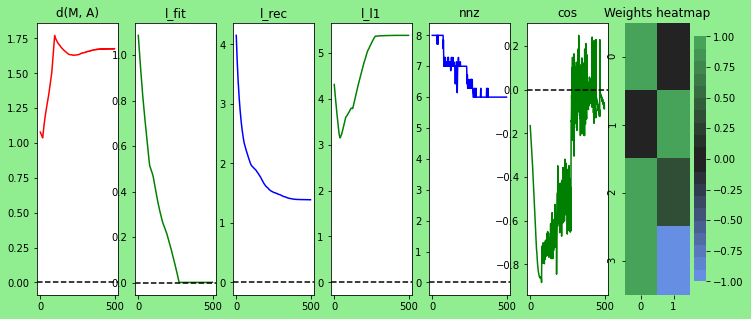

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


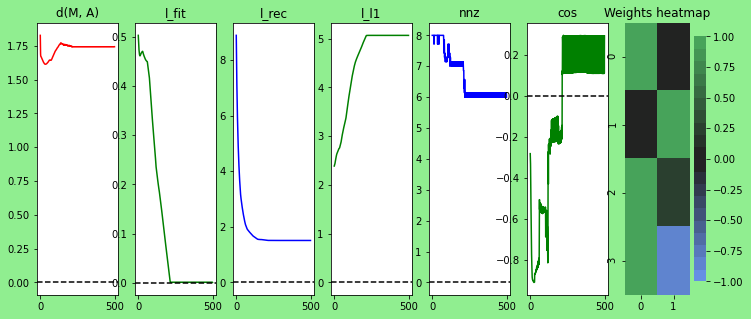

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


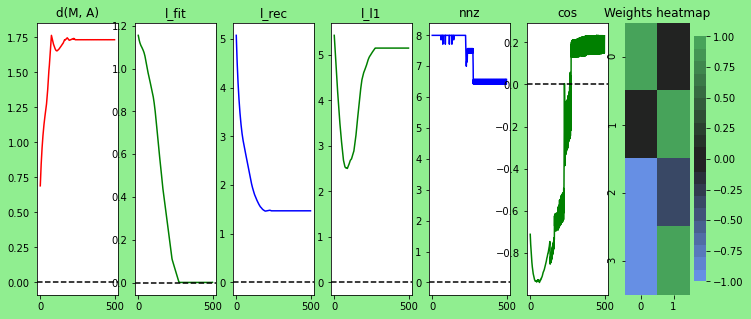

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


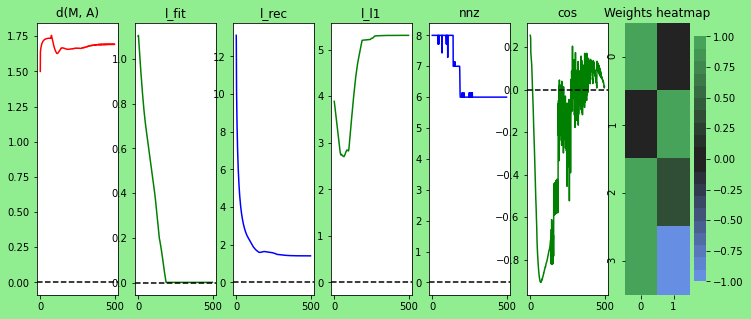

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


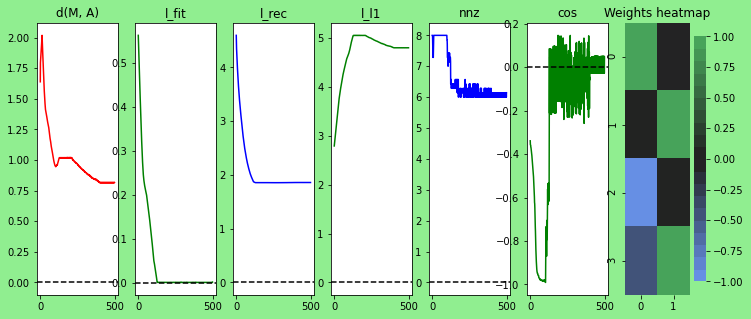

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


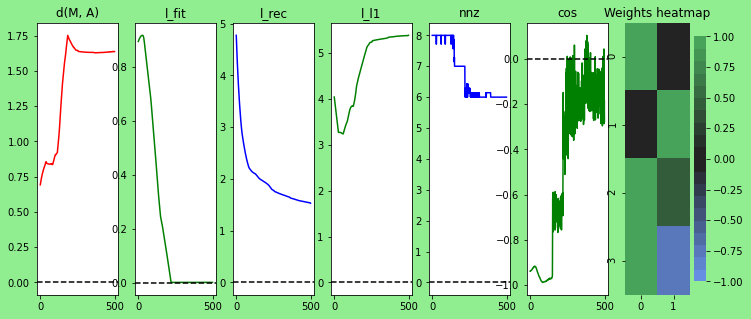

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


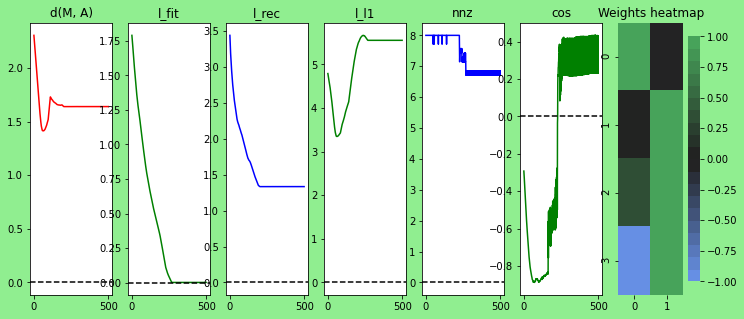

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


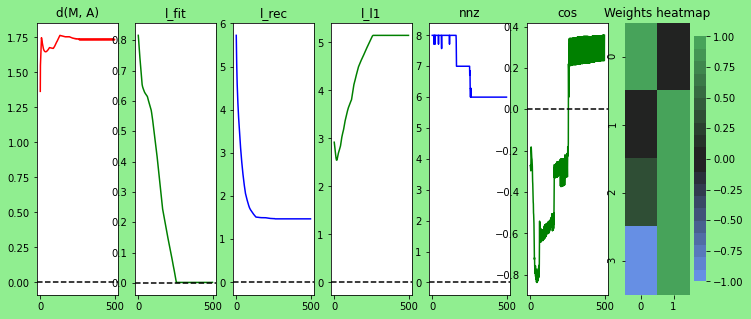

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


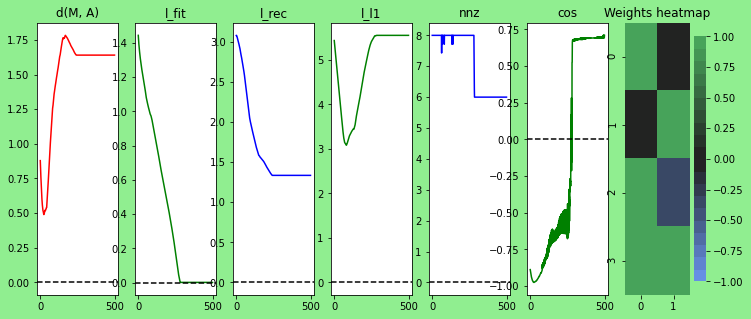

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


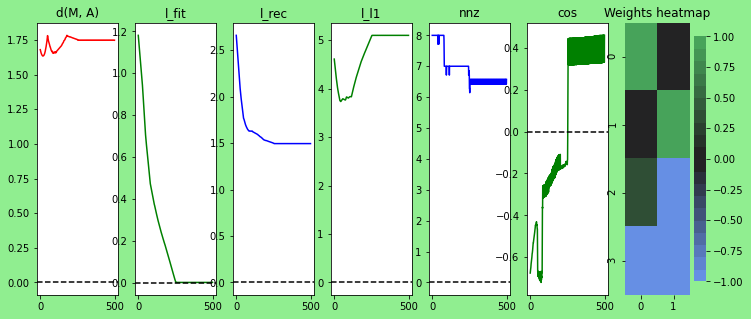

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


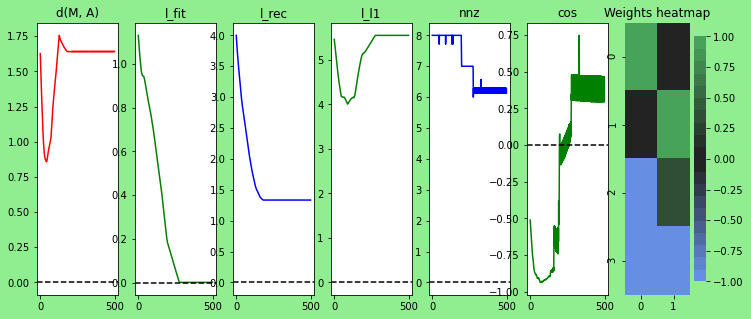

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


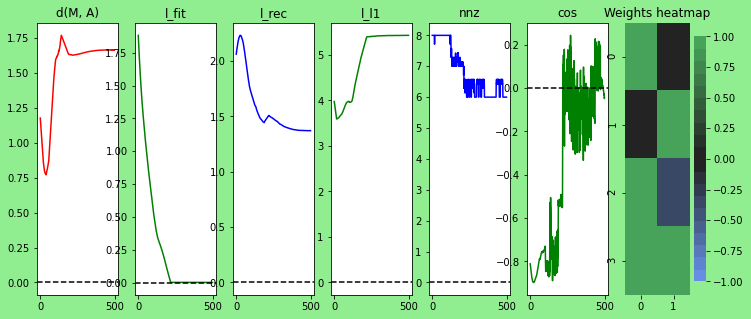

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


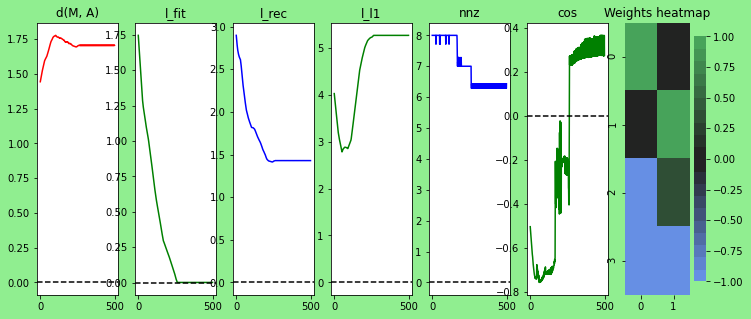

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


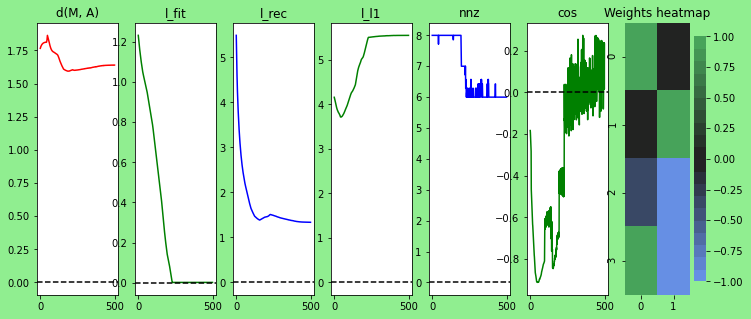

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


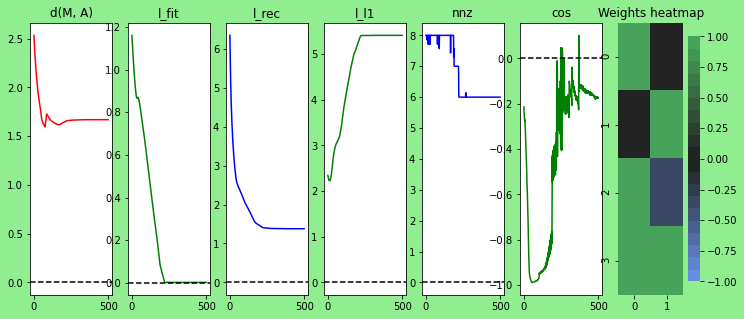

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


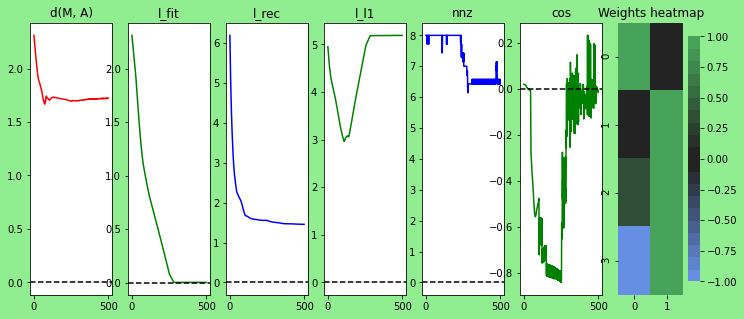

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


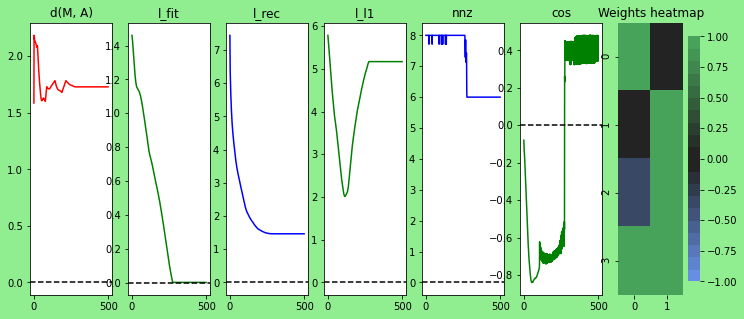

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


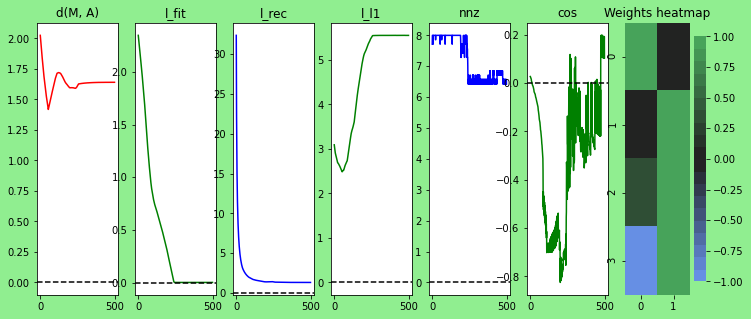

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


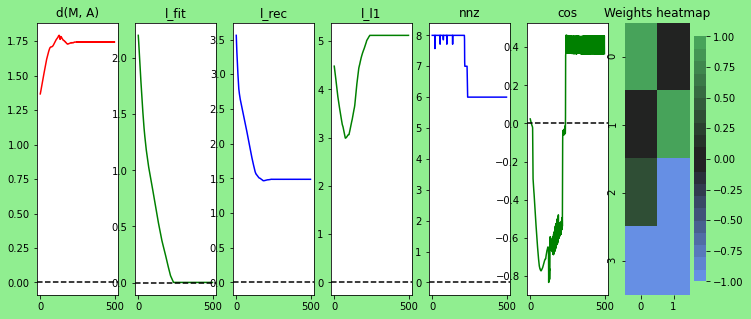

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


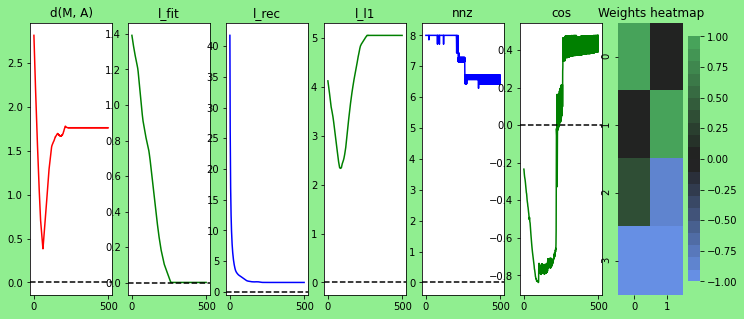

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


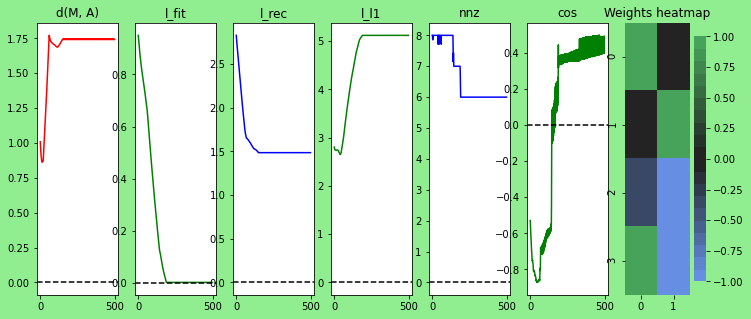

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


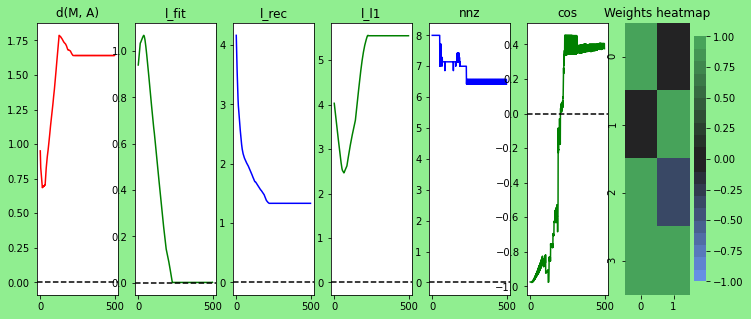

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


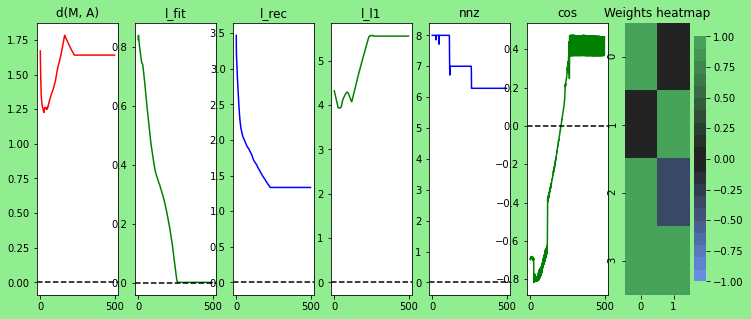

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


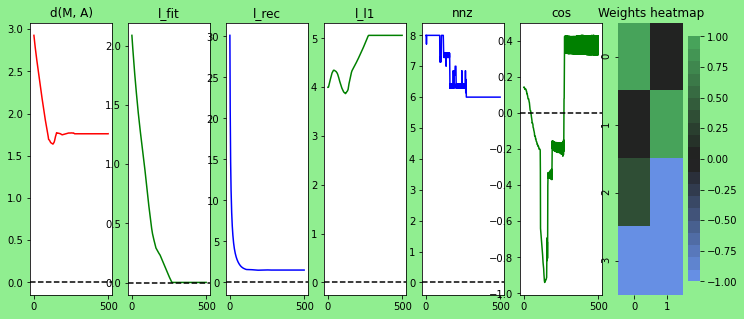

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


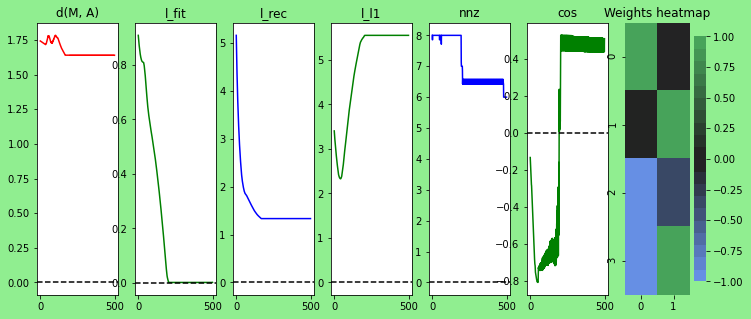

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


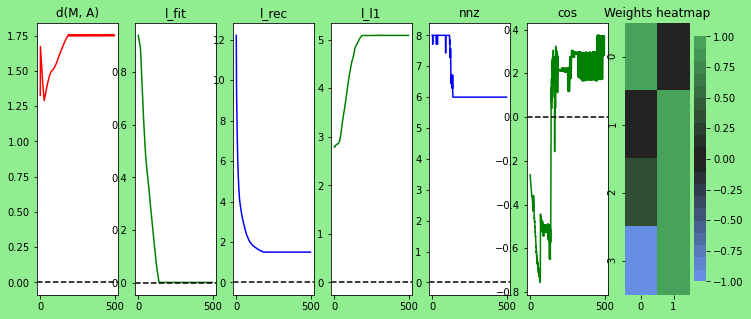

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


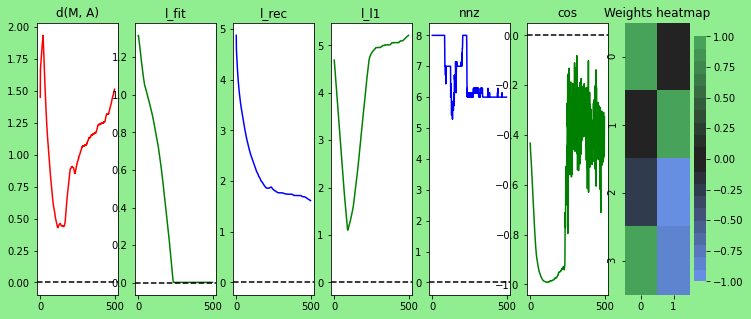

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


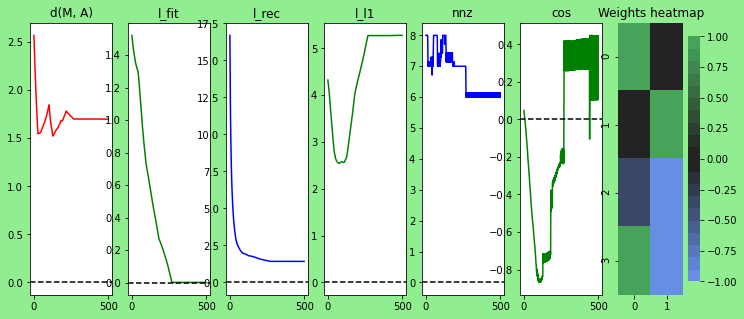

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


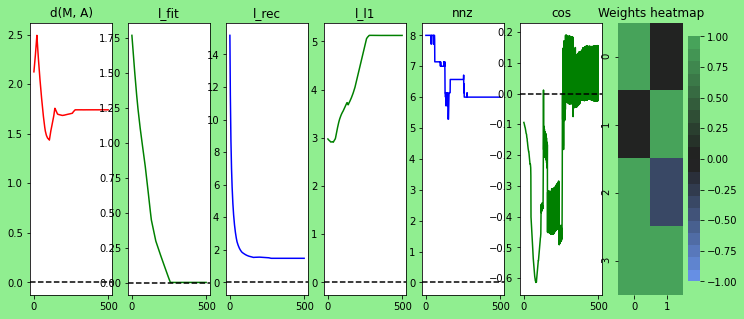

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


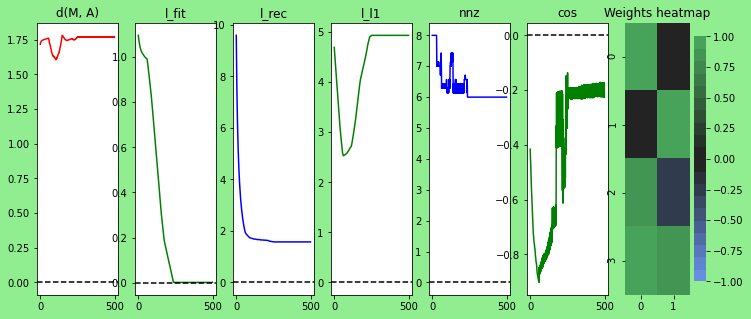

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


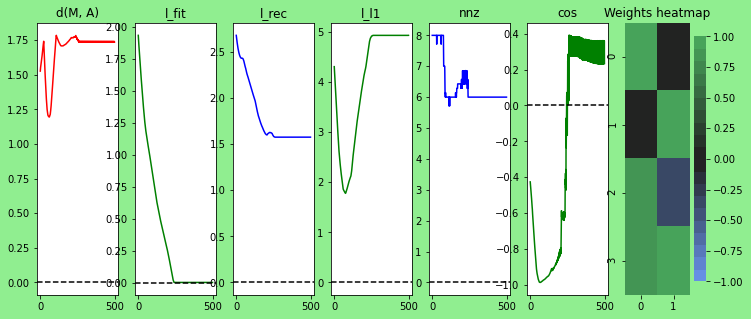

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


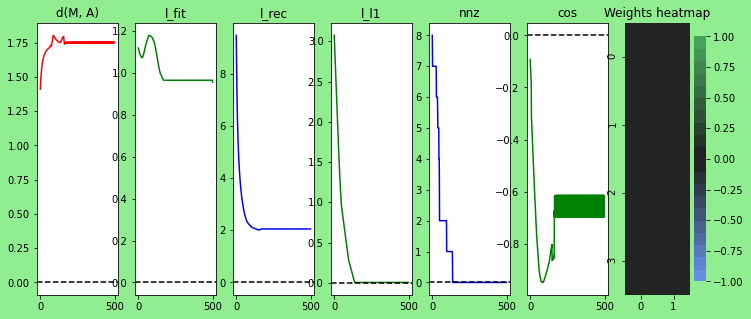

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


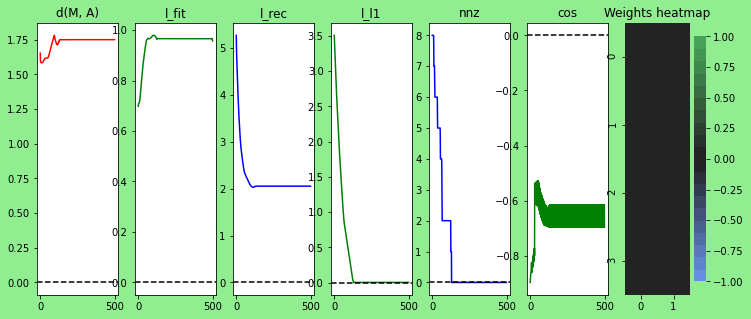

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


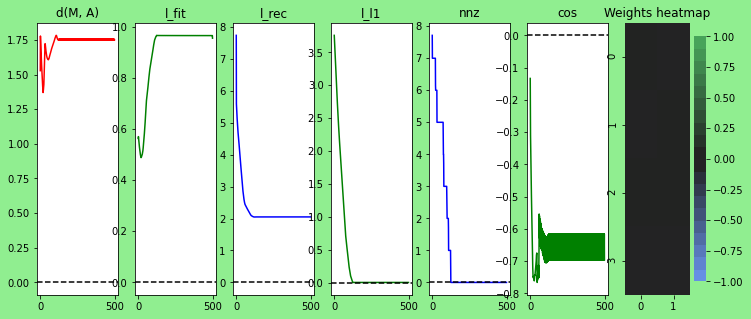

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


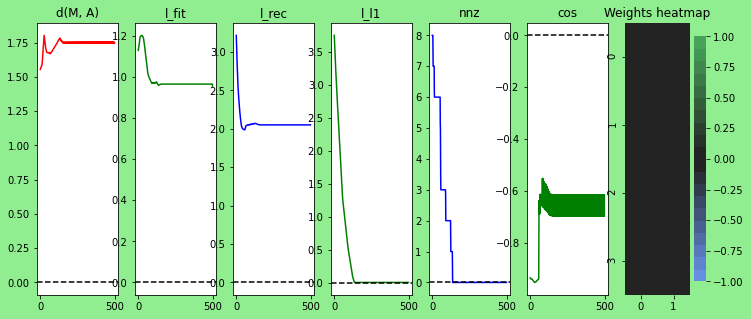

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


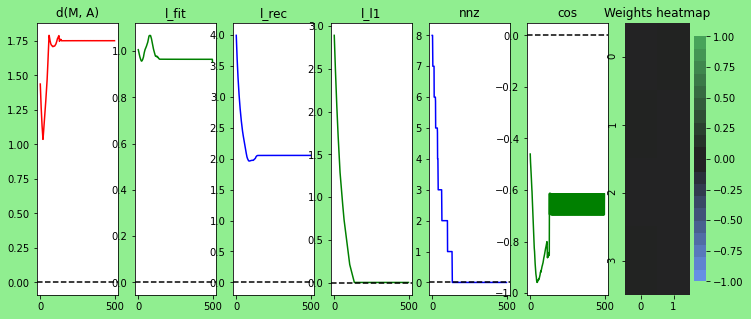

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


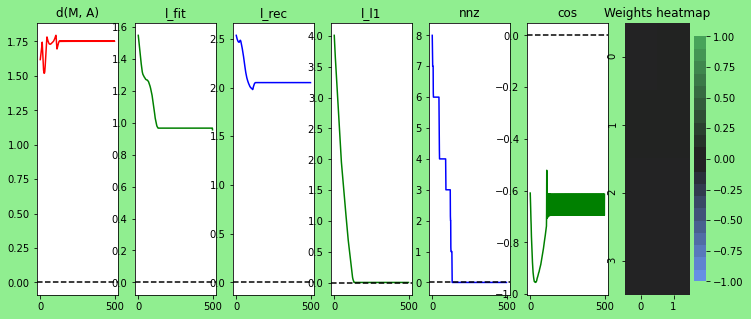

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


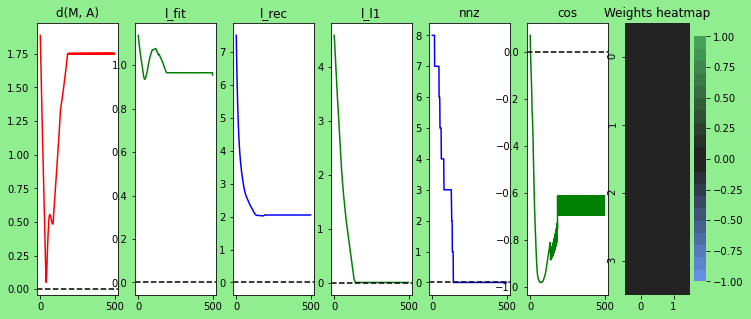

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


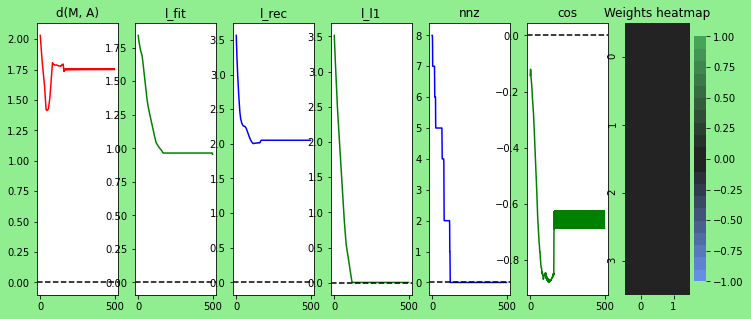

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


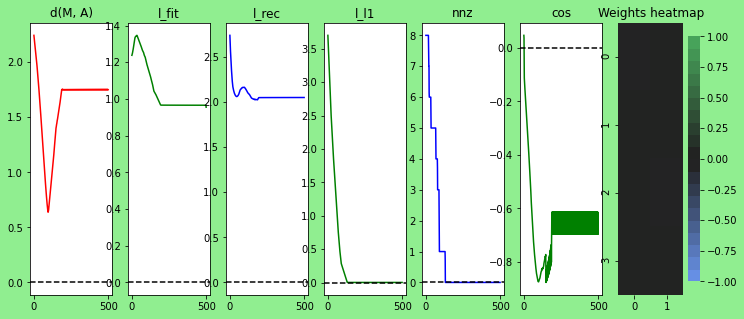

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


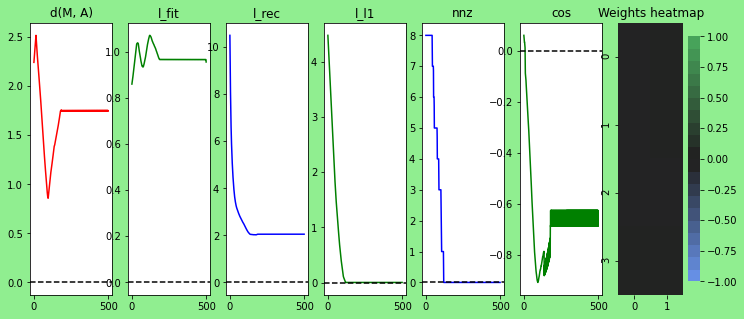

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


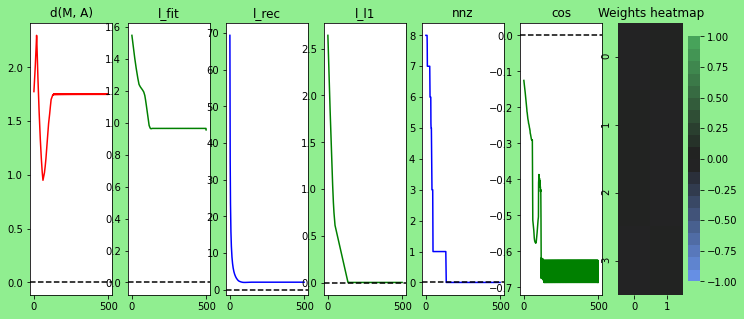

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


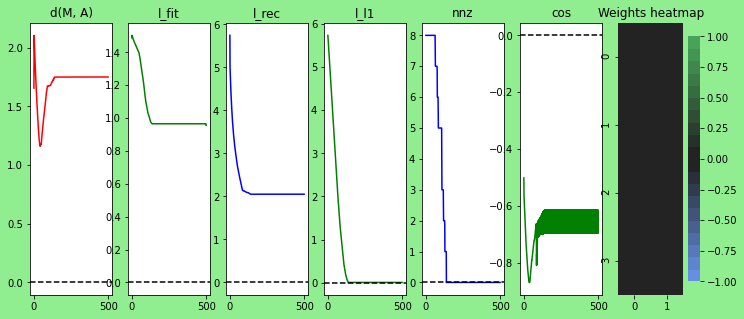

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


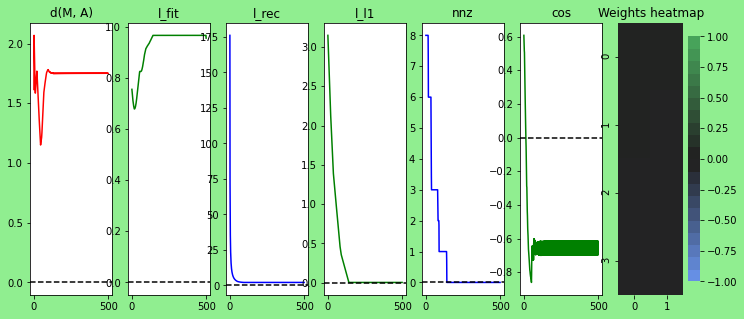

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


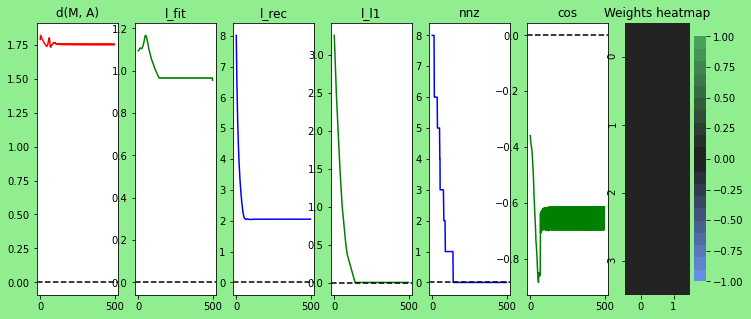

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


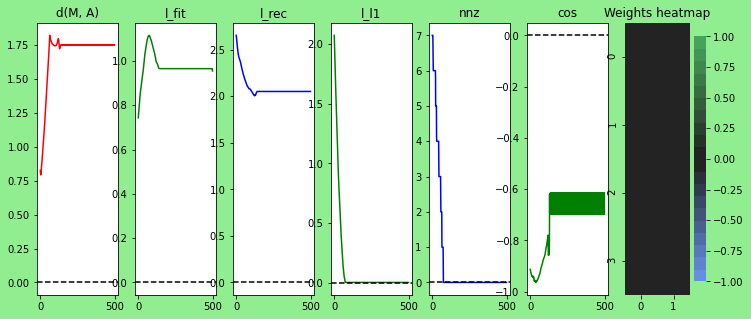

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


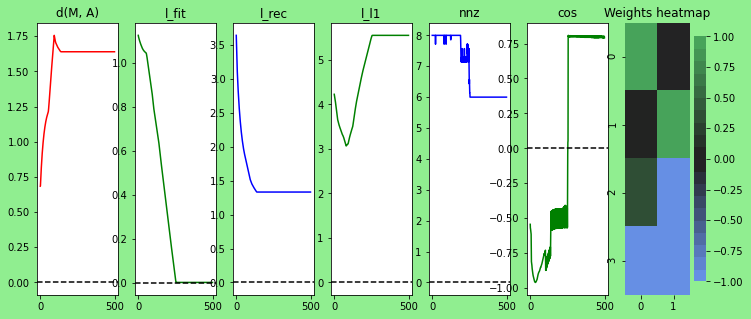

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


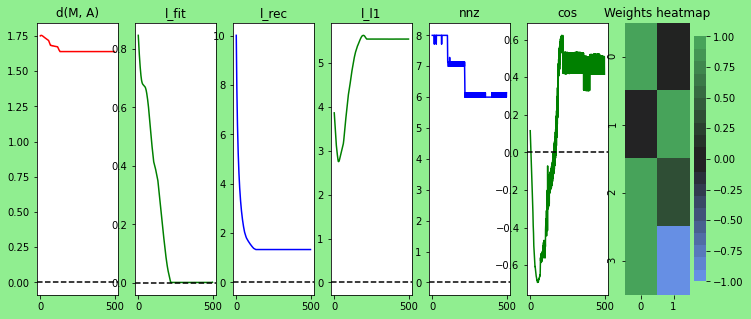

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


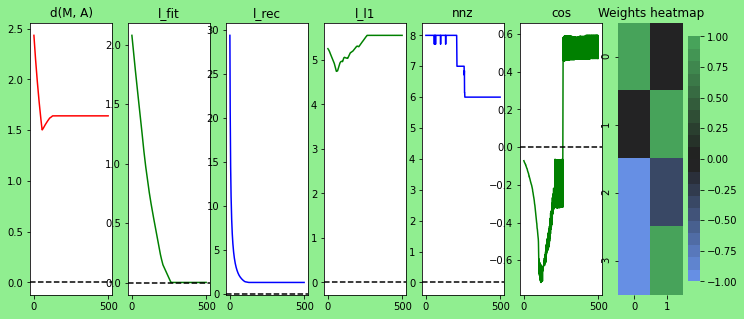

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


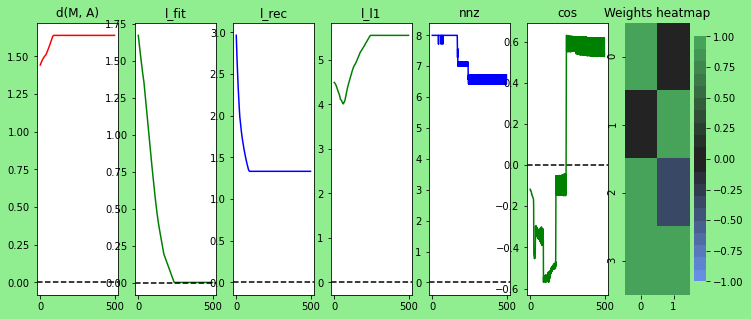

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


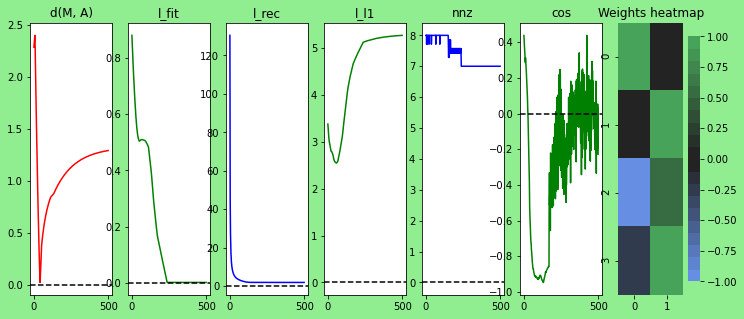

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


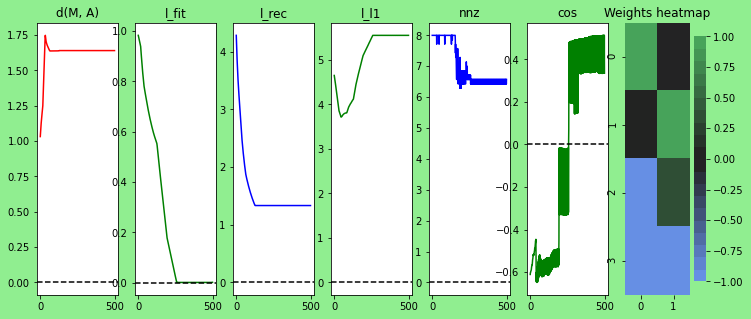

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


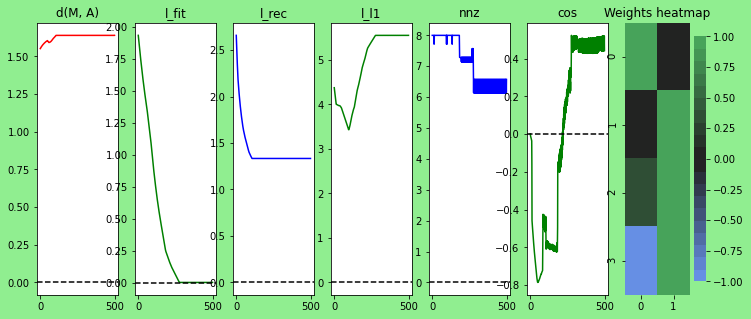

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


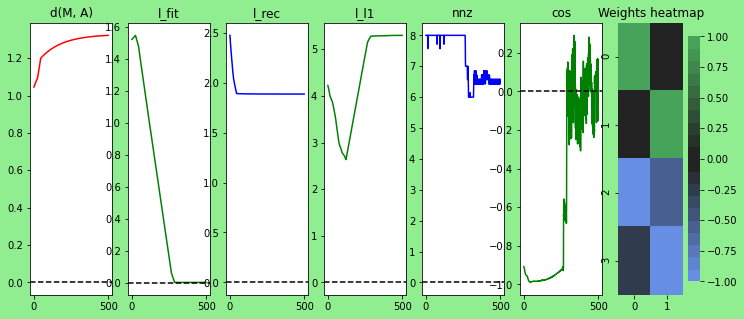

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


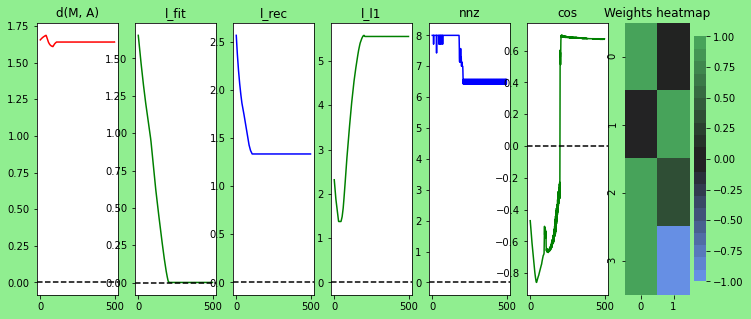

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


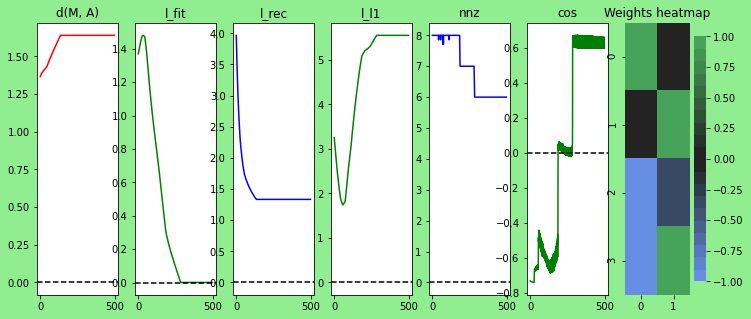

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


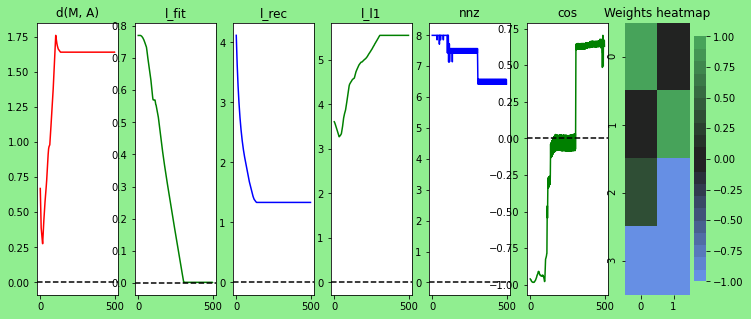

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


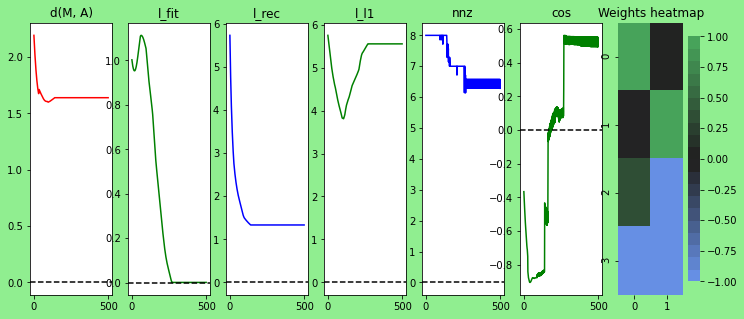

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


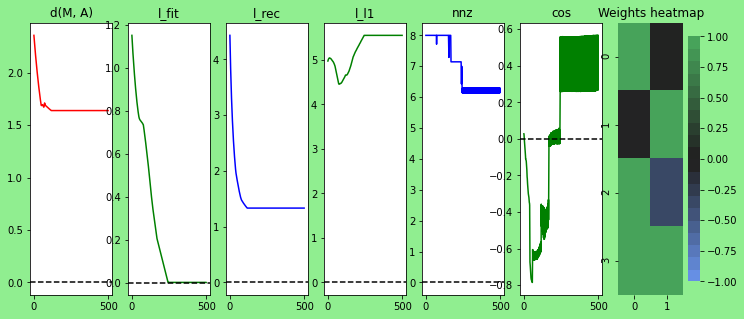

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


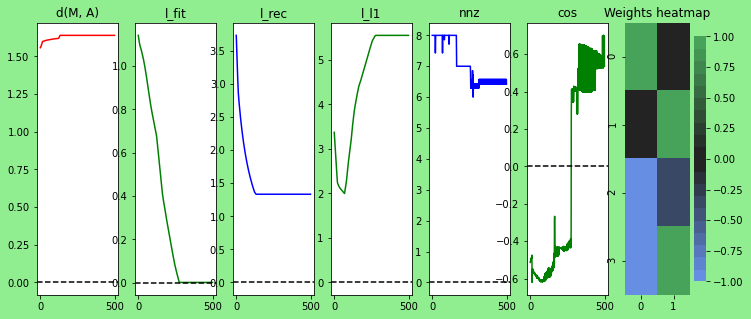

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


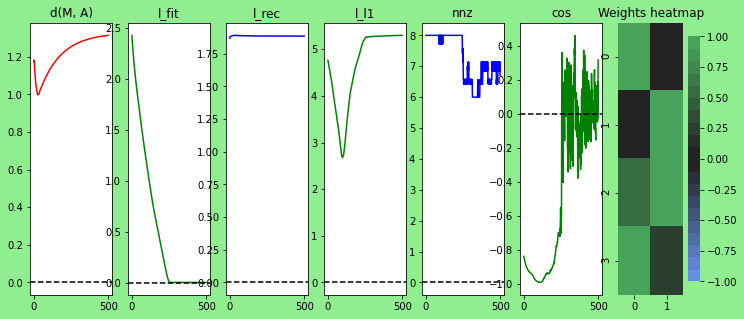

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


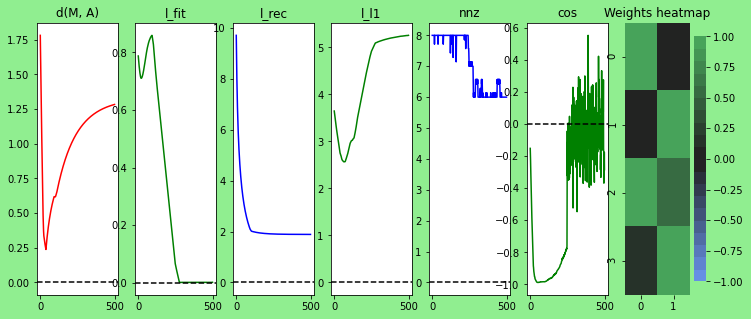

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


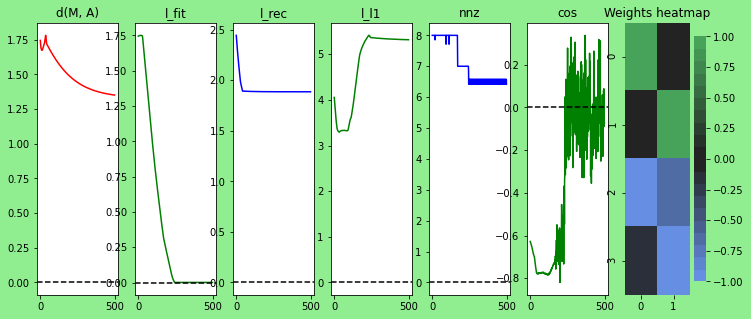

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


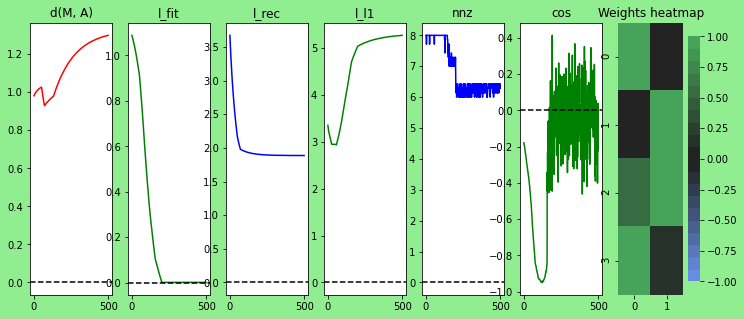

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


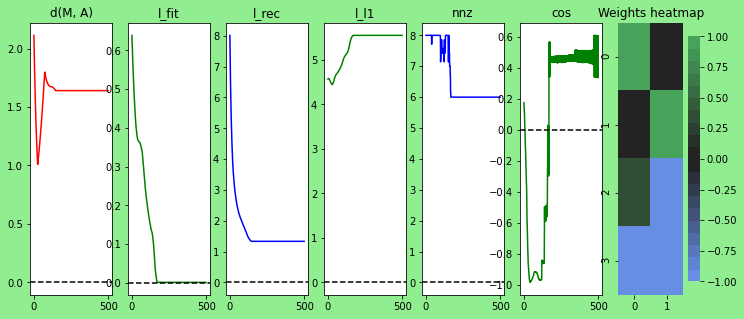

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


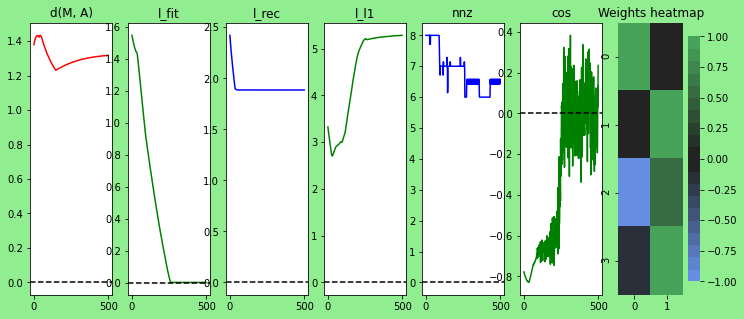

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


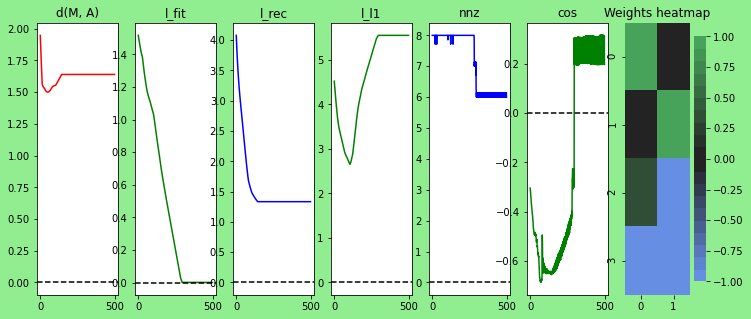

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


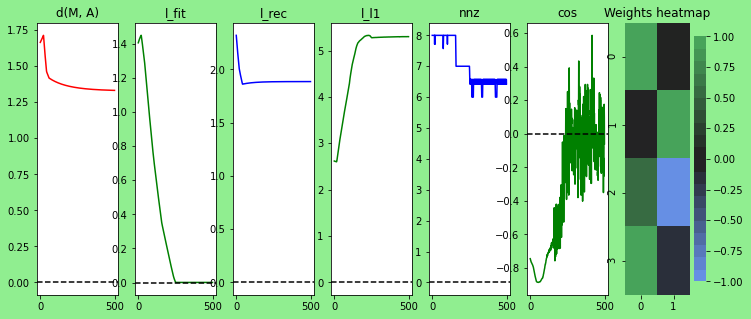

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


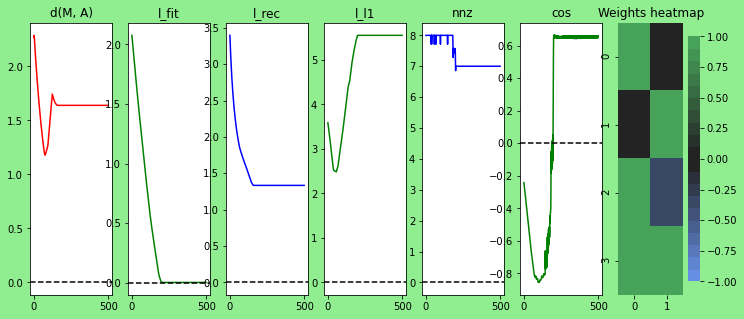

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


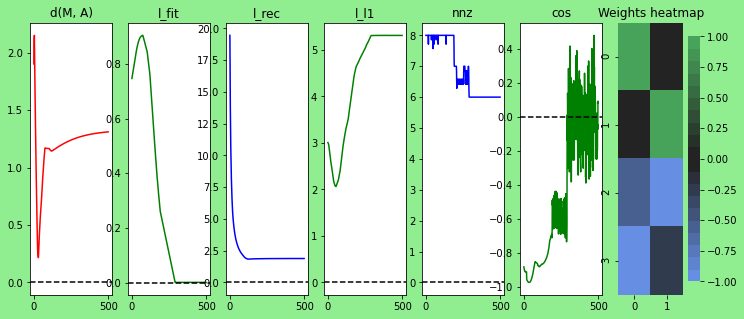

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


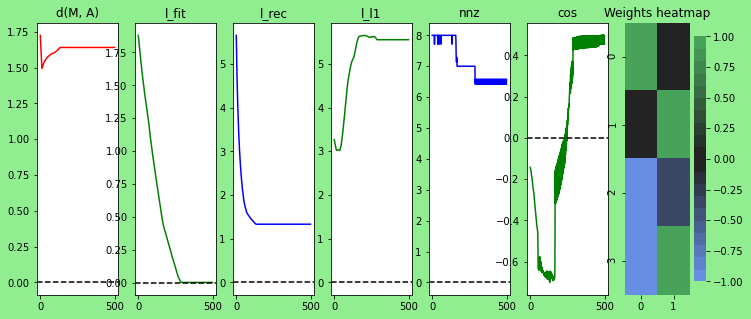

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


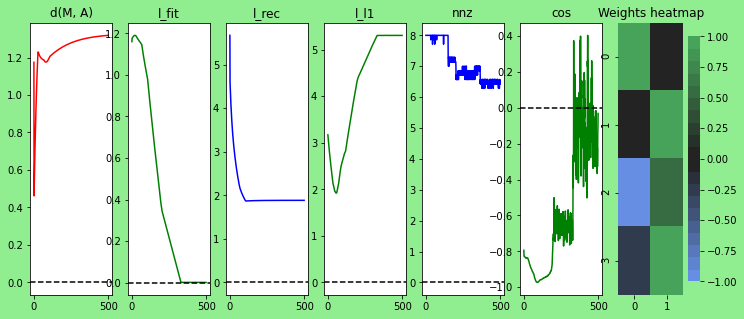

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


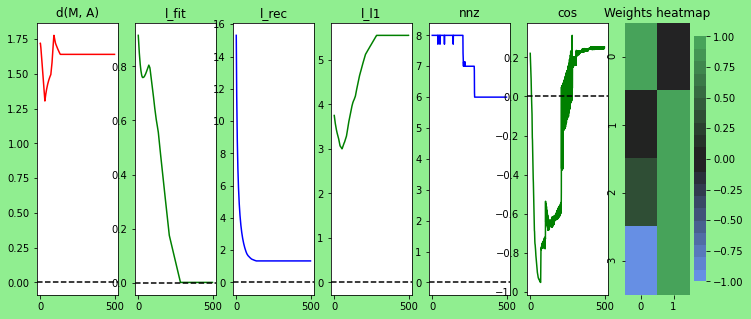

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


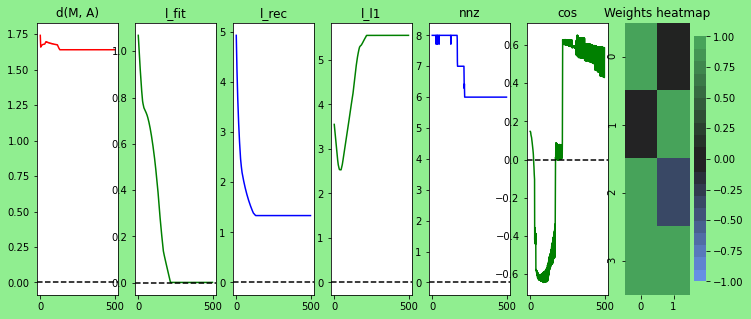

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


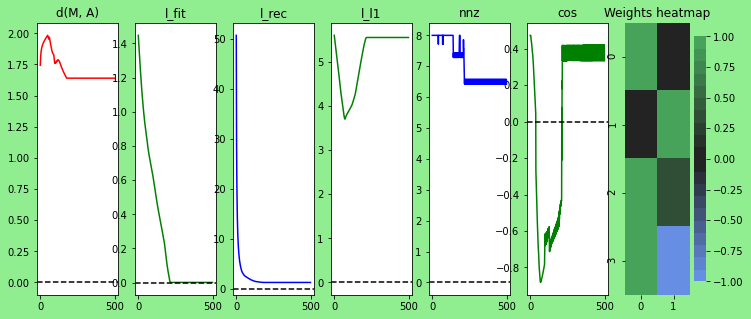

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


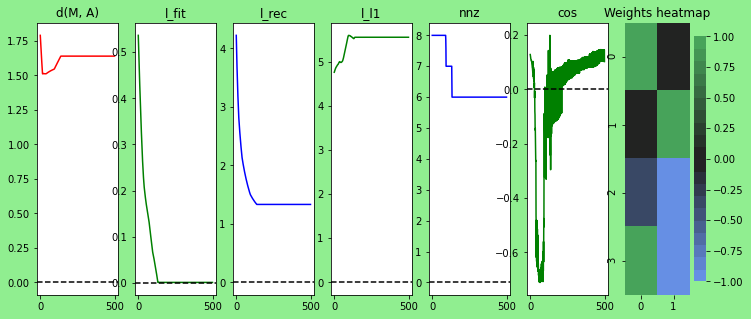

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


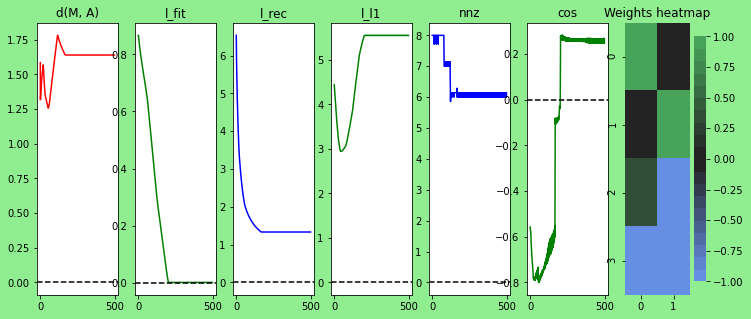

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


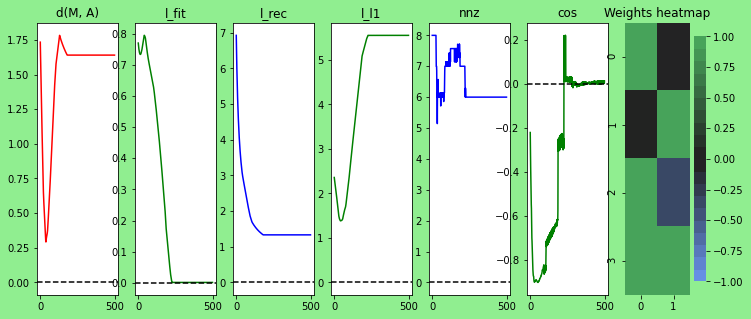

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


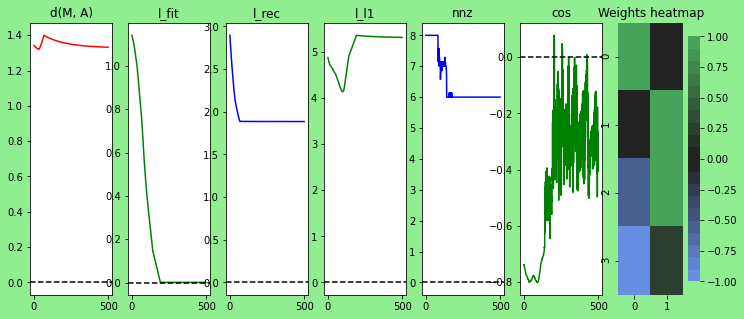

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


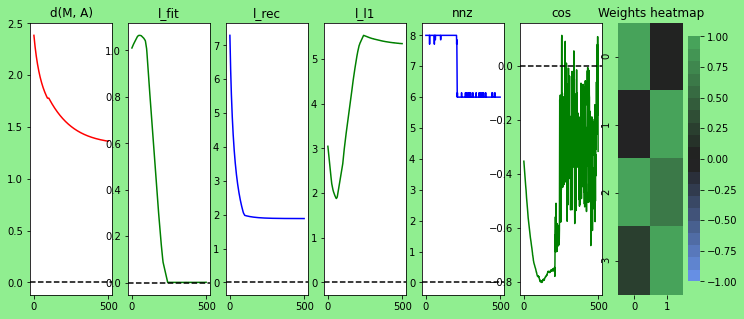

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


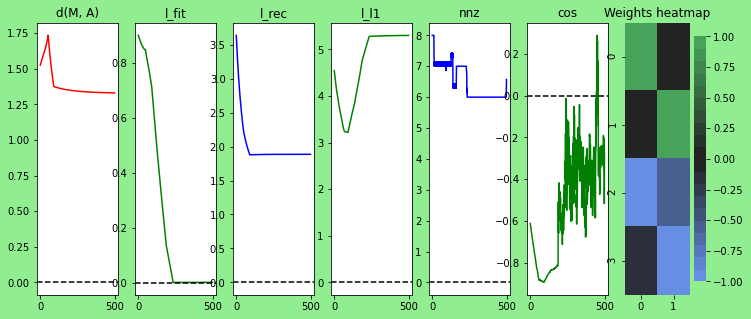

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


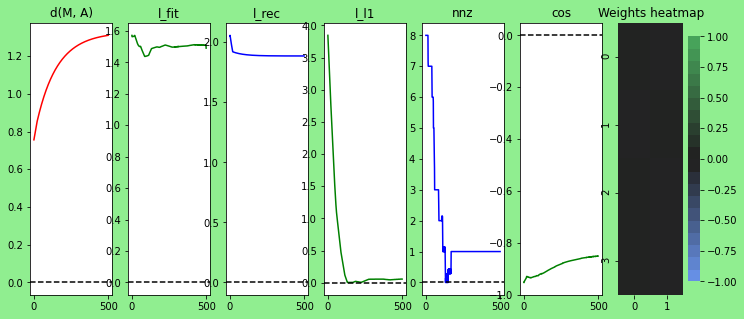

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


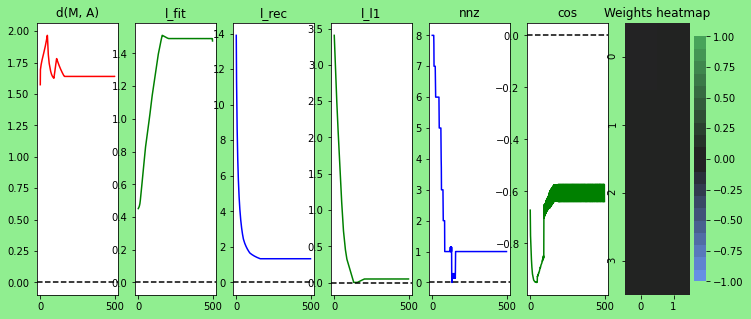

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


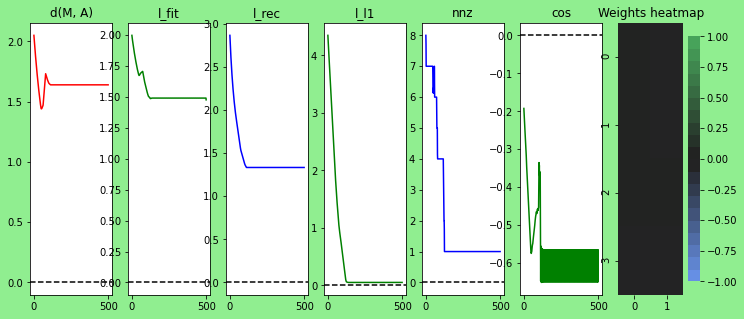

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


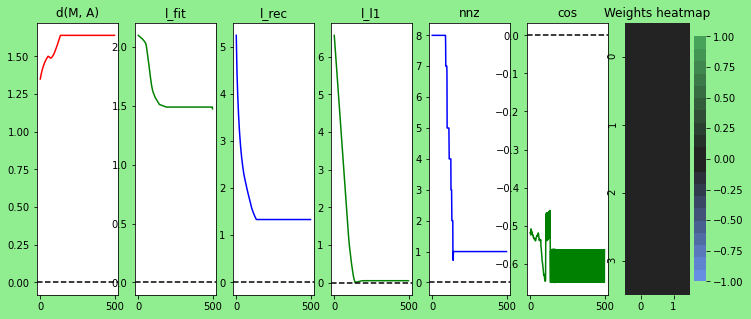

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


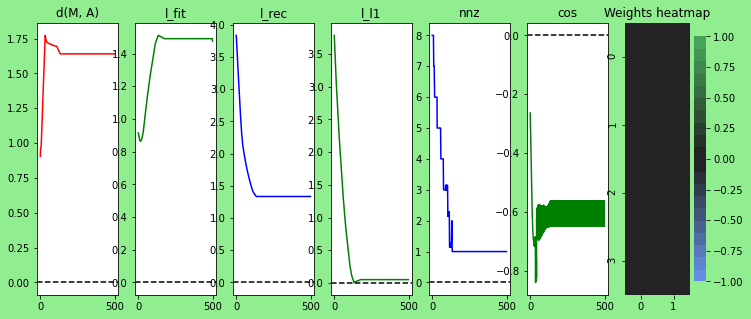

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


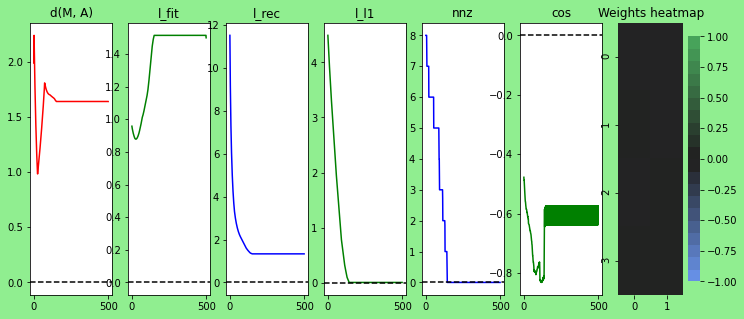

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


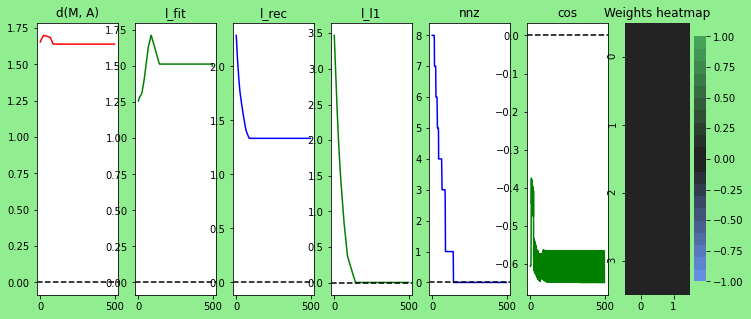

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


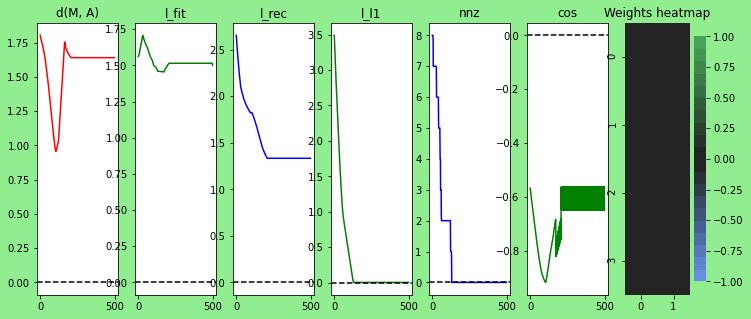

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


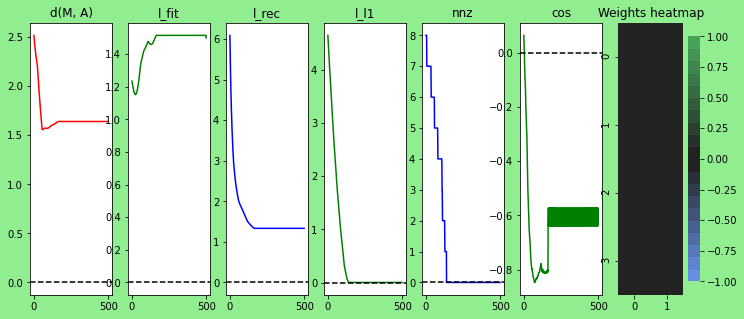

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


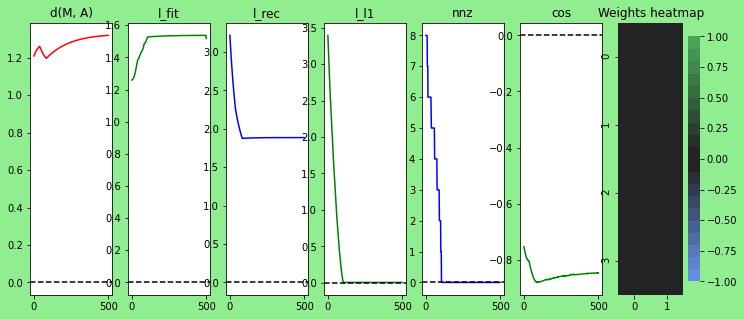

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


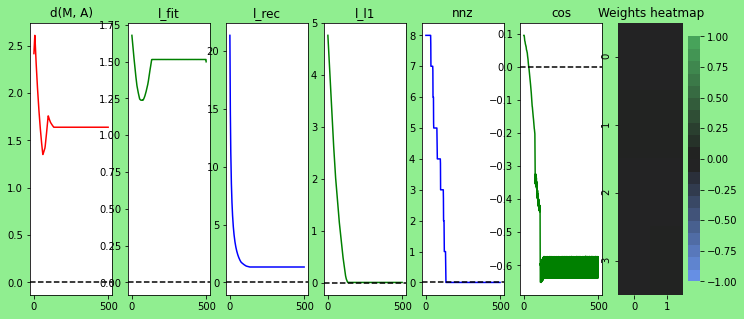

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


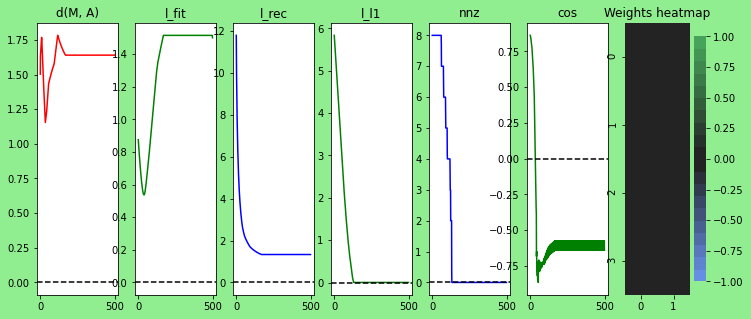

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


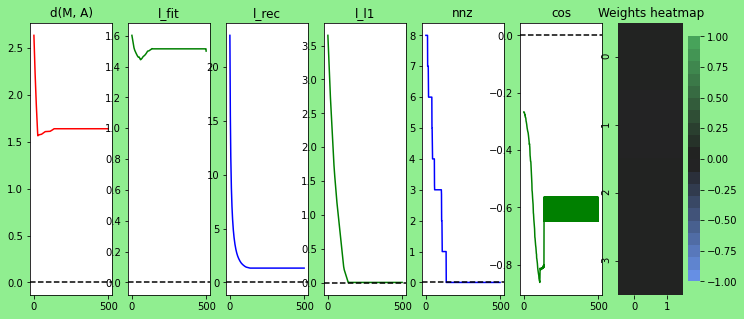

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


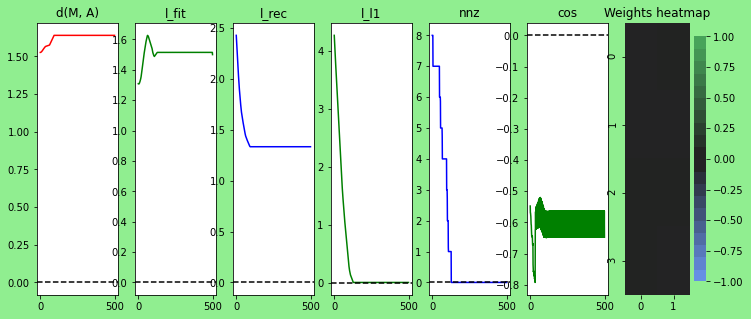

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


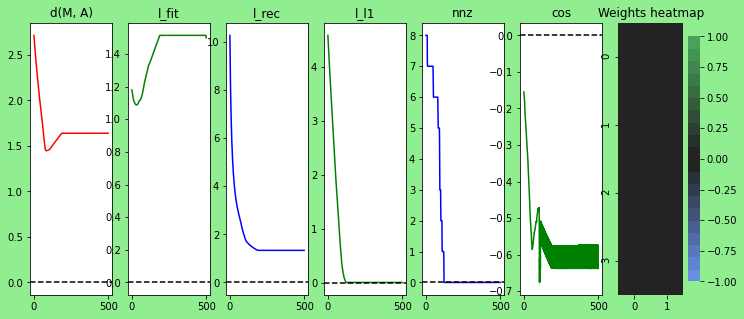

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


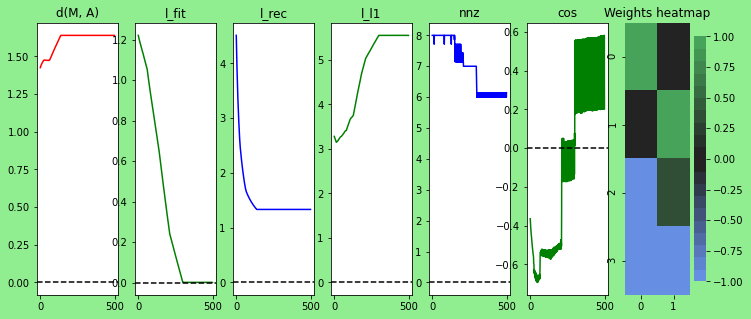

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


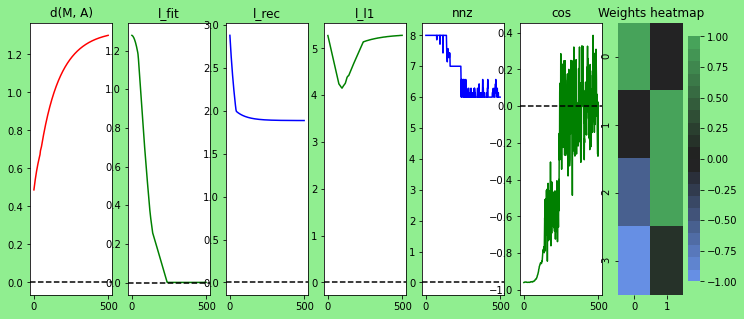

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


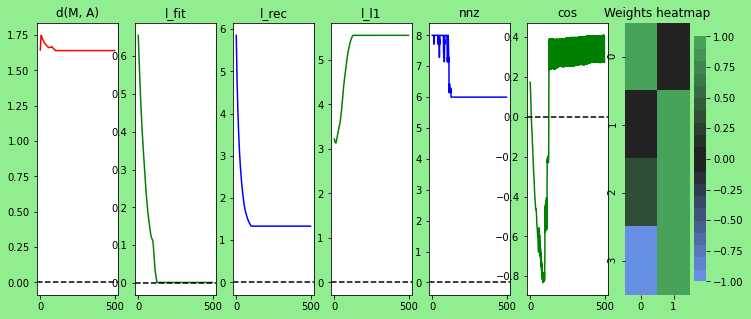

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


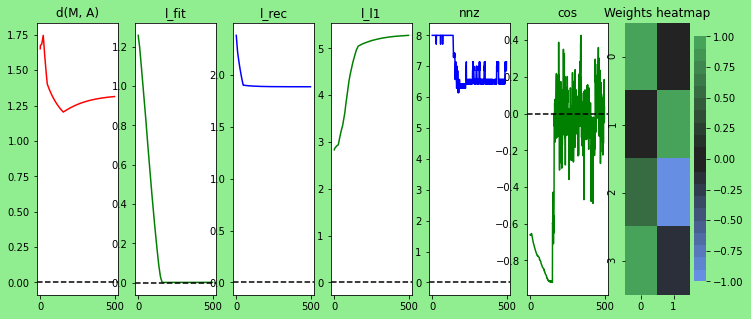

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


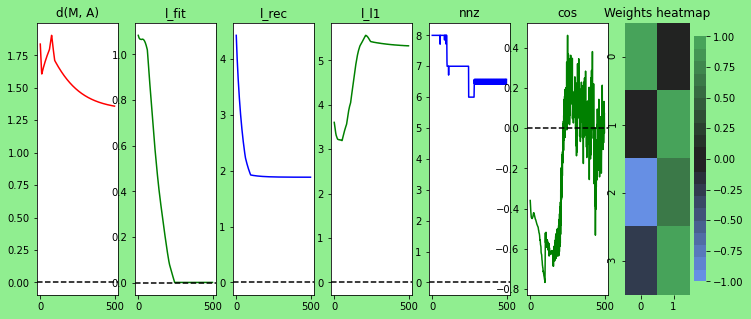

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


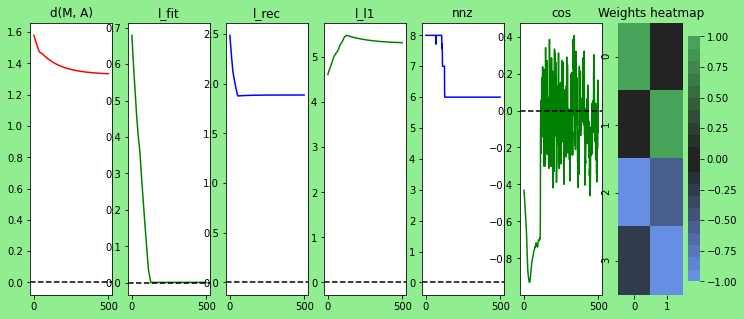

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


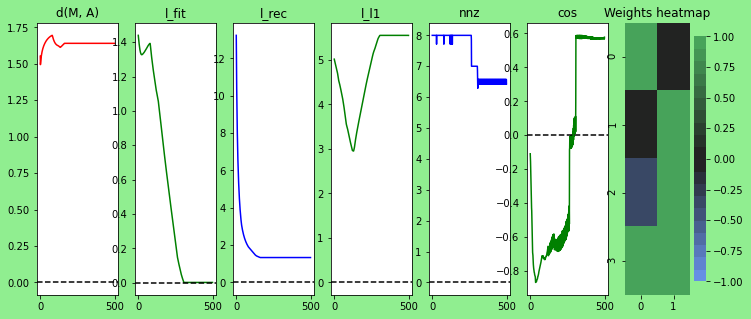

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


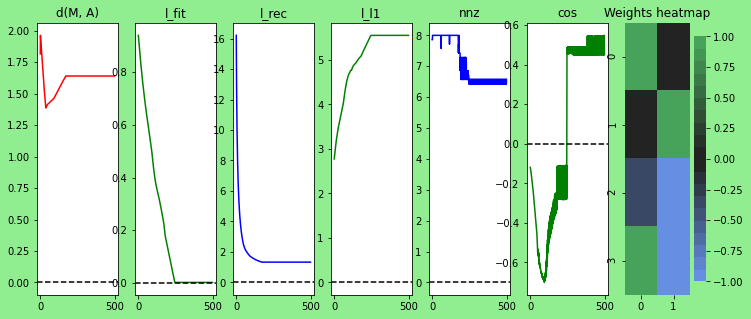

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


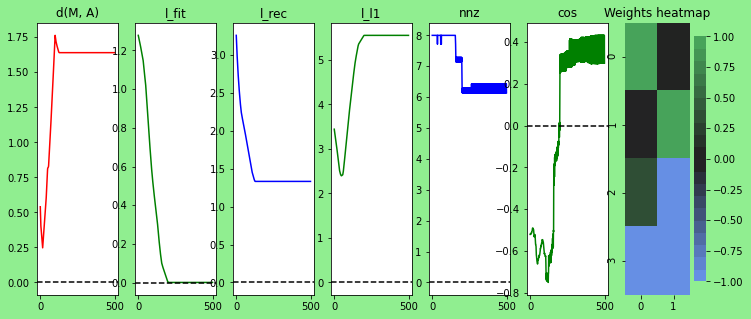

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


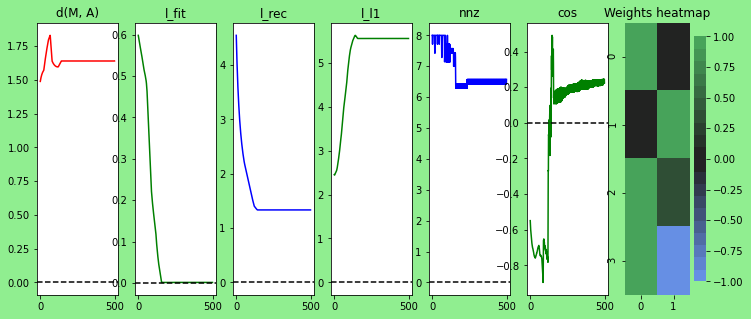

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


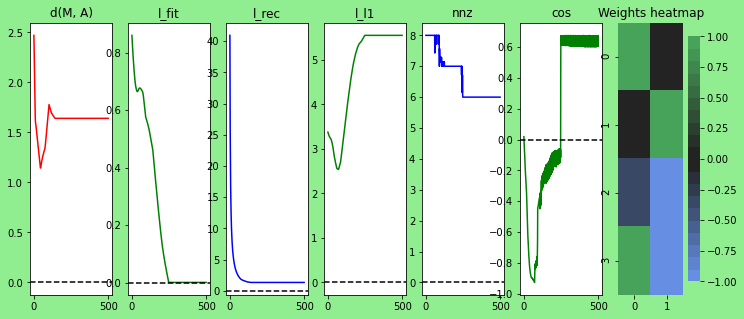

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


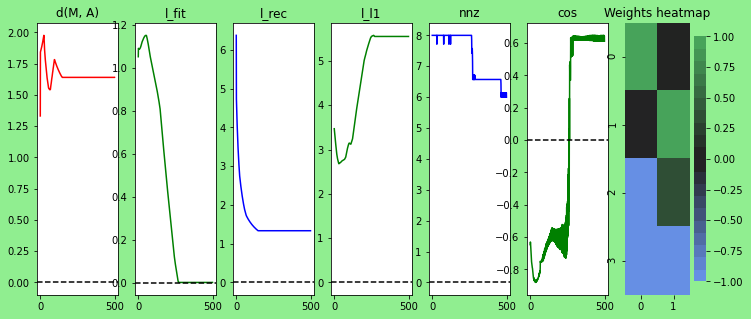

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


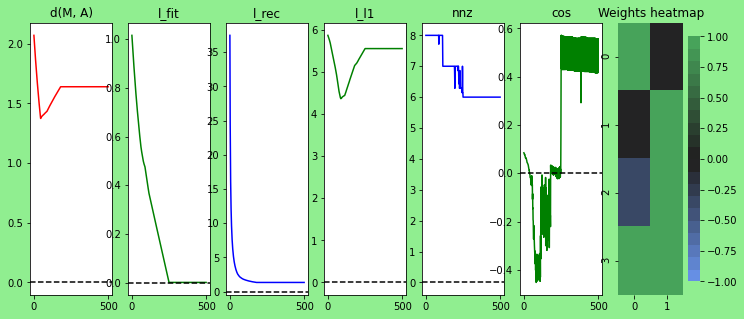

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


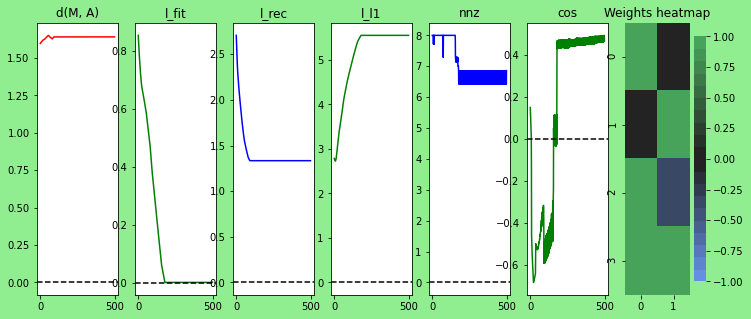

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.00021544346900318823, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


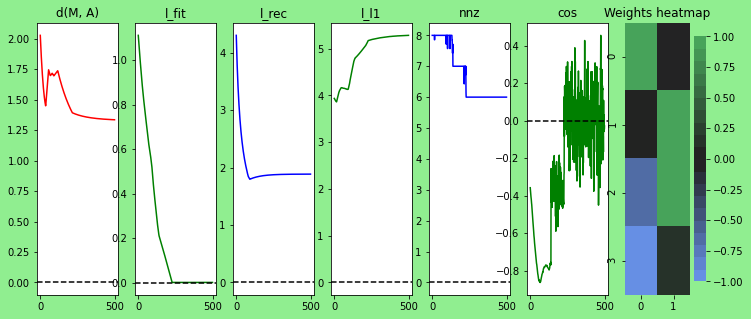

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


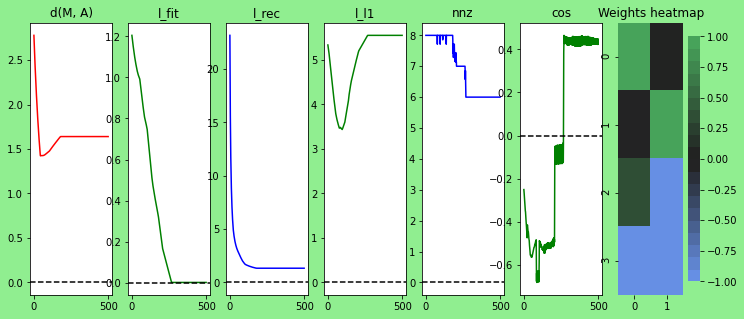

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


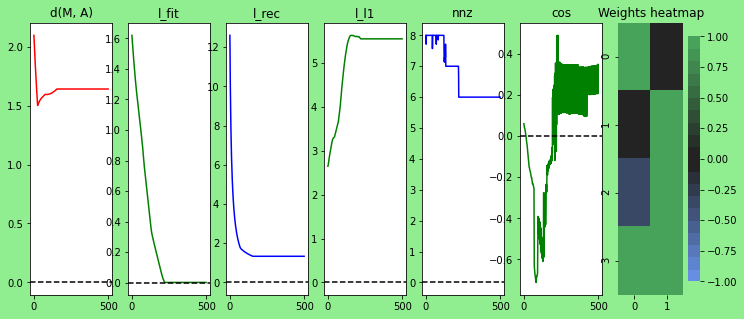

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


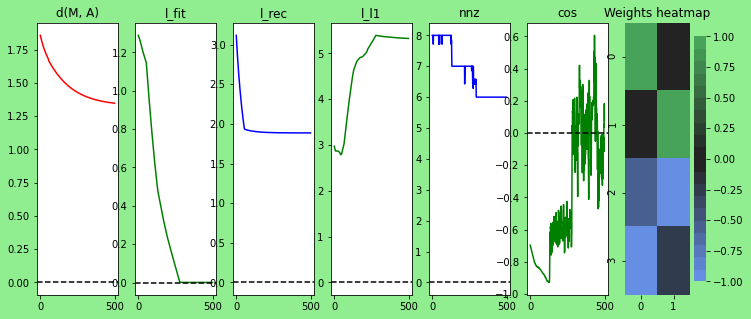

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


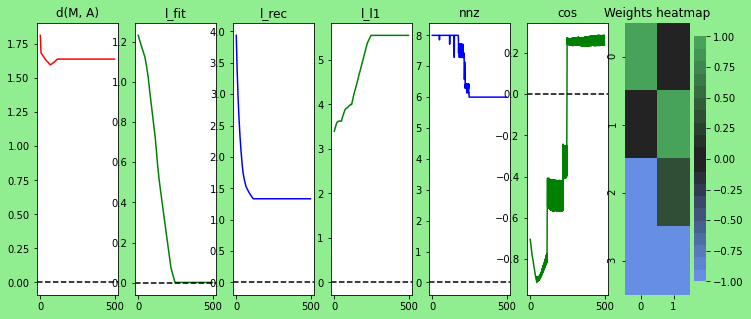

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


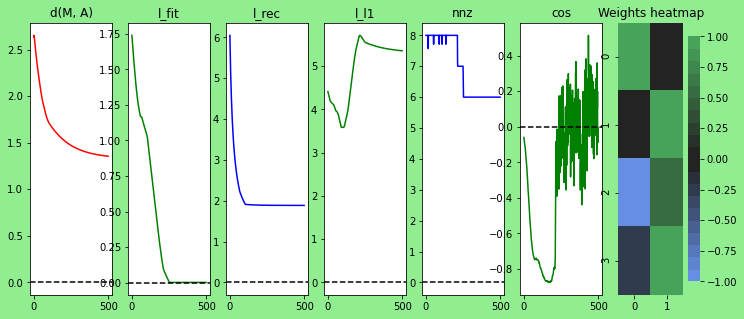

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


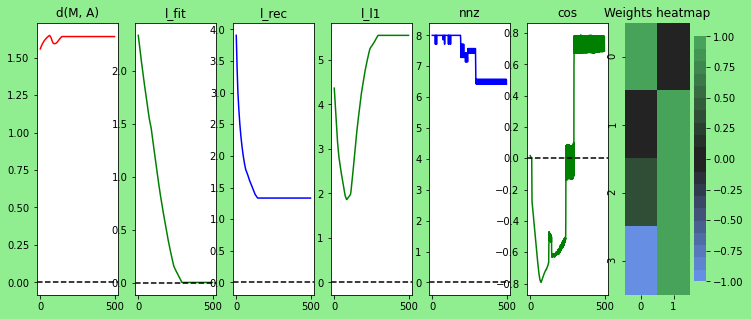

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


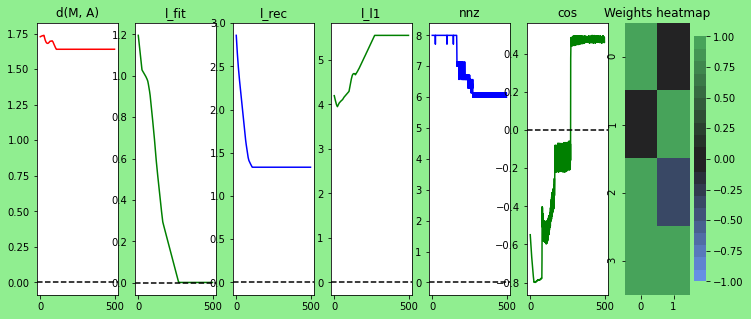

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


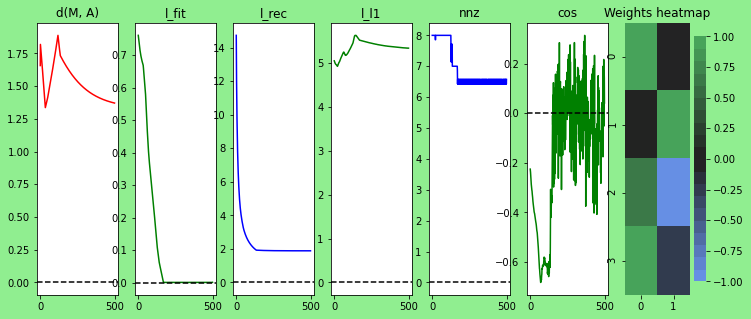

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


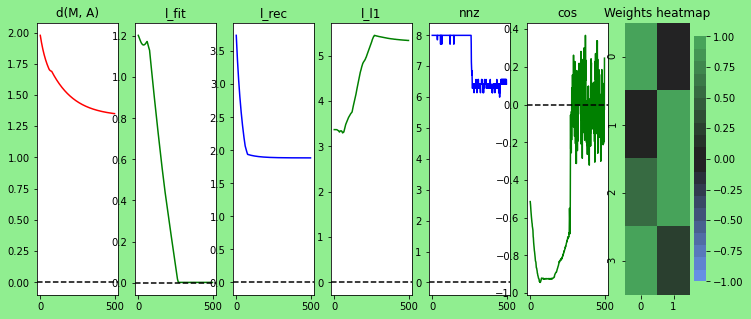

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.004641588833612777, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


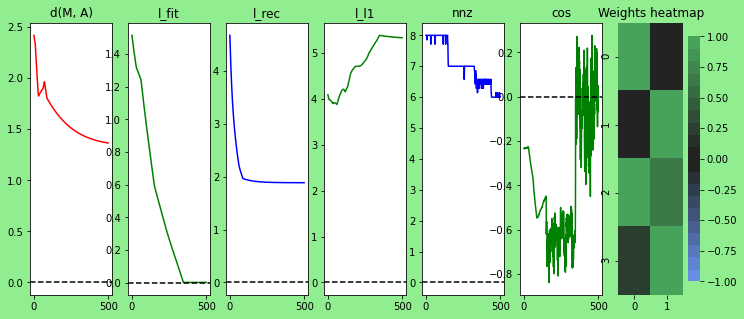

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


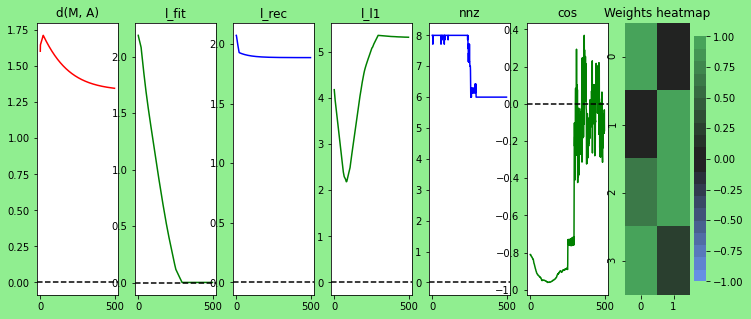

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


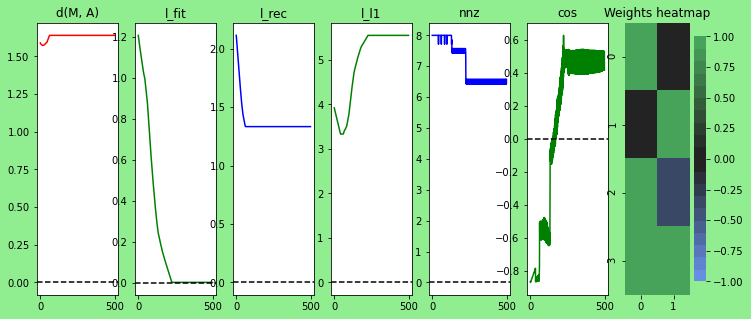

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


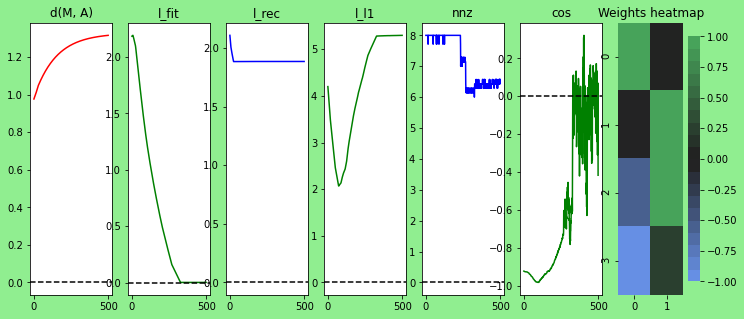

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


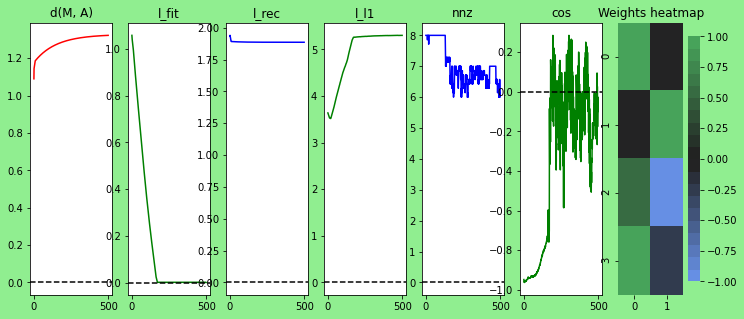

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.021544346900318822, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


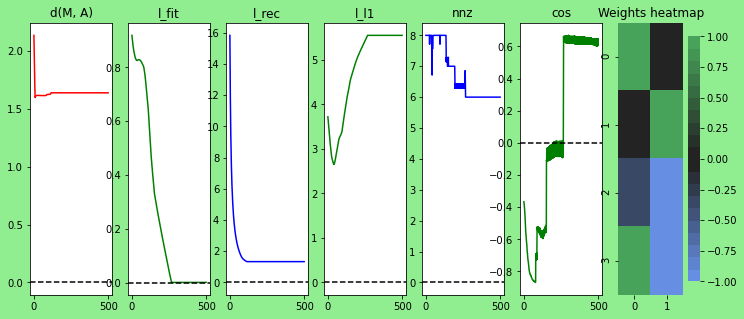

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


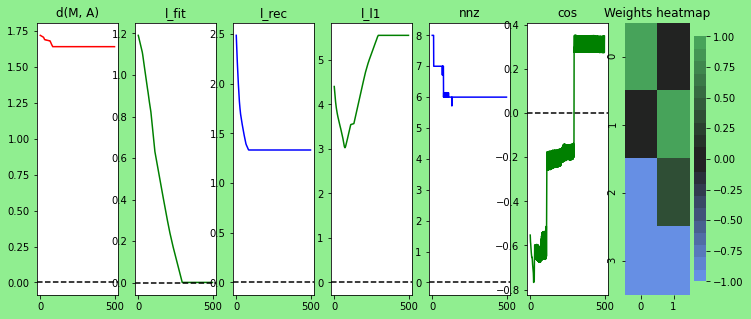

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


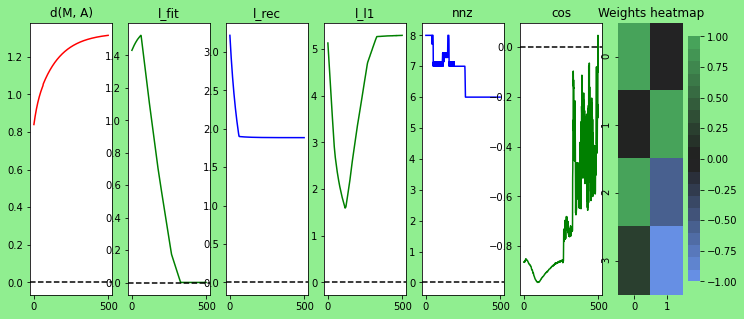

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


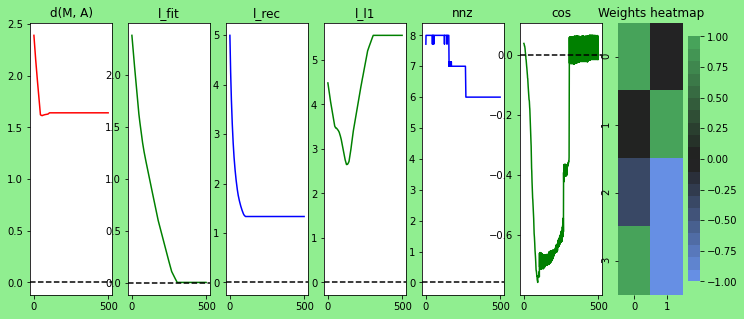

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


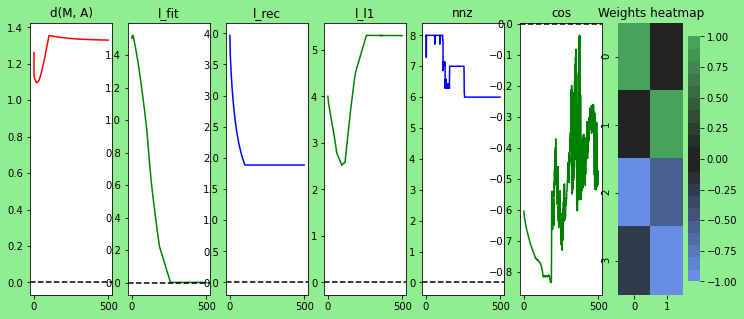

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.1, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


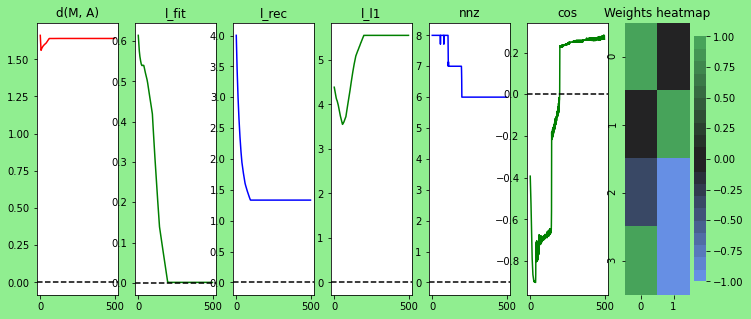

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


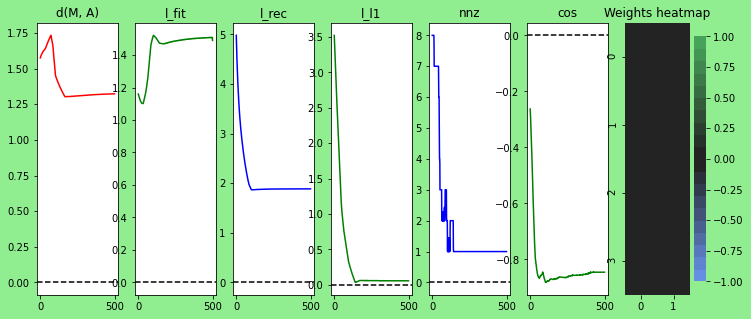

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


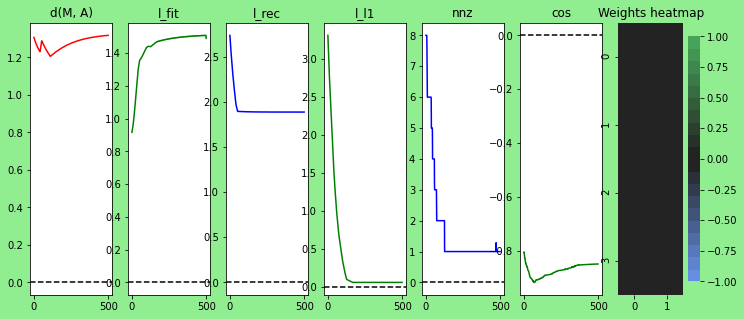

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


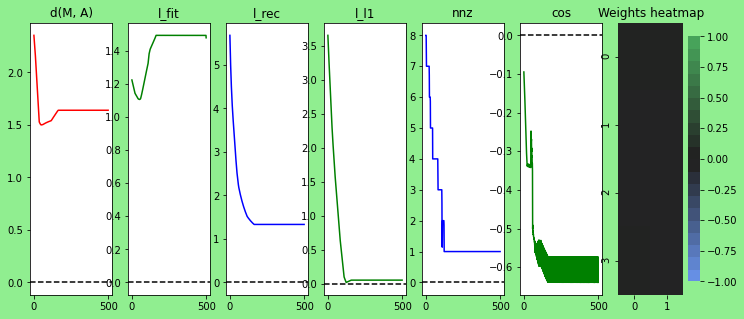

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


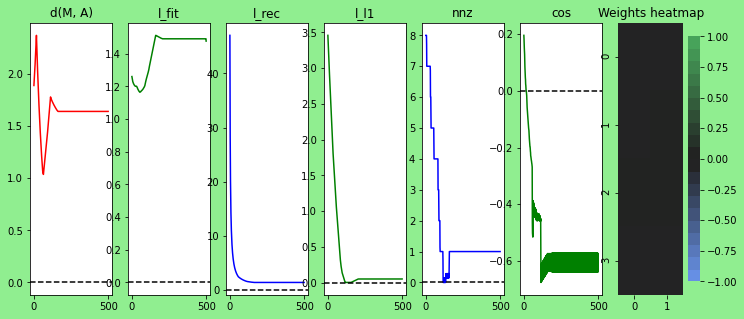

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.46415888336127725, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


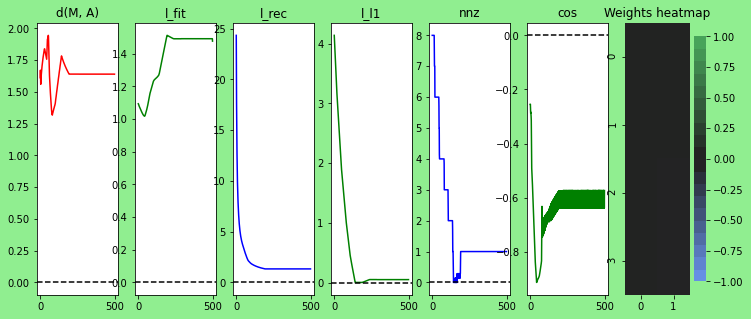

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


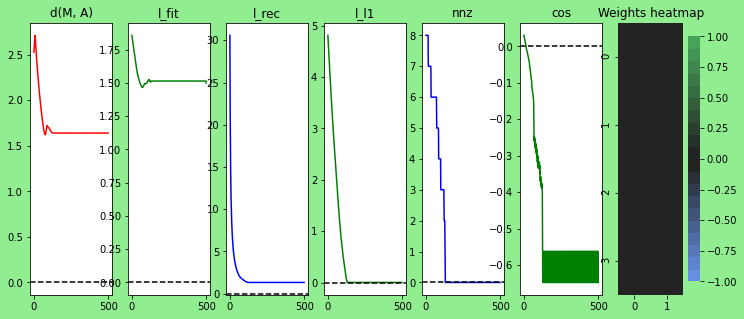

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


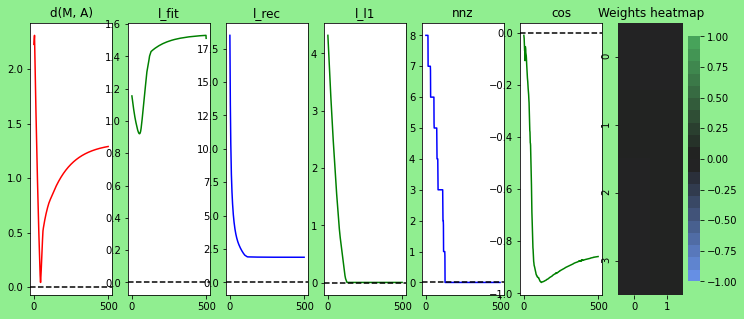

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


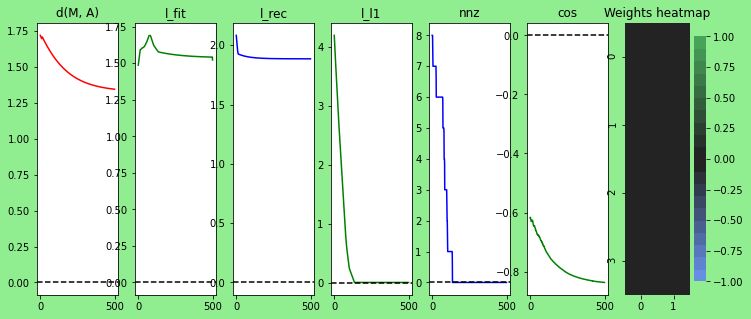

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


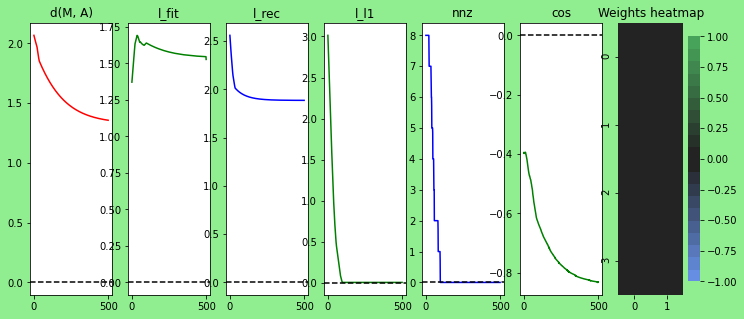

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


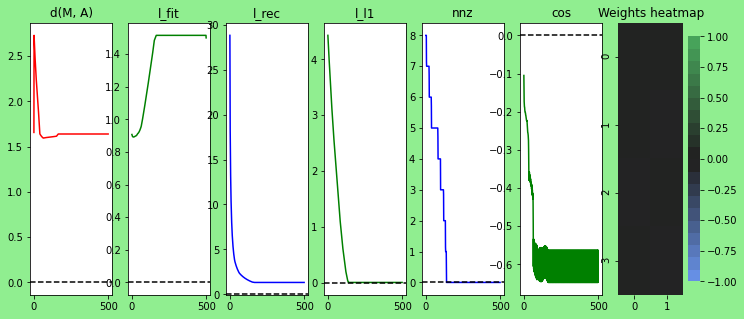

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


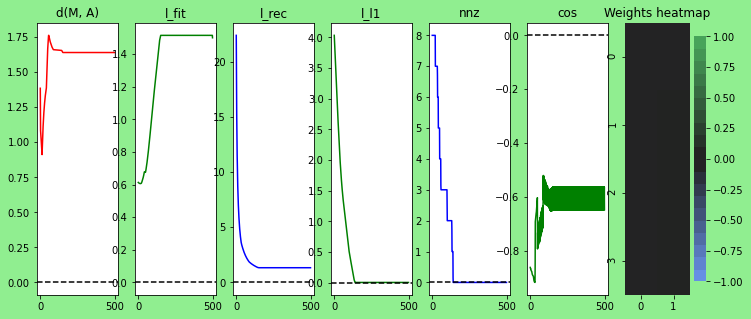

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


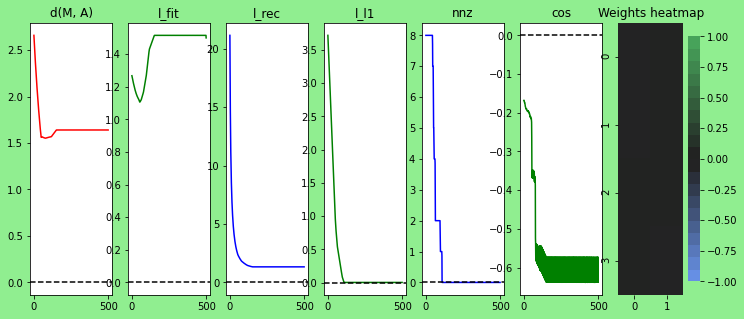

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


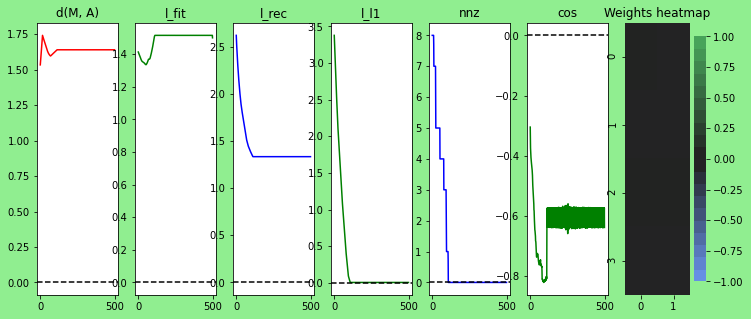

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


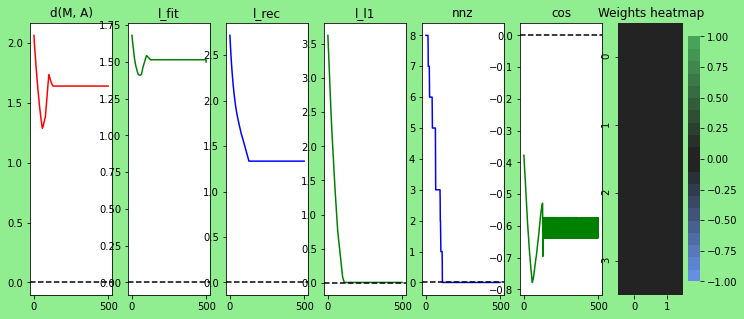

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


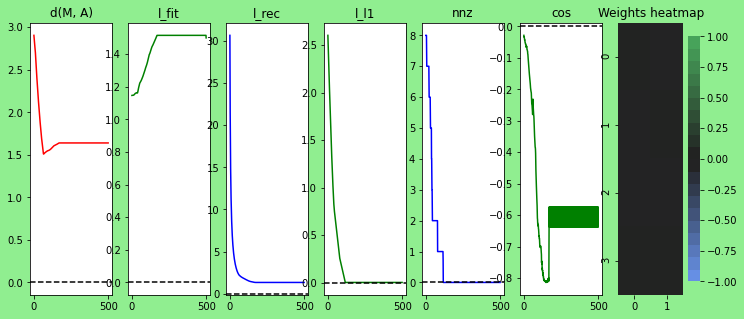

In [62]:
# show all results
for p, r in zip(all_params, results):
    process_results(r, str(p))

14
{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


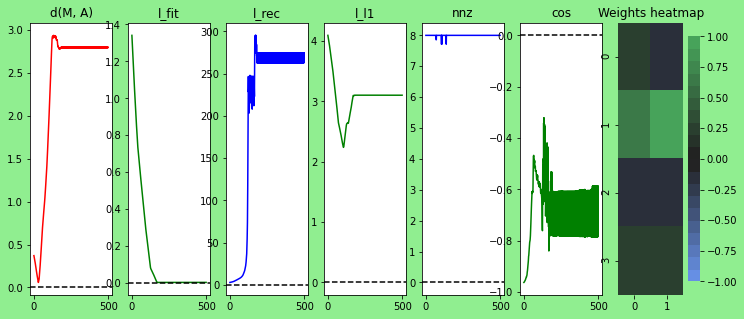

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


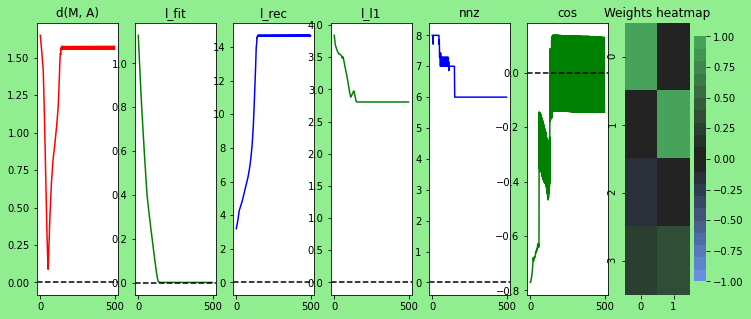

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 1e-05, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


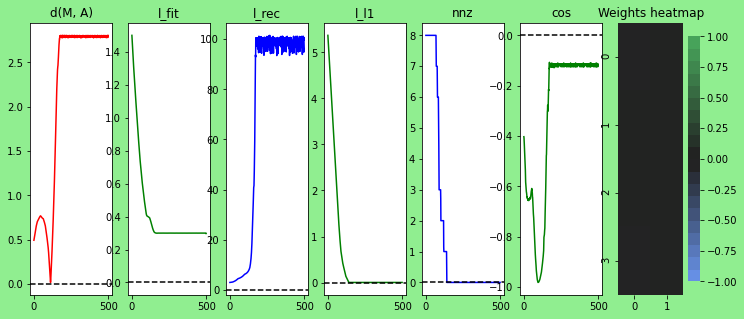

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 3, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


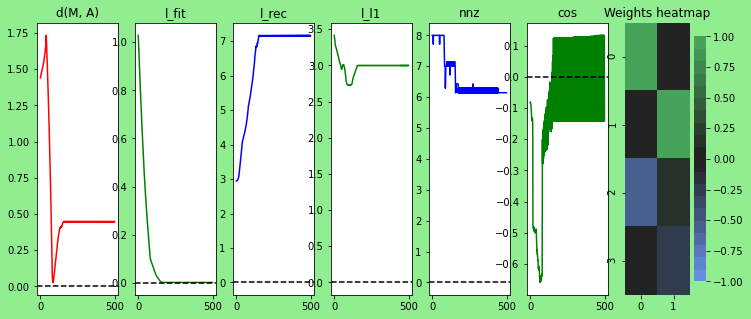

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.00021544346900318823, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


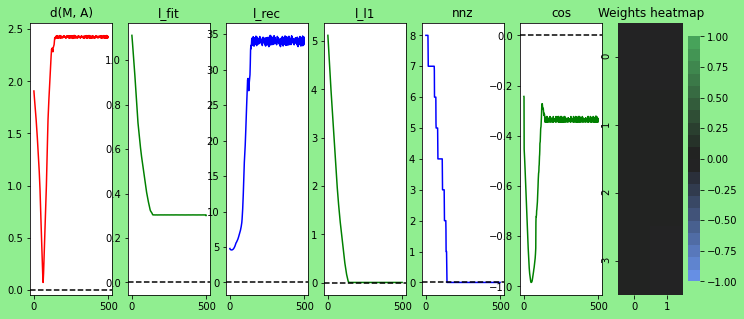

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.004641588833612777, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


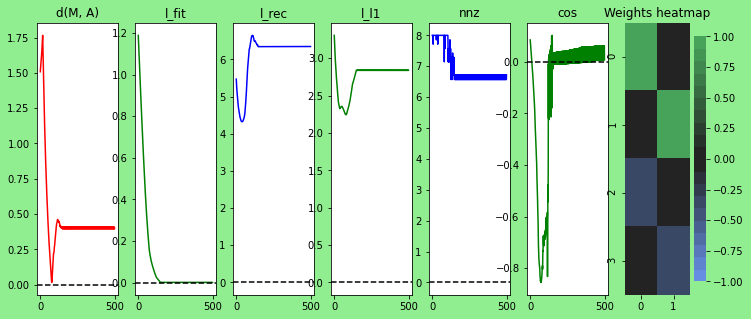

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


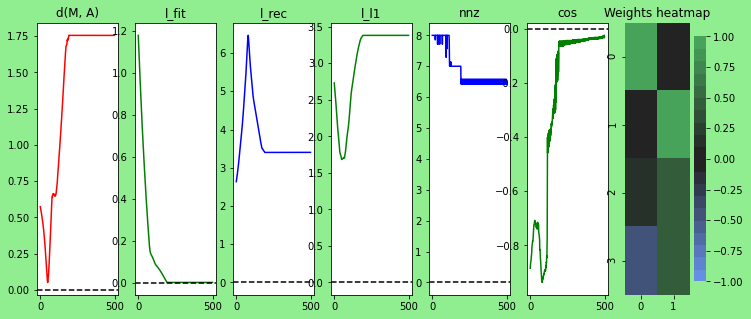

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


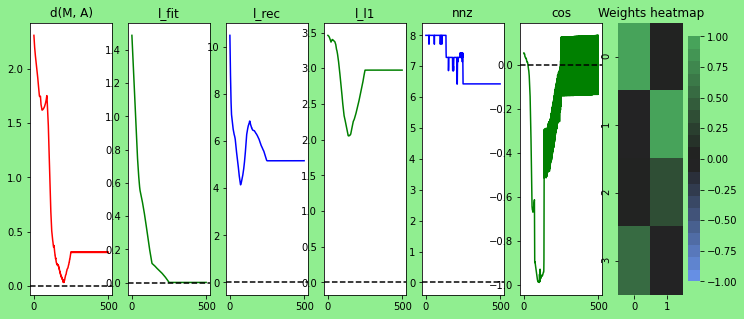

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.021544346900318822, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 0.001, 'repetitions': 0, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


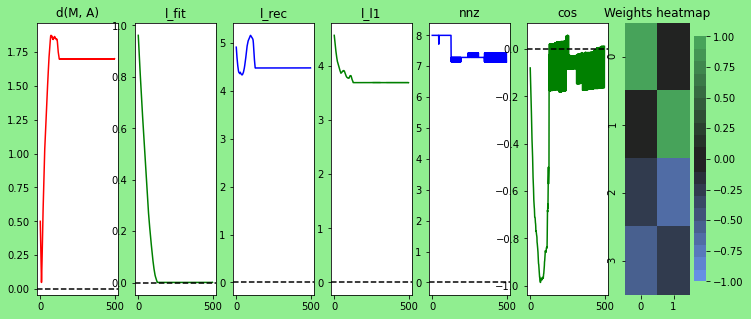

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 4.641588833612782e-05, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


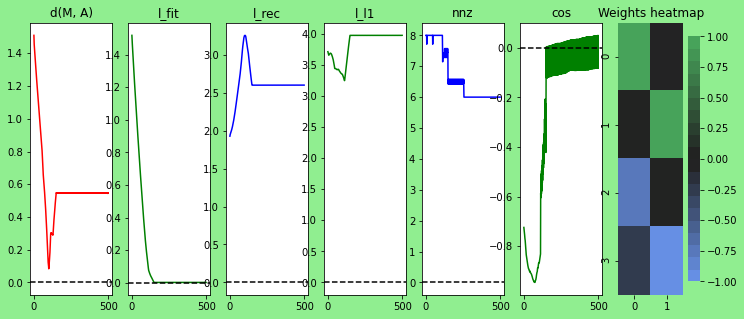

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.1, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 10.0, 'repetitions': 2, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


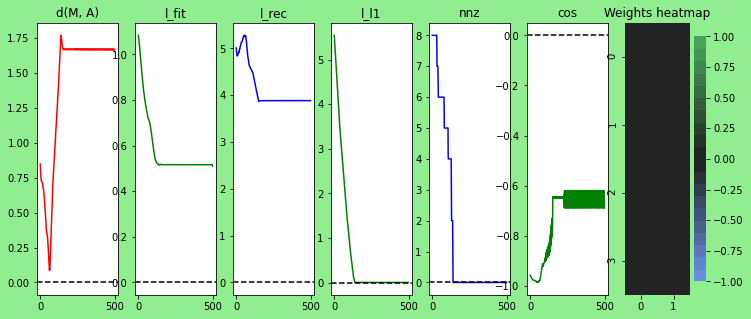

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 0.46415888336127725, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


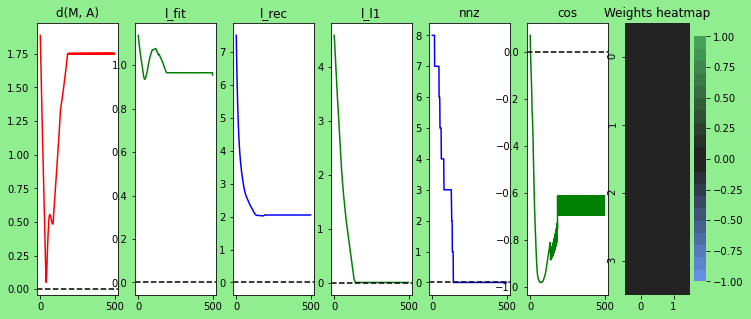

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 2.154434690031882, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 1e-05, 'repetitions': 4, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


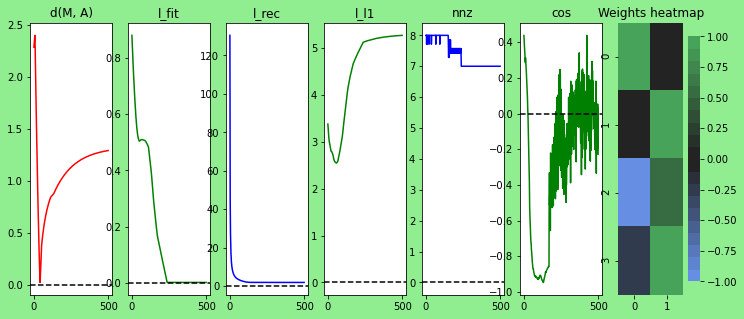

{'compute_mask.components_to_keep': 10, 'projection_step.l1_ball_size': None, 'mask_step.mask': None, 'step_inv_reg.l_Dinv_coeff': 10.0, 'get_results.batch_size': 128, 'step_inv_reg.l1_coeff': 2.154434690031882, 'repetitions': 1, 'name': 'sweep-12', '_meta': {'param_1': 'step_inv_reg.l_Dinv_coeff', 'param_2': 'step_inv_reg.l1_coeff'}, 'get_results.epochs': 500, 'get_results.step': 'step_inv_reg', 'step_inv_reg.optimizer': <tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fbb44b6e3d0>}


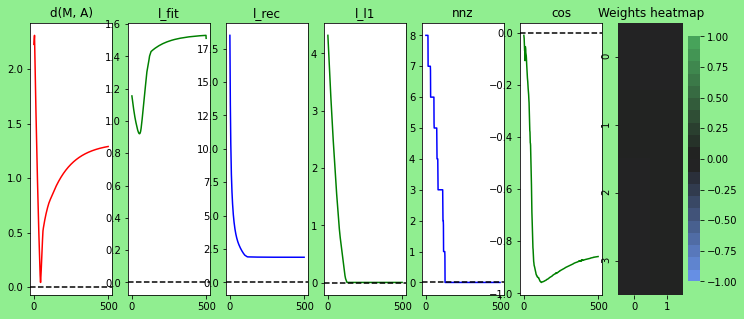

In [63]:
# show GOOD results
thr = 0.1
print(sum([np.min(r[1]) < thr for p, r in zip(all_params, results)]))
for p, r in zip(all_params, results):
    if np.min(r[1]) < thr:
        process_results(r, str(p))

In [64]:
def quality_metric_last_l_fit(res):
    """Scalar quality metric: last fit loss."""
    #print(res)
    return res[1][0]['l_fit'][-1]

quality_metric_last_l_fit.title = "l_fit"

def quality_metric_last_l_rec(res):
    """Scalar quality metric: last rec loss."""
    #print(res)
    return res[1][0]['l_rec'][-1]

quality_metric_last_l_rec.title = "l_rec"

def quality_metric_last_nnz(res):
    """Scalar quality metric: last rec loss."""
    #print(res)
    return res[1][0]['nnz'][-1]

quality_metric_last_nnz.title = "nnz"

def quality_metric_last_l_l1(res):
    """Scalar quality metric: last rec loss."""
    #print(res)
    return res[1][0]['l_l1'][-1]

quality_metric_last_l_l1.title = "l_l1"

def quality_metric_last_de(res):
    """Scalar quality metric: last rec loss."""
    #print(res)
    return res[1][1][-1]

quality_metric_last_de.title = "de"

def quality_metric_combined(res):
    """Combined metric."""
    return max(quality_metric_last_l_fit(res), quality_metric_last_l_rec(res))
quality_metric_combined.title = "combined"

In [65]:
def plot_3d(metric):
    """Plot a metric in 3d."""
    # preparing data for the 3d plot
    X, Y, Z = [], [], []
    Xm, Ym, Zm = [], [], []
    Pm = []

    for p1 in sweep[param_1]:
        for p2 in sweep[param_2]:
            R = filter_results(**{param_1: p1, param_2: p2})
            for r in R:
                X.append(p1)
                Y.append(p2)
                Z.append(metric(r))
            Xm.append(p1)
            Ym.append(p2)
            Zm.append(np.median([metric(r) for r in R]))
            Pm.append((p1, p2))

    # Doing 3d plot

    # Configure the trace.
    trace1 = go.Mesh3d(x=Xm, y=Ym, z=Zm, opacity=0.5)

    # Configure the trace.
    trace2 = go.Scatter3d(x=X, y=Y, z=Z, opacity=0.5, mode='markers',
        marker={'size': 10, 'opacity': 0.8}
    )

    # Configure the layout.
    layout = go.Layout(
        margin={'l': 0, 'r': 0, 'b': 0, 't': 0}
    )

    data = [trace1, trace2]

    plot_figure = go.Figure(data=data, layout=layout)

    plot_figure.update_layout(scene = dict(xaxis_title=param_1,
                        yaxis_title=param_2,
                        zaxis_title=metric.title,
                        #xaxis_type="log",
                        #yaxis_type="log"
                                          ),
                        width=700,
                        margin=dict(r=20, b=10, l=10, t=10))


    # Render the plot.
    plotly.offline.iplot(plot_figure)
    
    return Zm, Pm

In [66]:
# l1rec now working??? well, yeah I use a custom training procedure...
Zm, Pm = plot_3d(quality_metric_combined)

In [67]:
# l1rec now working??? well, yeah I use a custom training procedure...
Zm, Pm = plot_3d(quality_metric_last_l_l1)

In [68]:
# l1rec now working??? well, yeah I use a custom training procedure...
Zm, Pm = plot_3d(quality_metric_last_nnz)

In [69]:
# l1rec now working??? well, yeah I use a custom training procedure...
Zm, Pm = plot_3d(quality_metric_last_de)

In [70]:
idx = np.argmin(Zm)
P = Pm[idx]
print("%s=%.2f, %s=%.2f metric=%.2f" % (param_1, P[0], param_2, P[1], Zm[idx]))

step_inv_reg.l_Dinv_coeff=0.00, step_inv_reg.l1_coeff=0.10 metric=0.40


In [71]:
# best parameters
best_param_idx = all_params.index(filter_results(**{param_1: P[0], param_2: P[1]})[0][0])
best_param = all_params[best_param_idx]

# RESULTS

`sweep_00`: best hyperparams l_rec_coeff=1, batch_size=256
`sweep_01`: works OK if bs <= 200 and l_re >= 1

# Manual computation

In [17]:
import tensorflow as tf
tf.compat.v1.enable_v2_behavior()
import synthetic_experiment

1000/1000 [==============================] - 0s 39us/sample - loss: 0.0050
0.004973148234188557
[<tf.Variable 'sequential/dense/kernel:0' shape=(4, 2) dtype=float32, numpy=
array([[ 1.0002079e+00, -5.0665881e-04],
       [-9.5121322e-05,  9.6523833e-01],
       [ 9.9603897e-01, -1.6652088e-03],
       [-2.1618378e-05,  9.0627044e-01]], dtype=float32)>, <tf.Variable 'sequential/dense/bias:0' shape=(2,) dtype=float32, numpy=array([6.5898887e-05, 2.2597248e-03], dtype=float32)>]
0.13494875787182536


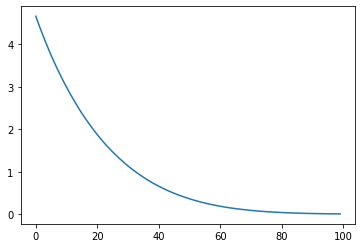

In [18]:
synthetic_experiment.fit_test_model(xs, ys, A)

In [19]:
# best_param = all_params[0]
set_params(best_param, synthetic_experiment)
set_params({'step.l_rec_coeff': 1}, synthetic_experiment)
best_param

{'compute_mask.components_to_keep': 4,
 'projection_step.l1_ball_size': 0.5,
 'mask_step.mask': None,
 'step.l_rec_coeff': 10.0,
 'get_results.batch_size': 64,
 'repetitions': 0,
 'name': 'sweep-04',
 '_meta': {'param_1': 'step.l_rec_coeff',
  'param_2': 'projection_step.l1_ball_size'}}

In [20]:
# getting results manually
res = synthetic_experiment.get_results(xs_e, ys_e, Q1)

best


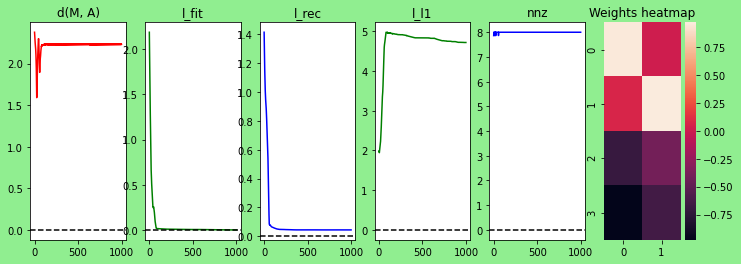

In [21]:
process_results(res, "best")

In [47]:
pickle.dump(results, open('results_%s.pkl' % sweep['name'][0], 'wb'))

In [14]:
# Ideas:
# 1. try all 2^8 options as a mask . Is decoder unique for a model? yes -- inverse of encoder
#    -- tried all of them (param 5, 6)
# param 05 -- even explicit mask does not always work...
# param 06 more iterations -- same thing. trying 10.
# 2. (for the future) try |x_{4th element}| -> min -- automatic l0 sparsity if number of comp is known (head+tail)
# 3. evolution/discrete optimization
# 4. prior on weights of M -- two peaks in a histogram
# 5. batch size?
# 6. (for the future) annealing method -- multiple steps ("day/night cycle") -- decrease/increase constraint with mask [1, eps], eps->0
#    "PID"(combined) -> annealing temperature eps; l1 ball radius
#    "PID"=moving average of last steps of the loss. high loss -> eventually temperature increases
#     loss is low -> increase temperature
#     stopping criteria: crisp abstracttions (develop sparseness metric -- low loss & eps=0)
# IMPLEMENTING in a separate nb
# 7. try increasing dimensionality of observations?..
 
# 8. what props are invariant for |XA_sX^{-1}?| + |BA| -- second part is dictionary stuff for 2 actions (vectors) exactly, so
# overall problem is more complex.

# 9. solve in mathematica with a constrant (like sigmoid softmax coding for rows/columns -- 2 params) => nnz approx plot
# 10. 2 supervised losses --> convexity!!! R(M(D(x))) = y, R(D(x)) = x, optimize in steps...
# check if M(D(x)) = D(y) is convex as a loss
# need correct "child-parent" dynamics and not a "criminal-police"
#  => custom strength (only when necessary!)


# 2 optimizers with lr=lr=1e-3 work better than 1 optimizer
# in case if there is a mask!

# always set R=D^+
# AND regularize for |D^{1}|
# differentiable approximation for the inverse matrix
# then can get rid of the reconstructor

# give more iterations to R(D(X))=x so that R=D^-1 alwas
# then we have less parameters

# Try #7 -- for NNs it worked

# Try to see scalar product between loss gradients

# in general RL

#### Talk 22nd of May
To try:

0. Look at the scalar product between gradient losses for the decoder. Either $-1$ or we have only reconstructor failing. Good predictor of a saddle point
1. Higher dimension of obs $|f|=2$, $|f|+|a|=4$, $|o|=2$, want $|o|>>1$, try $10, 100, 1000?$ (#7). Measure number of times we converge to a good representation
2. Setting $R=D^+$ and replacing reconstruction loss with non-degeneracy of $D^+$ -- if needed. freeze 
3. Try different $p\in(0,1)$ parameters for the norm for more sparsity http://www.ifp.illinois.edu/~mdgupta/paper/pnormICCV2013.pdf https://medium.com/mlreview/l1-norm-regularization-and-sparsity-explained-for-dummies-5b0e4be3938a

Mathy:
1. check if M(D(x)) = D(y) is convex as a loss in weights of D. Loss is convex in D, M, but not together...
2. plot the loss landscape in mathematica R=D^-1, M, D, keep 1 from M, keep 1 from D, OR keep 2 from M/D + valleys if 2 at once


Side project: PID for strength of optimizers PoC (very small)

**May 27th**

Regularizing with $|D^{-1}|$ instead of $RD$ leads to poor sparsity. Was it good with $RD$ (`step_2opt`, param_13)?

Next steps:
1. Report
2. Plug the code into RL
3. Try higher dimensions with data